# import & load data

In [1]:
%run imports_N_loadDenoised.ipynb

/c/Users/junec/AppData/Local/Programs/Python/Python38/python
load & denoise real field data===========================
---load data from 'txt' or 'xlsx' files...
check the time type
---denoising data using S-G smoothing...
---The first & second order derivative has been calculated and appended to pressure dataframe
len(ground_truth_denoised) 60
after remove uncorrect ground truth
len(ground_truth_denoised) 54


,Elapsed time(hr),Pressure(psia),first_order_derivative,second_order_derivative
count,29813.000000,29813.000000,29813.000000,29813.000000
mean,1949.504754,5858.252763,30.980488,-3316.399705
std,1071.285888,1201.608375,217.076860,26067.263416
min,0.000000,2989.186167,-1177.363679,-267661.267543
25%,1223.614626,4920.227064,-26.315082,-150.940811
50%,2055.749995,5958.685278,6.577672,0.048895
75%,2691.845828,6884.300893,50.575874,129.782625
max,4070.949737,7942.372157,1442.449150,199644.890976


,Elapsed time(hr),Liquid rate(STB/D)
count,10191.000000,10191.000000
mean,2210.383315,-16880.702745
std,1121.860526,4591.205914
min,0.433384,-22568.277381
25%,1345.039547,-19746.868884
50%,2248.487512,-18758.998204
75%,3074.228818,-15911.221687
max,4075.570423,1.166046


# rough filter

In [2]:
derivativeMethod=DerivativeMethod(pressure_df,colum_names)
points=derivativeMethod.percentile_FOD(50,10)
print("the length of filtered points:",len(points))

fliter derivatives which are larger than6.577671754538749, smaller than -99.97038962759567
the length of filtered points: 17888


# Detect use Delta Tangent 

In [3]:
time_halfWindow=None
point_halfWindow=10
polynomial_order=1
tangent_type="single_point"
# tangent_type="average"
# deltaTangent_criterion=40
deltaTangent_criterion=20
# points=[index for index in range(len(pressure_measure))]
%run detect_useDeltaTangent.ipynb

start to predict using tangent...
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 2920 buildups and 934 drawdowns 
===============output==================
'buildup_DT: 2920,drawdown_DT: 934'


<Figure size 1440x720 with 0 Axes>

# filter with Max Derivative

In [4]:
points=[buildup_DT,drawdown_DT]
time_step=0.5
%run detect_useMaxFirstDerivative.ipynb

methods\derivative_method.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.pressure_df["abs(first_order_derivative)"]=self.first_order_derivative.abs()


'len(buildUp_df): 2920,len(buildUp_max_FOD): 392'
'len(drawDown_df): 934,len(drawDown_max_FOD): 87'
===============output==================
Max_FOD


# filter first FOD

In [12]:
points=[buildup_DT,drawdown_DT]
time_step=0.5
%run detect_FirstFOD.ipynb

methods\derivative_method.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.pressure_df["abs(first_order_derivative)"]=self.first_order_derivative.abs()


'len(buildUp_df): 2920,len(buildUp_first_FOD): 392'
'len(drawDown_df): 934,len(drawDown_first_FOD): 87'
===============output==================
First_FOD


# plot tangent in point window

-------calculate_Parameters_allCurve using 'polynomial' fitting
=======point_index=========== 1210
tangent[0]:6.73975
tangent[1]:6.73975
tangent[2]:6.73975
tangent[3]:6.73975
tangent[4]:6.73975
tangent[0]:12.19505
tangent[1]:12.19505
tangent[2]:12.19505
tangent[3]:12.19505
tangent[4]:12.19505


<Figure size 1440x720 with 0 Axes>

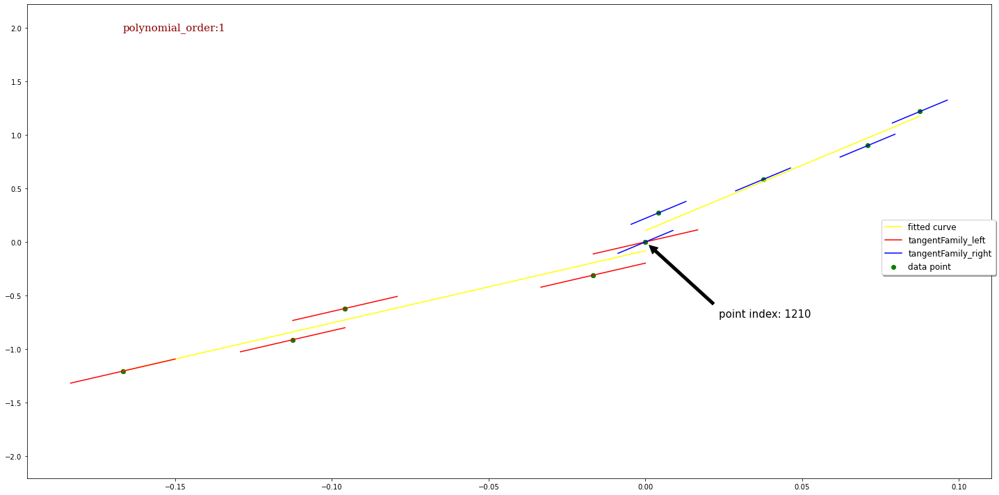

=======point_index=========== 1220
tangent[0]:5.95922
tangent[1]:5.95922
tangent[2]:5.95922
tangent[3]:5.95922
tangent[4]:5.95922
tangent[0]:25.18026
tangent[1]:25.18026
tangent[2]:25.18026
tangent[3]:25.18026
tangent[4]:25.18026


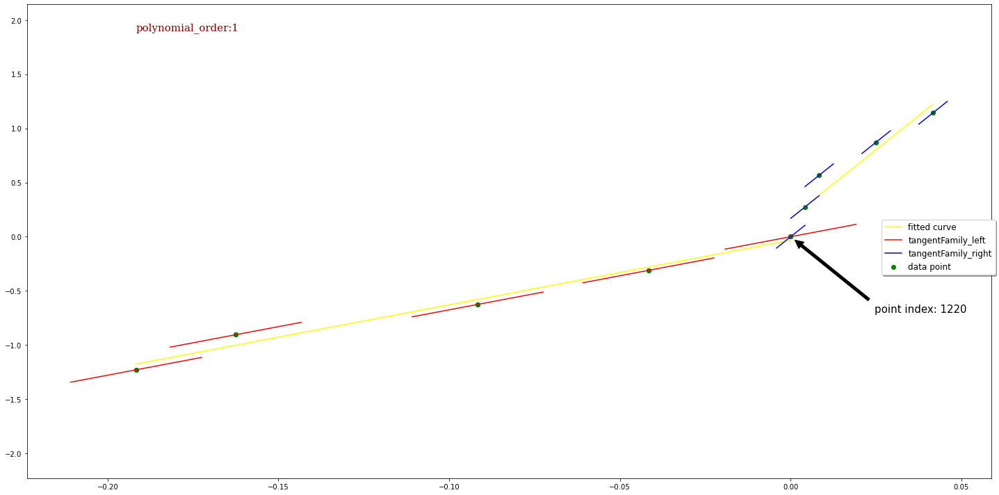

=======point_index=========== 1243
tangent[0]:8.60911
tangent[1]:8.60911
tangent[2]:8.60911
tangent[3]:8.60911
tangent[4]:8.60911
tangent[0]:7.91835
tangent[1]:7.91835
tangent[2]:7.91835
tangent[3]:7.91835
tangent[4]:7.91835


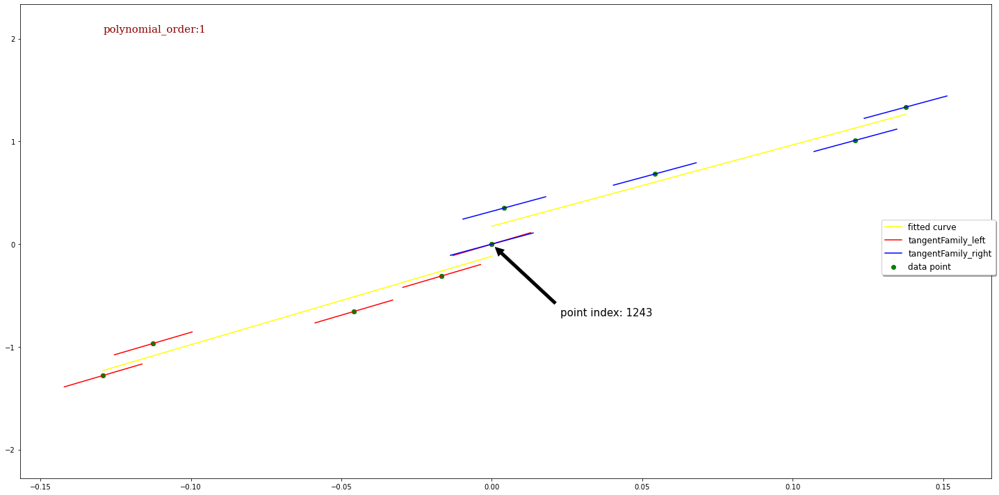

=======point_index=========== 1284
tangent[0]:3.38821
tangent[1]:3.38821
tangent[2]:3.38821
tangent[3]:3.38821
tangent[4]:3.38821
tangent[0]:12.33136
tangent[1]:12.33136
tangent[2]:12.33136
tangent[3]:12.33136
tangent[4]:12.33136


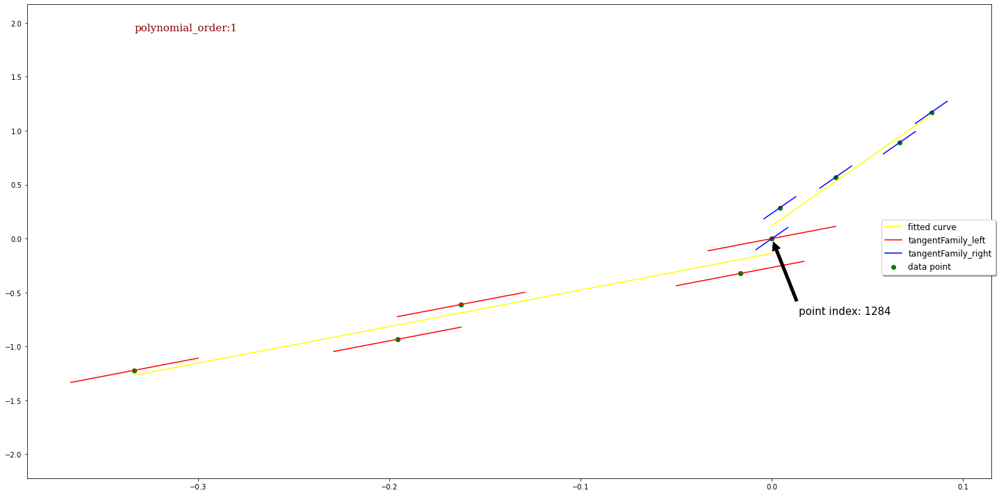

=======point_index=========== 1295
tangent[0]:3.00755
tangent[1]:3.00755
tangent[2]:3.00755
tangent[3]:3.00755
tangent[4]:3.00755
tangent[0]:16.969
tangent[1]:16.969
tangent[2]:16.969
tangent[3]:16.969
tangent[4]:16.969


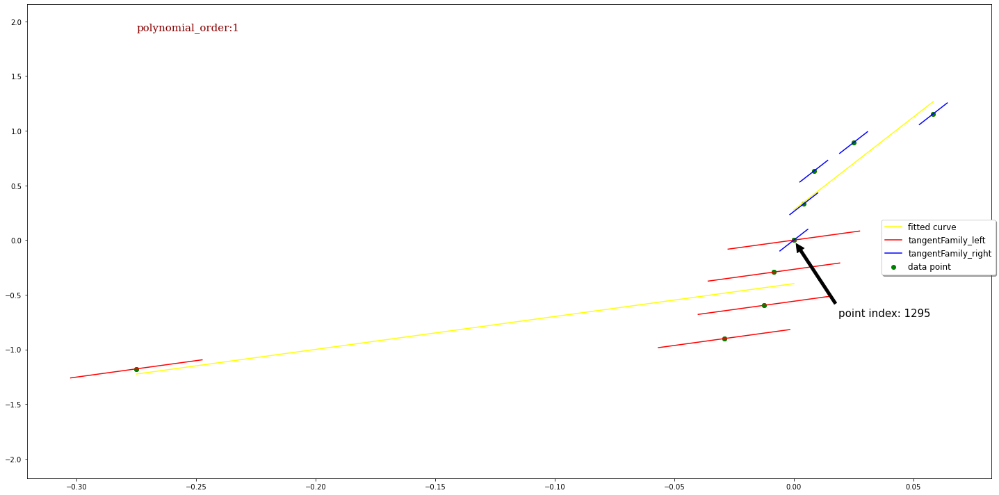

=======point_index=========== 1320
tangent[0]:3.75959
tangent[1]:3.75959
tangent[2]:3.75959
tangent[3]:3.75959
tangent[4]:3.75959
tangent[0]:8.333
tangent[1]:8.333
tangent[2]:8.333
tangent[3]:8.333
tangent[4]:8.333


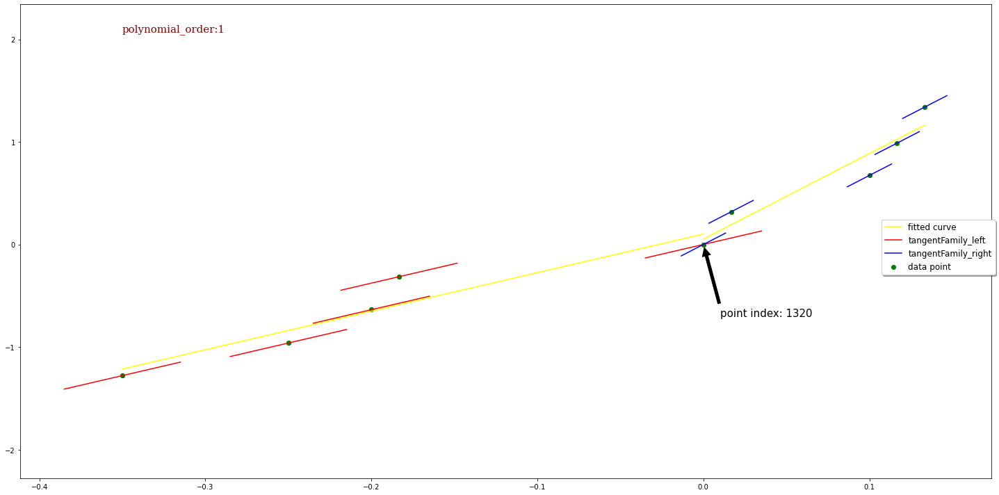

=======point_index=========== 1350
tangent[0]:5.10955
tangent[1]:5.10955
tangent[2]:5.10955
tangent[3]:5.10955
tangent[4]:5.10955
tangent[0]:4.83468
tangent[1]:4.83468
tangent[2]:4.83468
tangent[3]:4.83468
tangent[4]:4.83468


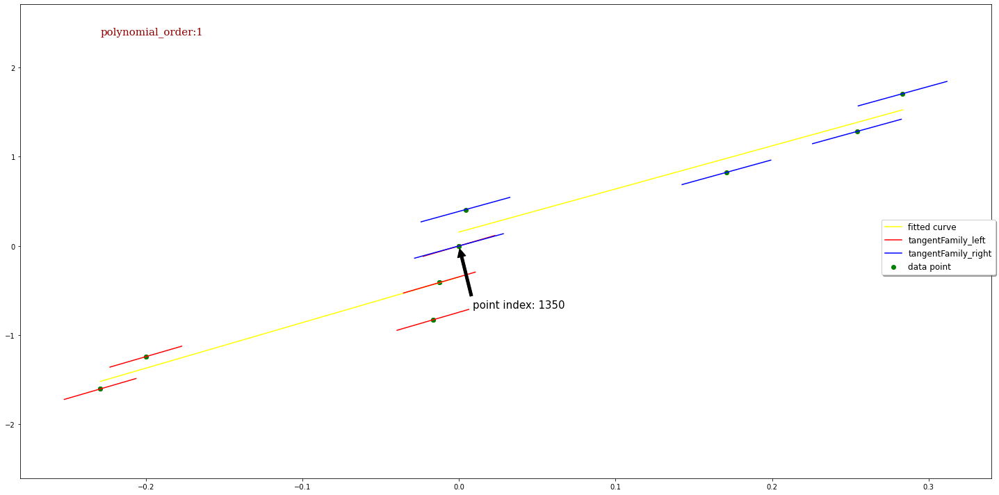

=======point_index=========== 1375
tangent[0]:5.87355
tangent[1]:5.87355
tangent[2]:5.87355
tangent[3]:5.87355
tangent[4]:5.87355
tangent[0]:4.11671
tangent[1]:4.11671
tangent[2]:4.11671
tangent[3]:4.11671
tangent[4]:4.11671


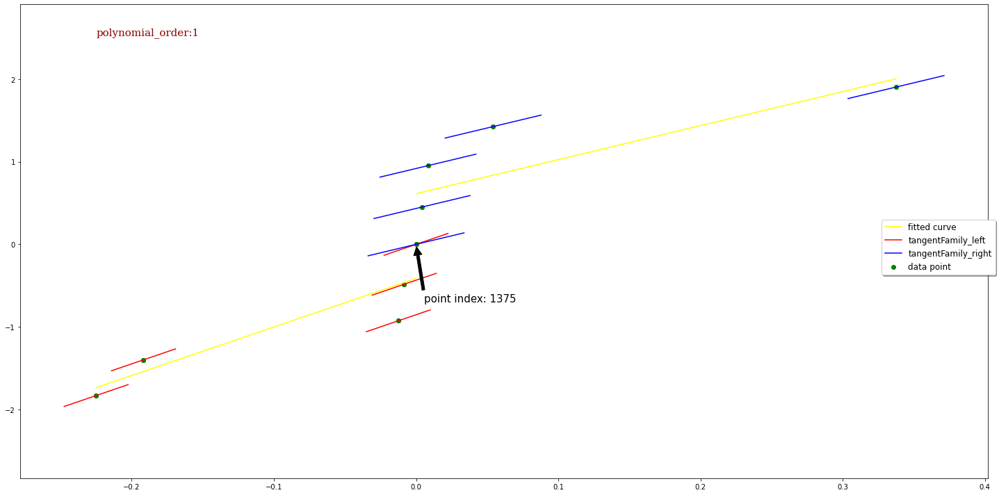

=======point_index=========== 1380
tangent[0]:2.18752
tangent[1]:2.18752
tangent[2]:2.18752
tangent[3]:2.18752
tangent[4]:2.18752
tangent[0]:8.40721
tangent[1]:8.40721
tangent[2]:8.40721
tangent[3]:8.40721
tangent[4]:8.40721


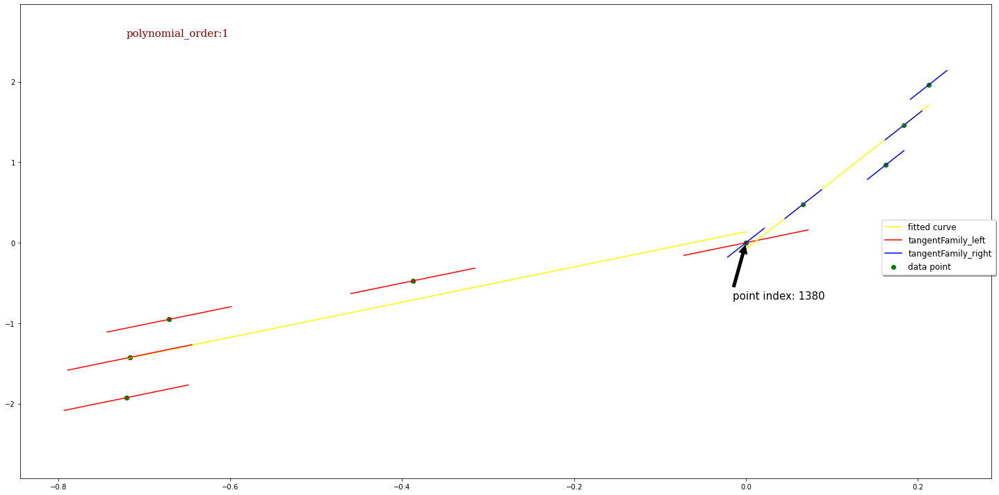

=======point_index=========== 1393
tangent[0]:7.3671
tangent[1]:7.3671
tangent[2]:7.3671
tangent[3]:7.3671
tangent[4]:7.3671
tangent[0]:2.34584
tangent[1]:2.34584
tangent[2]:2.34584
tangent[3]:2.34584
tangent[4]:2.34584


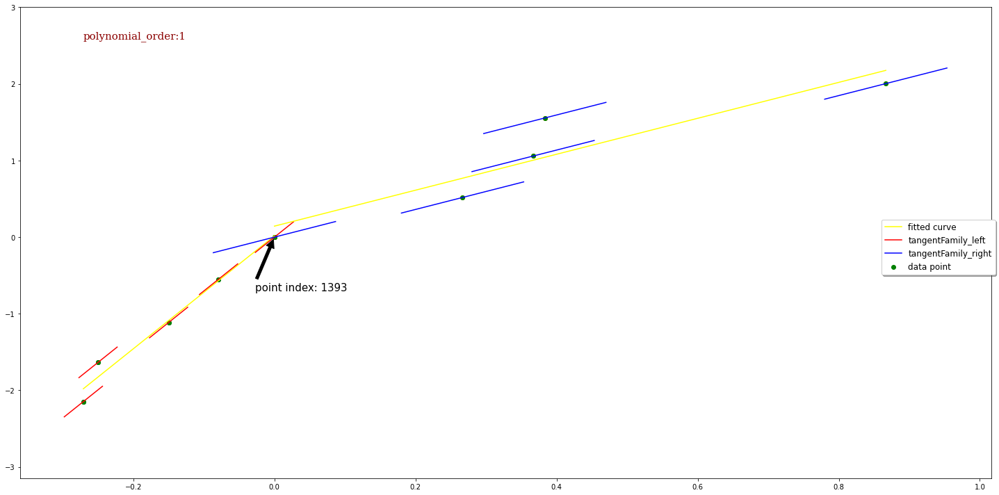

=======point_index=========== 1400
tangent[0]:1.87124
tangent[1]:1.87124
tangent[2]:1.87124
tangent[3]:1.87124
tangent[4]:1.87124
tangent[0]:8.93446
tangent[1]:8.93446
tangent[2]:8.93446
tangent[3]:8.93446
tangent[4]:8.93446


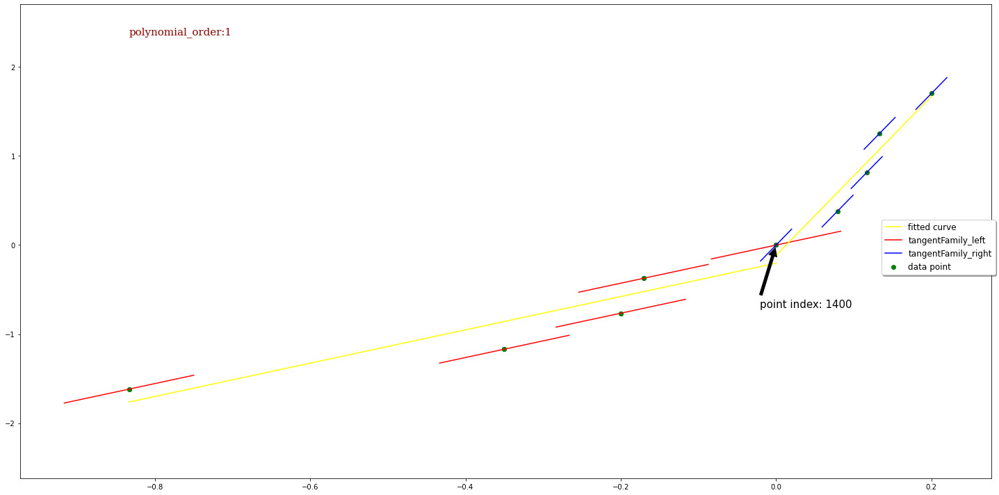

=======point_index=========== 1407
tangent[0]:8.60354
tangent[1]:8.60354
tangent[2]:8.60354
tangent[3]:8.60354
tangent[4]:8.60354
tangent[0]:2.65713
tangent[1]:2.65713
tangent[2]:2.65713
tangent[3]:2.65713
tangent[4]:2.65713


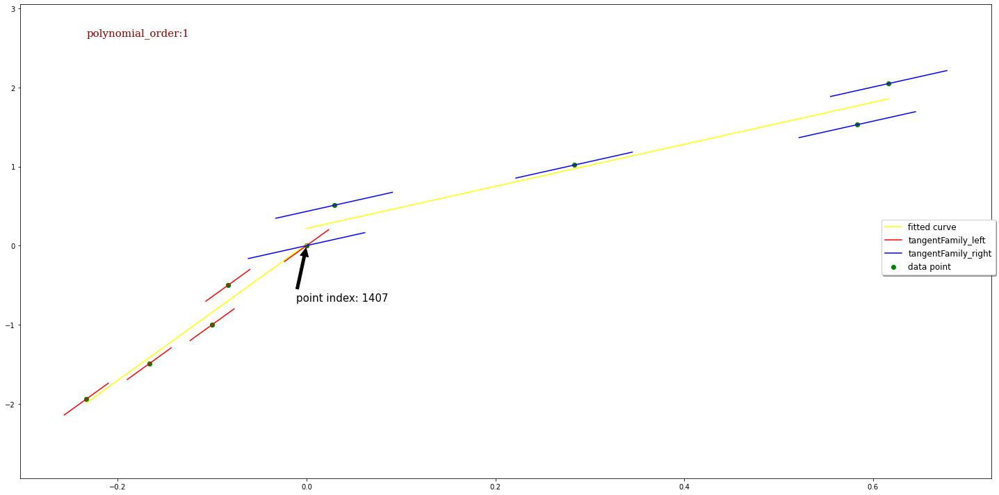

=======point_index=========== 1420
tangent[0]:4.97755
tangent[1]:4.97755
tangent[2]:4.97755
tangent[3]:4.97755
tangent[4]:4.97755
tangent[0]:12.51378
tangent[1]:12.51378
tangent[2]:12.51378
tangent[3]:12.51378
tangent[4]:12.51378


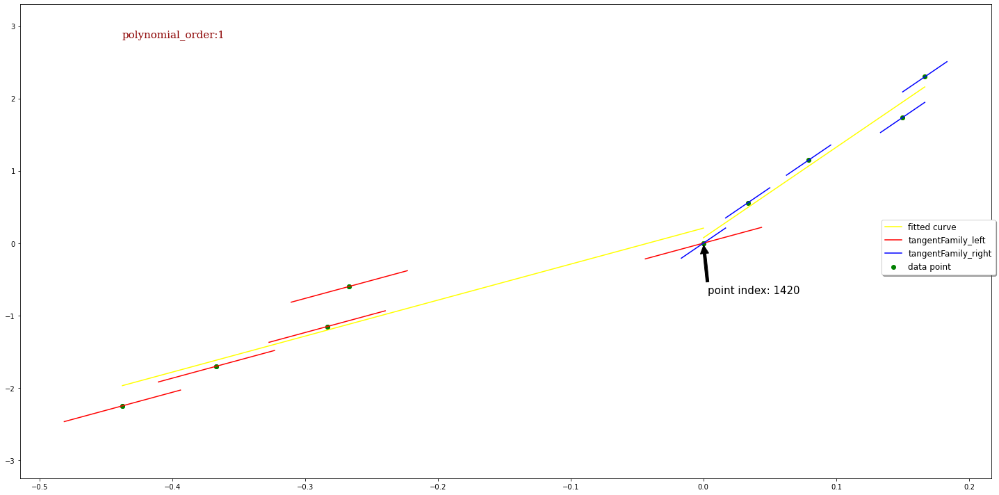

=======point_index=========== 1433
tangent[0]:5.95802
tangent[1]:5.95802
tangent[2]:5.95802
tangent[3]:5.95802
tangent[4]:5.95802
tangent[0]:4.93773
tangent[1]:4.93773
tangent[2]:4.93773
tangent[3]:4.93773
tangent[4]:4.93773


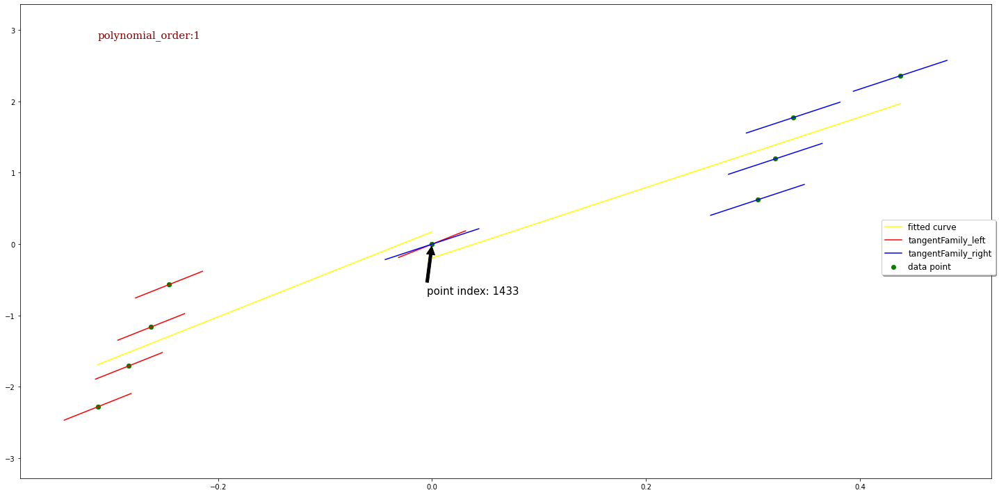

=======point_index=========== 1444
tangent[0]:24.5452
tangent[1]:24.5452
tangent[2]:24.5452
tangent[3]:24.5452
tangent[4]:24.5452
tangent[0]:21.06174
tangent[1]:21.06174
tangent[2]:21.06174
tangent[3]:21.06174
tangent[4]:21.06174


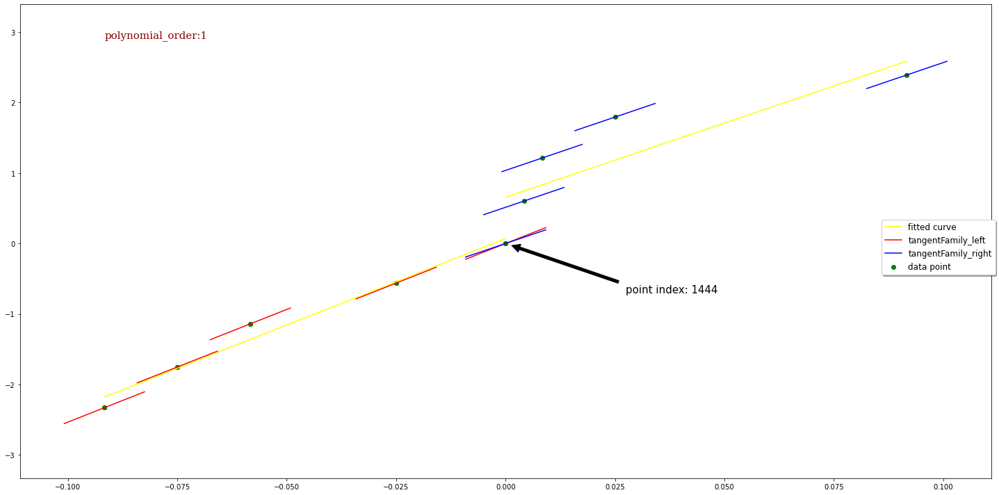

=======point_index=========== 1456
tangent[0]:3.75793
tangent[1]:3.75793
tangent[2]:3.75793
tangent[3]:3.75793
tangent[4]:3.75793
tangent[0]:3.00837
tangent[1]:3.00837
tangent[2]:3.00837
tangent[3]:3.00837
tangent[4]:3.00837


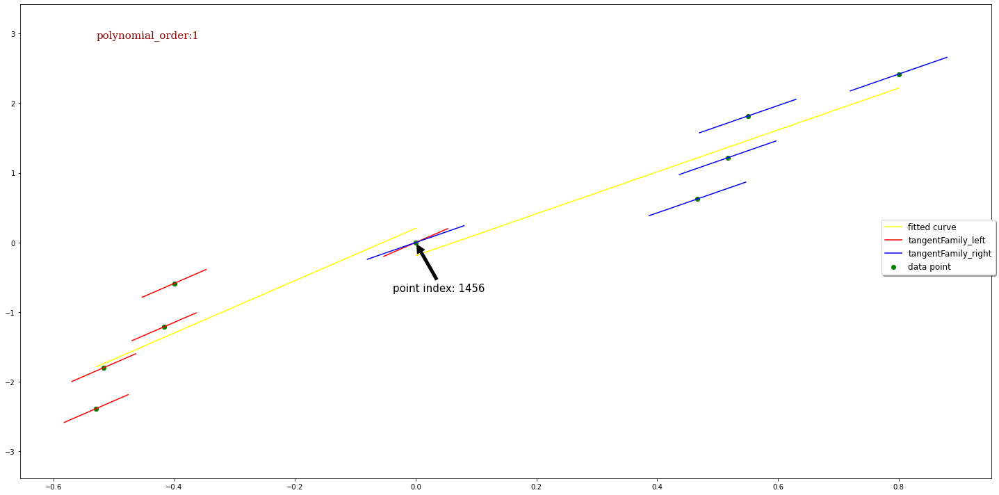

=======point_index=========== 1460
tangent[0]:3.00837
tangent[1]:3.00837
tangent[2]:3.00837
tangent[3]:3.00837
tangent[4]:3.00837
tangent[0]:4.70752
tangent[1]:4.70752
tangent[2]:4.70752
tangent[3]:4.70752
tangent[4]:4.70752


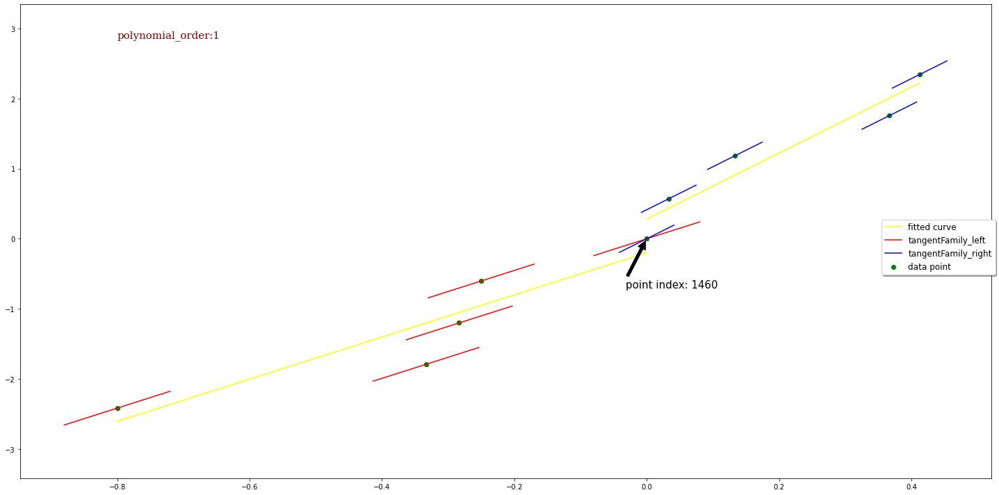

=======point_index=========== 1476
tangent[0]:7.38949
tangent[1]:7.38949
tangent[2]:7.38949
tangent[3]:7.38949
tangent[4]:7.38949
tangent[0]:2.82956
tangent[1]:2.82956
tangent[2]:2.82956
tangent[3]:2.82956
tangent[4]:2.82956


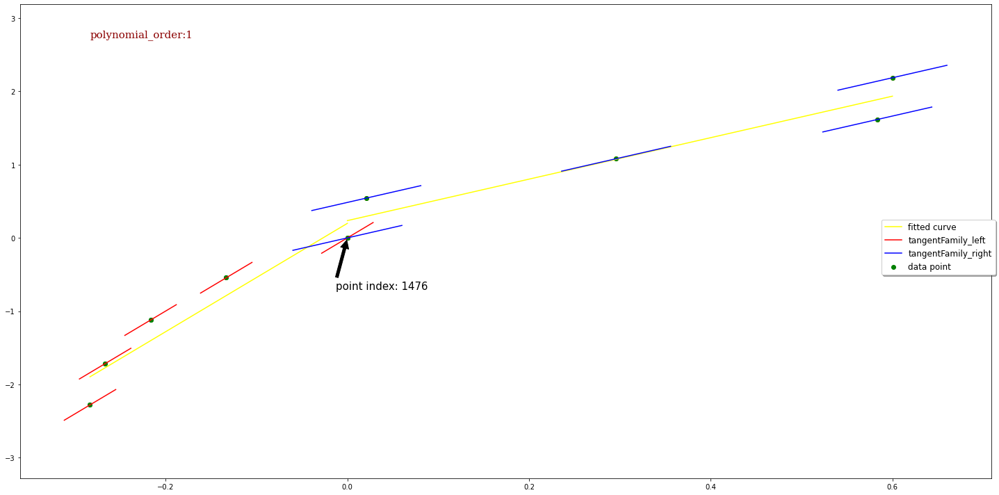

=======point_index=========== 1481
tangent[0]:2.29074
tangent[1]:2.29074
tangent[2]:2.29074
tangent[3]:2.29074
tangent[4]:2.29074
tangent[0]:5.71119
tangent[1]:5.71119
tangent[2]:5.71119
tangent[3]:5.71119
tangent[4]:5.71119


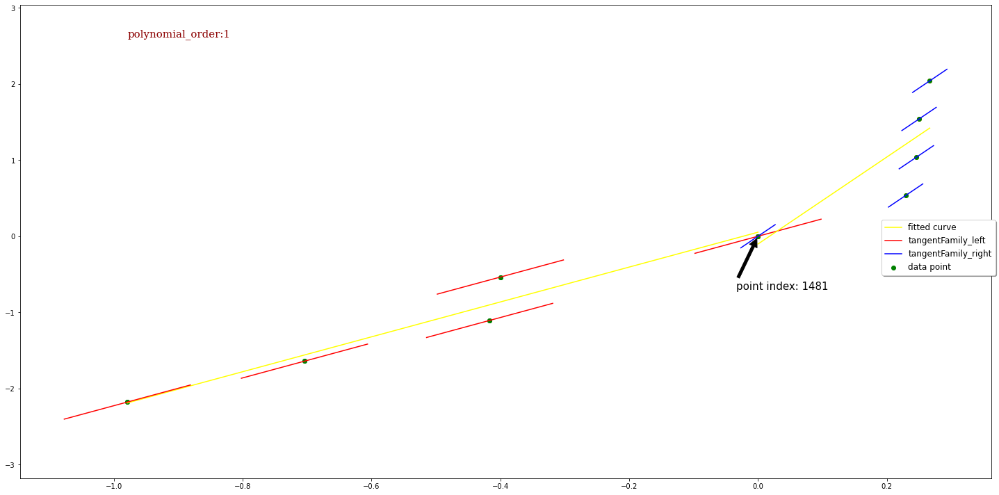

=======point_index=========== 1492
tangent[0]:12.20518
tangent[1]:12.20518
tangent[2]:12.20518
tangent[3]:12.20518
tangent[4]:12.20518
tangent[0]:3.24883
tangent[1]:3.24883
tangent[2]:3.24883
tangent[3]:3.24883
tangent[4]:3.24883


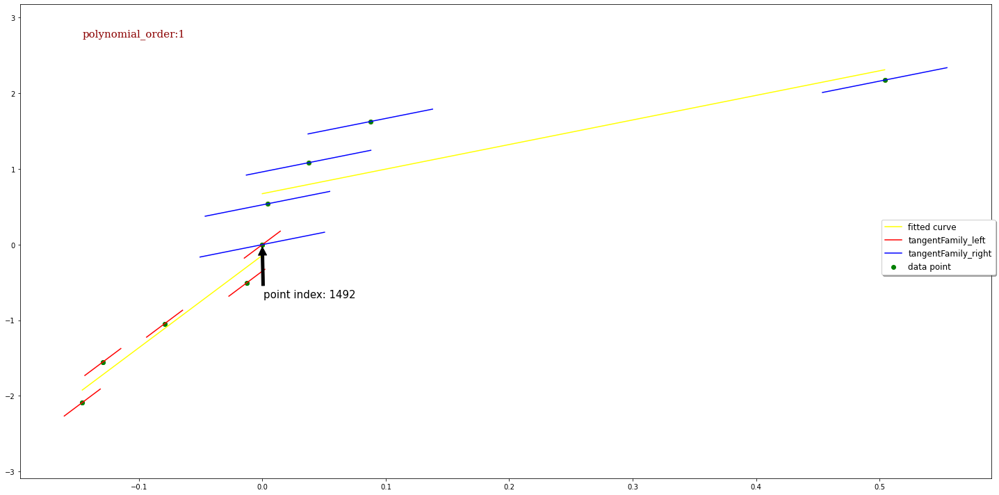

=======point_index=========== 1496
tangent[0]:3.24883
tangent[1]:3.24883
tangent[2]:3.24883
tangent[3]:3.24883
tangent[4]:3.24883
tangent[0]:2.98587
tangent[1]:2.98587
tangent[2]:2.98587
tangent[3]:2.98587
tangent[4]:2.98587


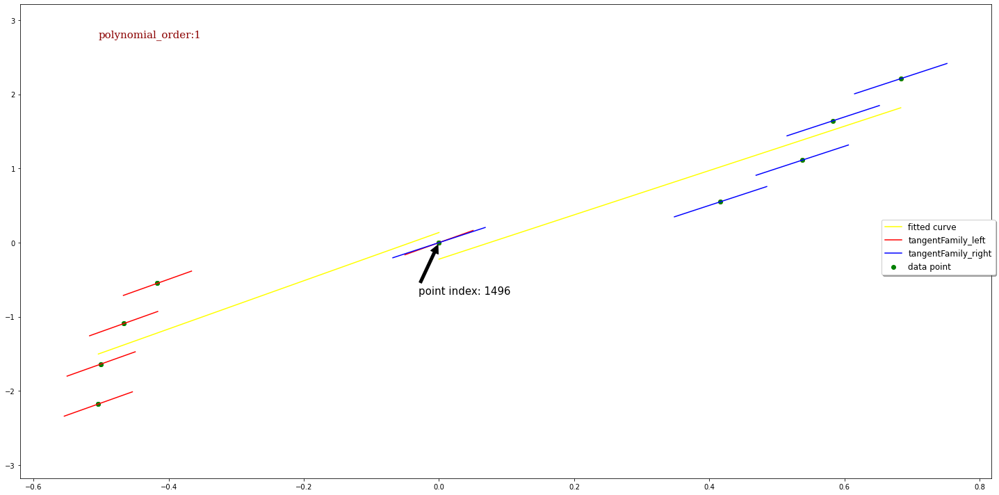

=======point_index=========== 1509
tangent[0]:3.44077
tangent[1]:3.44077
tangent[2]:3.44077
tangent[3]:3.44077
tangent[4]:3.44077
tangent[0]:10.83345
tangent[1]:10.83345
tangent[2]:10.83345
tangent[3]:10.83345
tangent[4]:10.83345


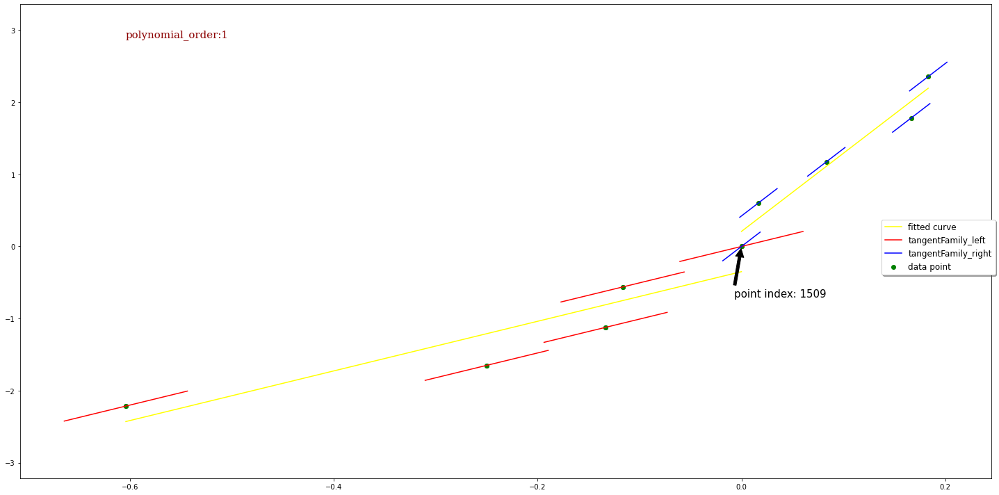

=======point_index=========== 1514
tangent[0]:7.95795
tangent[1]:7.95795
tangent[2]:7.95795
tangent[3]:7.95795
tangent[4]:7.95795
tangent[0]:9.99228
tangent[1]:9.99228
tangent[2]:9.99228
tangent[3]:9.99228
tangent[4]:9.99228


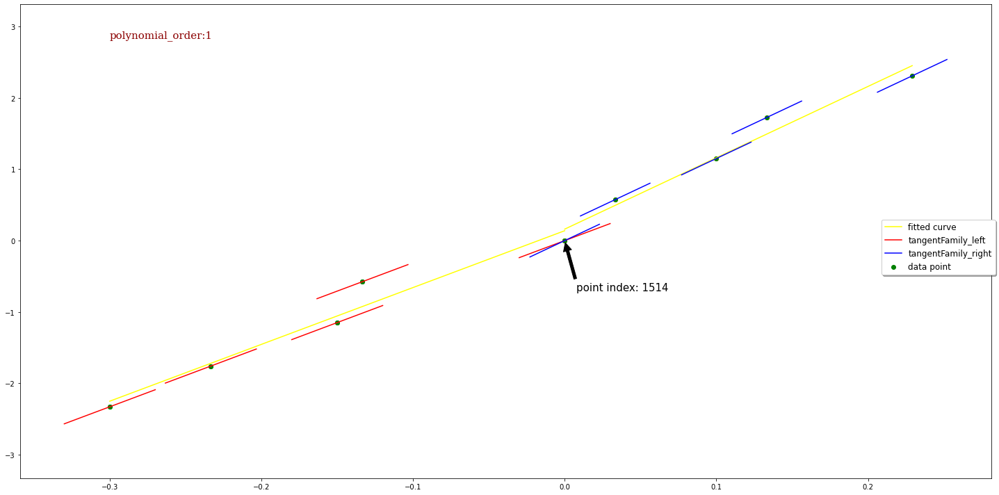

=======point_index=========== 1528
tangent[0]:3.18059
tangent[1]:3.18059
tangent[2]:3.18059
tangent[3]:3.18059
tangent[4]:3.18059
tangent[0]:8.27068
tangent[1]:8.27068
tangent[2]:8.27068
tangent[3]:8.27068
tangent[4]:8.27068


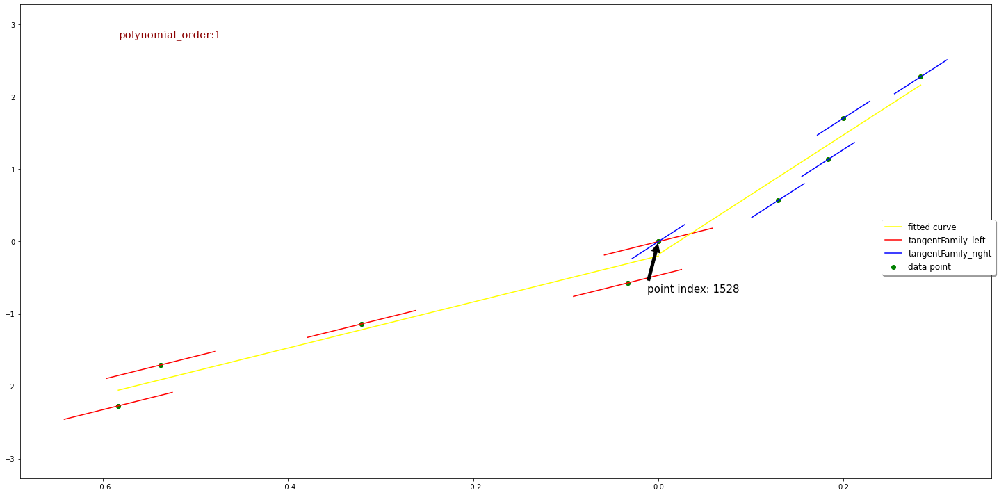

=======point_index=========== 1535
tangent[0]:4.32703
tangent[1]:4.32703
tangent[2]:4.32703
tangent[3]:4.32703
tangent[4]:4.32703
tangent[0]:17.53641
tangent[1]:17.53641
tangent[2]:17.53641
tangent[3]:17.53641
tangent[4]:17.53641


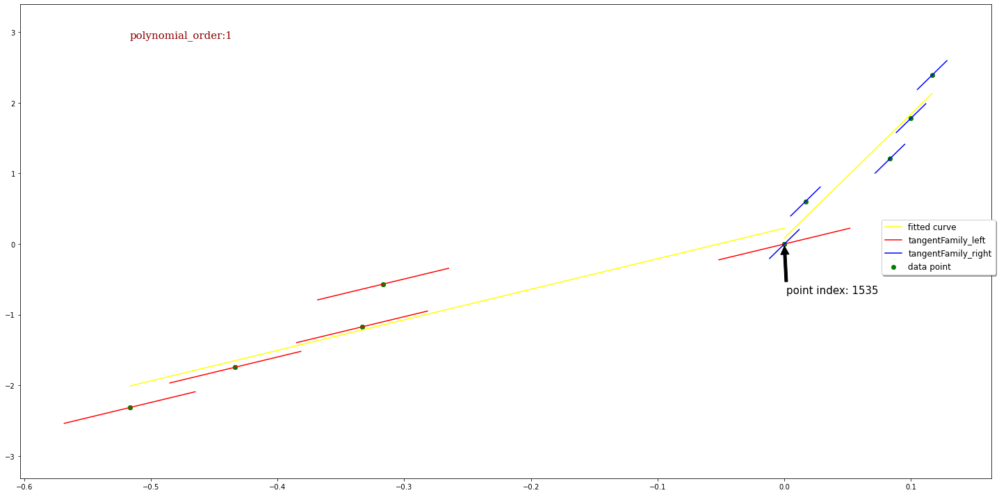

=======point_index=========== 1545
tangent[0]:2.80479
tangent[1]:2.80479
tangent[2]:2.80479
tangent[3]:2.80479
tangent[4]:2.80479
tangent[0]:4.55449
tangent[1]:4.55449
tangent[2]:4.55449
tangent[3]:4.55449
tangent[4]:4.55449


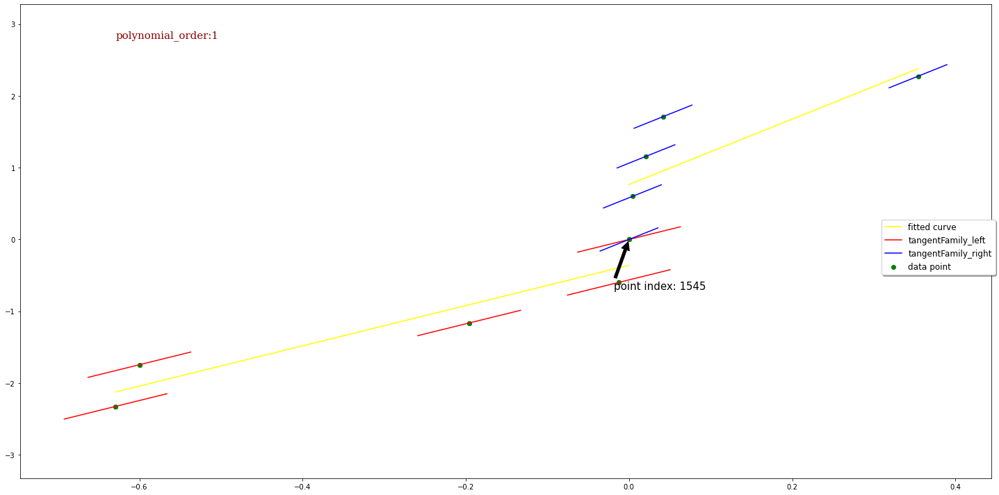

=======point_index=========== 1550
tangent[0]:4.27445
tangent[1]:4.27445
tangent[2]:4.27445
tangent[3]:4.27445
tangent[4]:4.27445
tangent[0]:5.54558
tangent[1]:5.54558
tangent[2]:5.54558
tangent[3]:5.54558
tangent[4]:5.54558


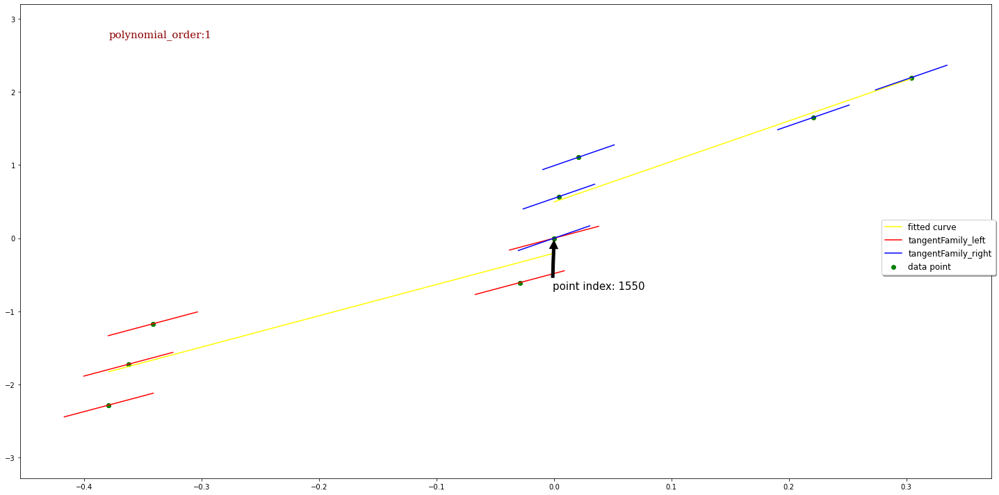

=======point_index=========== 1572
tangent[0]:5.28146
tangent[1]:5.28146
tangent[2]:5.28146
tangent[3]:5.28146
tangent[4]:5.28146
tangent[0]:3.516
tangent[1]:3.516
tangent[2]:3.516
tangent[3]:3.516
tangent[4]:3.516


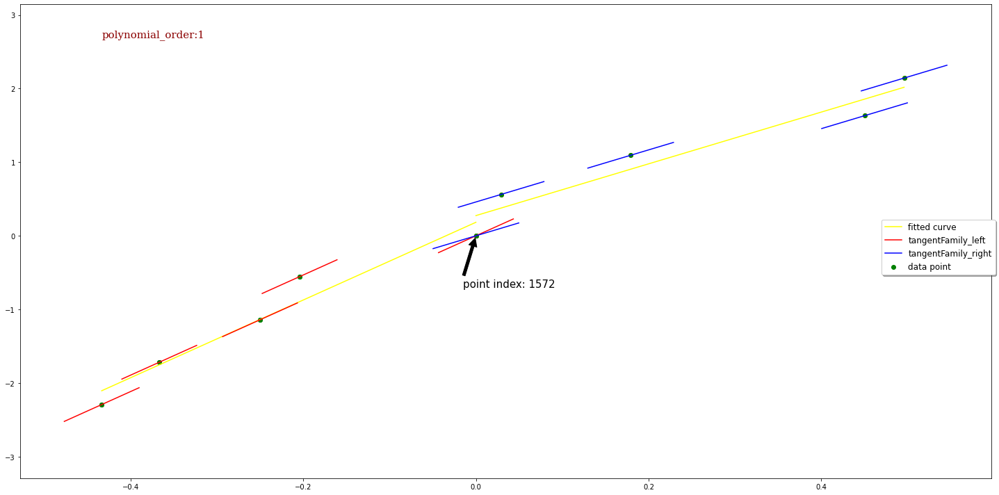

=======point_index=========== 1582
tangent[0]:1.93106
tangent[1]:1.93106
tangent[2]:1.93106
tangent[3]:1.93106
tangent[4]:1.93106
tangent[0]:1.803
tangent[1]:1.803
tangent[2]:1.803
tangent[3]:1.803
tangent[4]:1.803


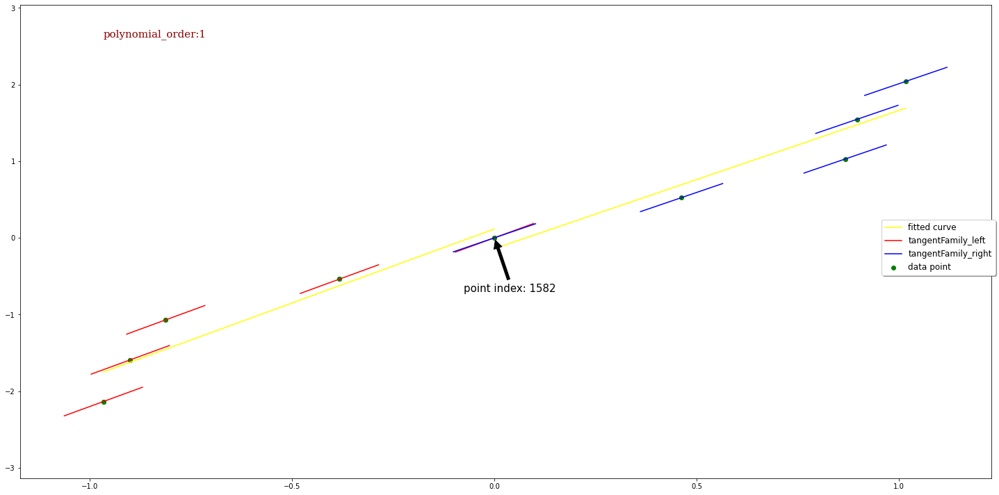

=======point_index=========== 1592
tangent[0]:5.60685
tangent[1]:5.60685
tangent[2]:5.60685
tangent[3]:5.60685
tangent[4]:5.60685
tangent[0]:3.98576
tangent[1]:3.98576
tangent[2]:3.98576
tangent[3]:3.98576
tangent[4]:3.98576


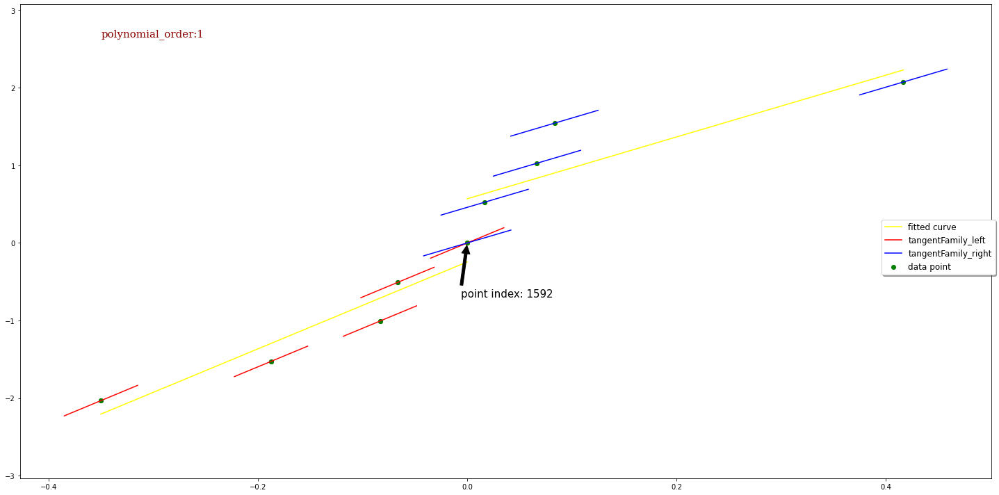

=======point_index=========== 1601
tangent[0]:6.91995
tangent[1]:6.91995
tangent[2]:6.91995
tangent[3]:6.91995
tangent[4]:6.91995
tangent[0]:5.85961
tangent[1]:5.85961
tangent[2]:5.85961
tangent[3]:5.85961
tangent[4]:5.85961


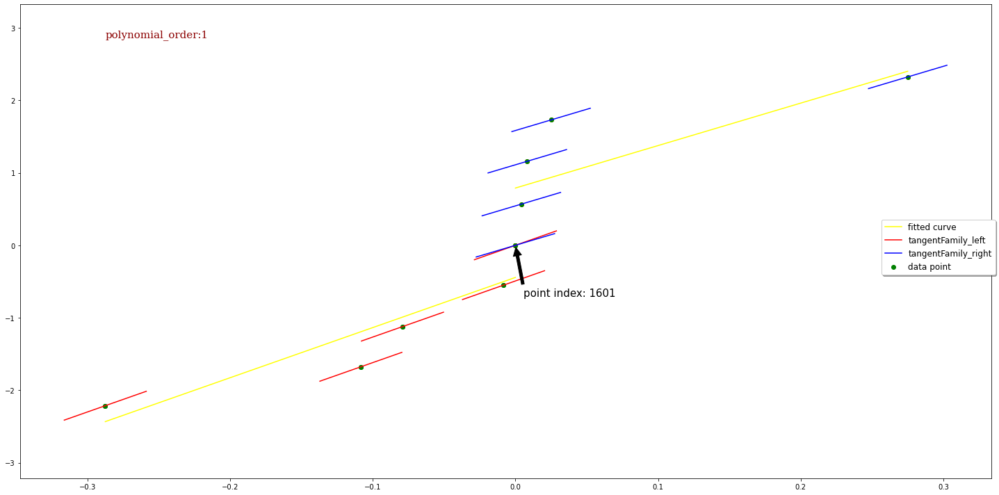

=======point_index=========== 1613
tangent[0]:13.29057
tangent[1]:13.29057
tangent[2]:13.29057
tangent[3]:13.29057
tangent[4]:13.29057
tangent[0]:4.89294
tangent[1]:4.89294
tangent[2]:4.89294
tangent[3]:4.89294
tangent[4]:4.89294


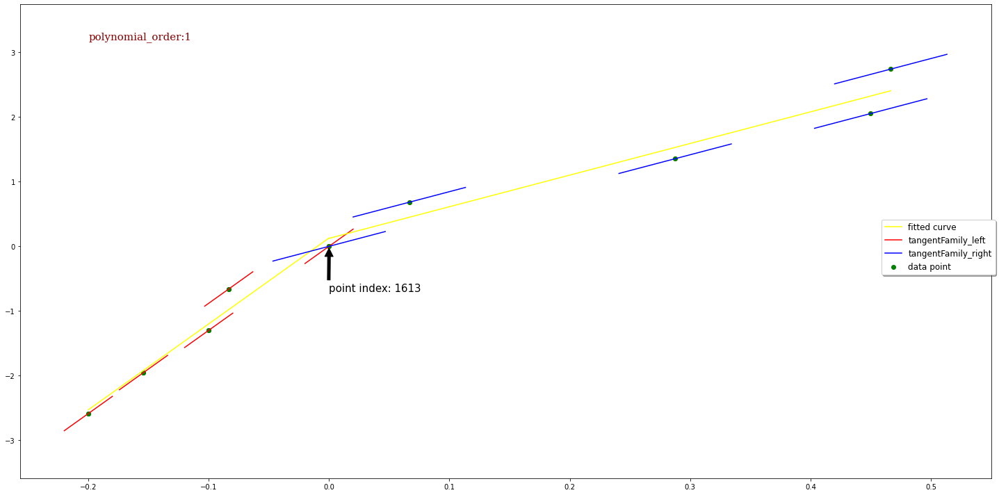

=======point_index=========== 1619
tangent[0]:4.43342
tangent[1]:4.43342
tangent[2]:4.43342
tangent[3]:4.43342
tangent[4]:4.43342
tangent[0]:2.79025
tangent[1]:2.79025
tangent[2]:2.79025
tangent[3]:2.79025
tangent[4]:2.79025


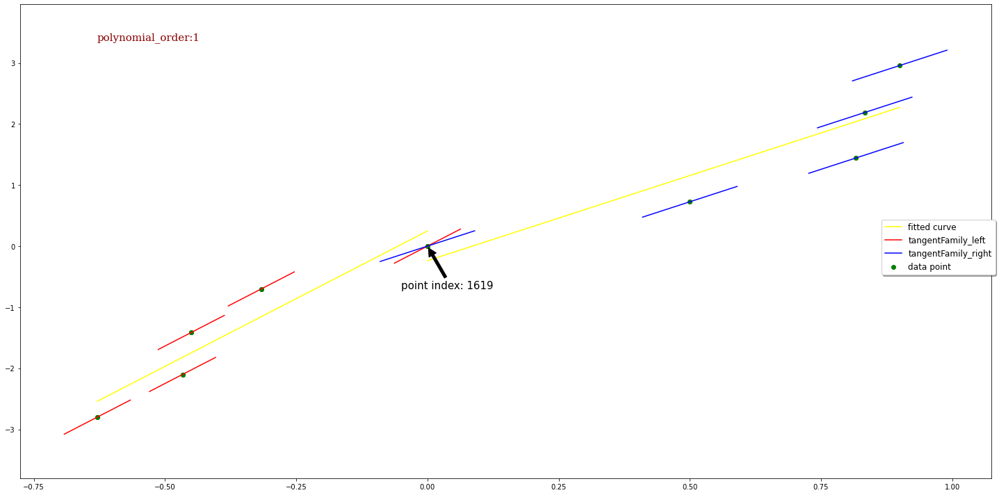

=======point_index=========== 1621
tangent[0]:2.06539
tangent[1]:2.06539
tangent[2]:2.06539
tangent[3]:2.06539
tangent[4]:2.06539
tangent[0]:10.92319
tangent[1]:10.92319
tangent[2]:10.92319
tangent[3]:10.92319
tangent[4]:10.92319


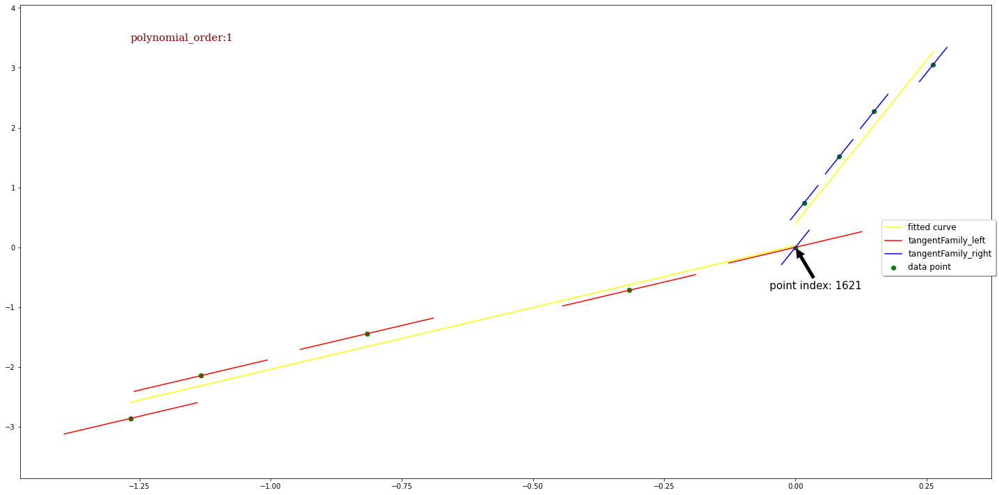

=======point_index=========== 1632
tangent[0]:3.31726
tangent[1]:3.31726
tangent[2]:3.31726
tangent[3]:3.31726
tangent[4]:3.31726
tangent[0]:18.4298
tangent[1]:18.4298
tangent[2]:18.4298
tangent[3]:18.4298
tangent[4]:18.4298


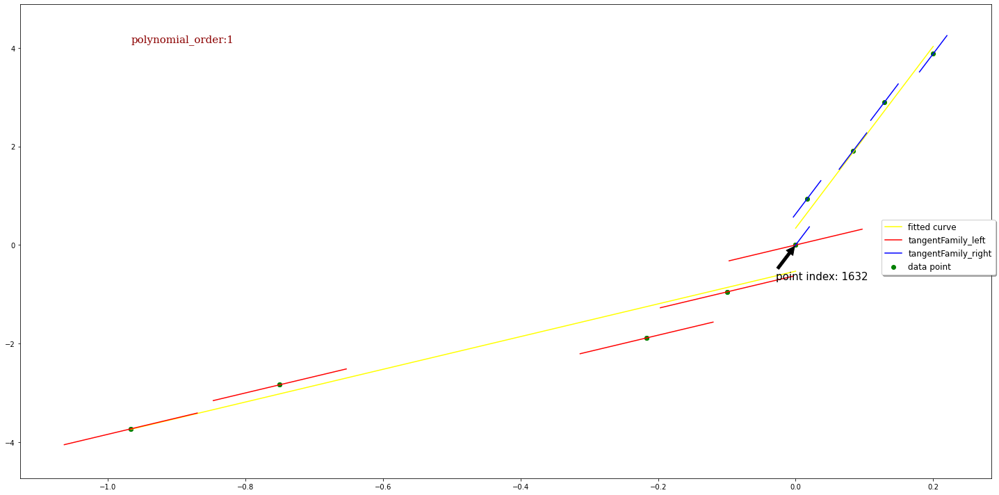

=======point_index=========== 1640
tangent[0]:5.39532
tangent[1]:5.39532
tangent[2]:5.39532
tangent[3]:5.39532
tangent[4]:5.39532
tangent[0]:7.12109
tangent[1]:7.12109
tangent[2]:7.12109
tangent[3]:7.12109
tangent[4]:7.12109


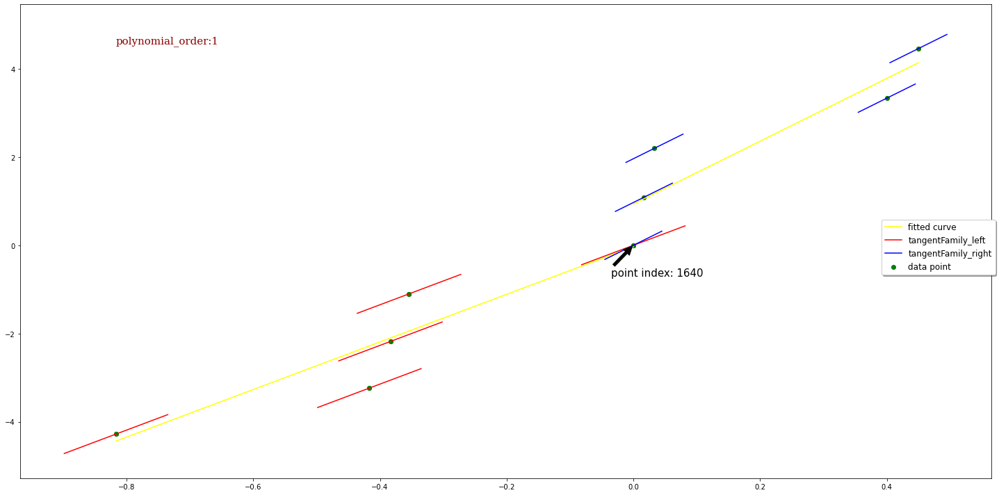

=======point_index=========== 1648
tangent[0]:4.9991
tangent[1]:4.9991
tangent[2]:4.9991
tangent[3]:4.9991
tangent[4]:4.9991
tangent[0]:5.2975
tangent[1]:5.2975
tangent[2]:5.2975
tangent[3]:5.2975
tangent[4]:5.2975


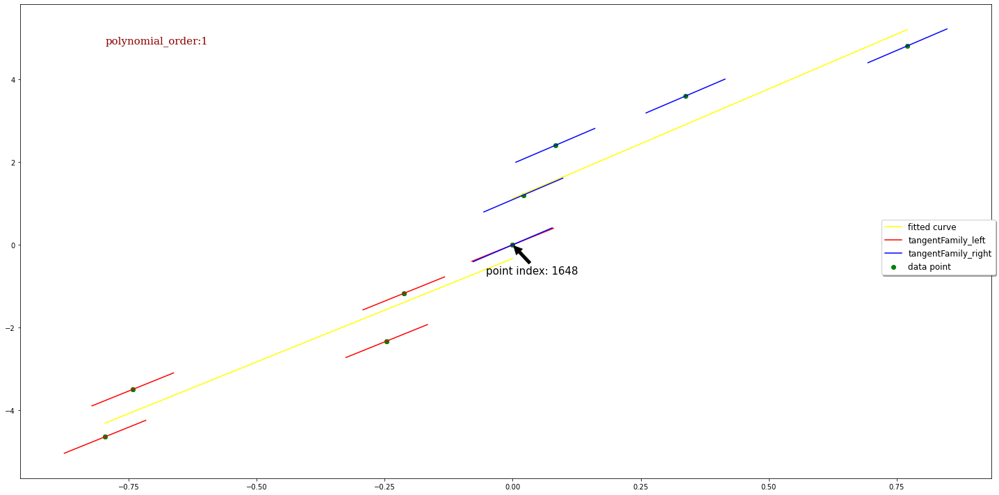

=======point_index=========== 1655
tangent[0]:5.27209
tangent[1]:5.27209
tangent[2]:5.27209
tangent[3]:5.27209
tangent[4]:5.27209
tangent[0]:5.71474
tangent[1]:5.71474
tangent[2]:5.71474
tangent[3]:5.71474
tangent[4]:5.71474


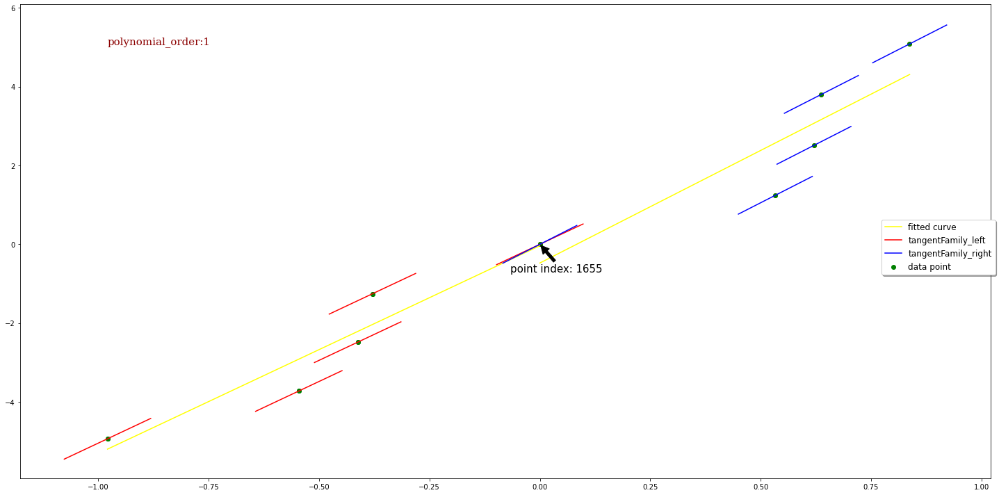

=======point_index=========== 1657
tangent[0]:3.88829
tangent[1]:3.88829
tangent[2]:3.88829
tangent[3]:3.88829
tangent[4]:3.88829
tangent[0]:11.49687
tangent[1]:11.49687
tangent[2]:11.49687
tangent[3]:11.49687
tangent[4]:11.49687


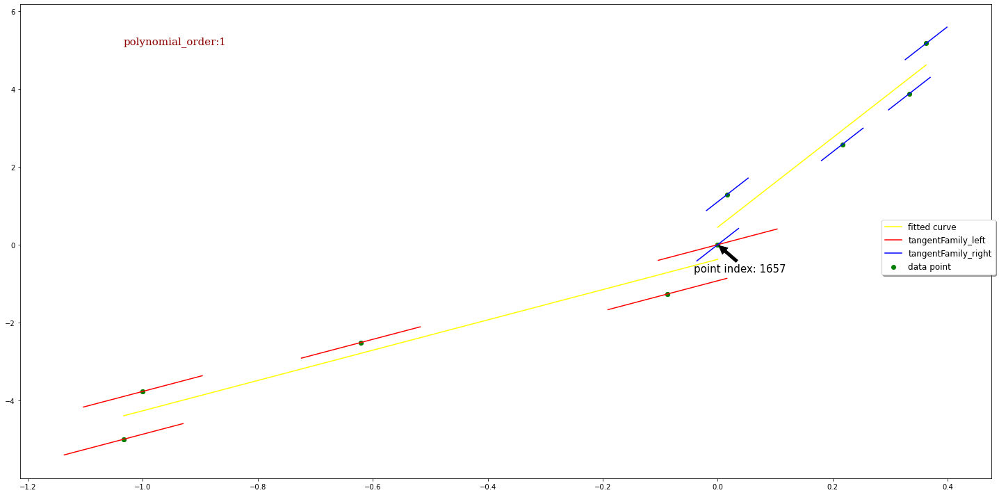

=======point_index=========== 1665
tangent[0]:5.3101
tangent[1]:5.3101
tangent[2]:5.3101
tangent[3]:5.3101
tangent[4]:5.3101
tangent[0]:4.38855
tangent[1]:4.38855
tangent[2]:4.38855
tangent[3]:4.38855
tangent[4]:4.38855


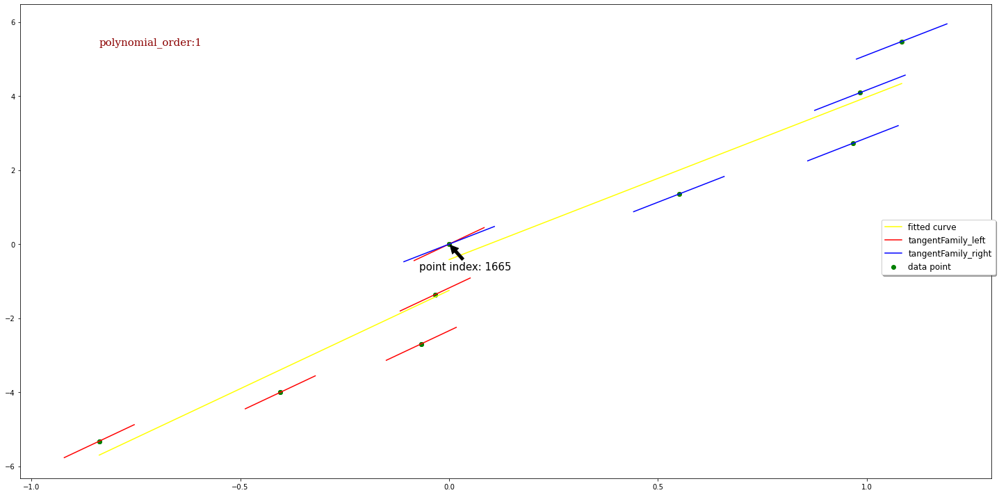

=======point_index=========== 1669
tangent[0]:4.38855
tangent[1]:4.38855
tangent[2]:4.38855
tangent[3]:4.38855
tangent[4]:4.38855
tangent[0]:2.80147
tangent[1]:2.80147
tangent[2]:2.80147
tangent[3]:2.80147
tangent[4]:2.80147


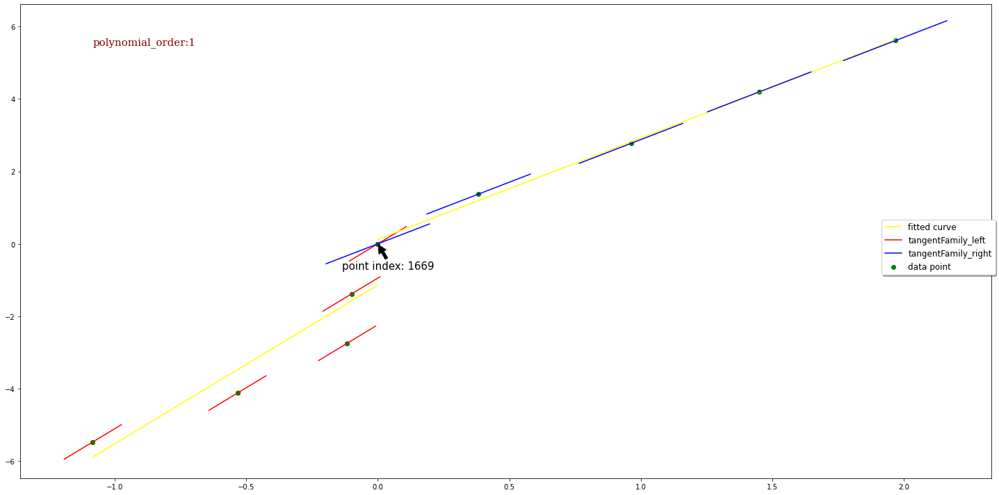

=======point_index=========== 1671
tangent[0]:4.33871
tangent[1]:4.33871
tangent[2]:4.33871
tangent[3]:4.33871
tangent[4]:4.33871
tangent[0]:2.86343
tangent[1]:2.86343
tangent[2]:2.86343
tangent[3]:2.86343
tangent[4]:2.86343


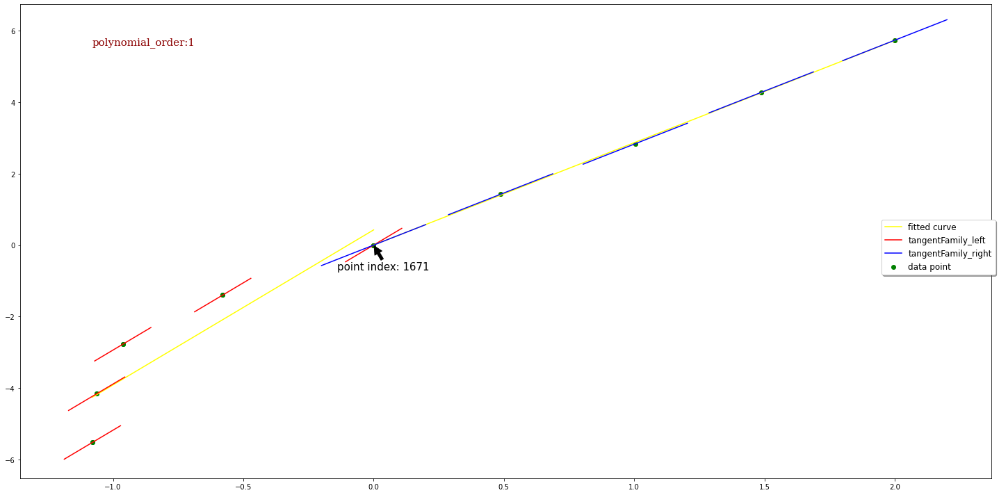

In [5]:
false_points=[1210, 1220, 1243, 1284, 1295, 1320, 1350, 1375, 1380, 1393, 1400, 1407, 1420, 1433, 1444, 1456, 1460, 1476, 1481, 1492, 1496, 1509, 1514, 1528, 1535, 1545, 1550, 1572, 1582, 1592, 1601, 1613, 1619, 1621, 1632, 1640, 1648, 1655, 1657, 1665, 1669, 1671]
point_halfWindow_tagentPlot=point_halfWindow
data_forTangentPlot=identify_useDeltaTangent.produce_tangent_inWindow(pressure_measure,
                                                                   pressure_time,
                                                                   false_points,
                                                                   "for_plot",
                                                                   time_halfWindow,
                                                                   point_halfWindow,
                                                                   polynomial_order,                                                       
                                                                   point_halfWindow_tagentPlot)
for point_index in false_points:
    identify_useDeltaTangent.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

In [5]:
pd.set_option('display.max_colwidth', None)
data_plotPoint=data_forTangentPlot.loc[data_forTangentPlot['point_index'] == 1295]
data_plotPoint

,point_index,pressure_time_left,pressure_time_right,pressure_measure_left,pressure_measure_right,left_curves_parameters,right_curves_parameters,tangentFamily_left,tangentFamily_right
8,1295,"[-0.275, -0.029167, -0.0125, -0.008333, 0.0]","[0.0, 0.004167, 0.008333, 0.025, 0.058333]","[-1.17784, -0.901194, -0.596919, -0.292359, 0.0]","[0.0, 0.33244, 0.630449, 0.892654, 1.155593]","[1552838.08352, -237501.80086, -209124.99444, -7311.38518, -11.4648, -0.0]","[20236745.71188, 16908.92118, -89625.63477, 106.79493, 80.88313, 0.0]","[20726.24183199813, -89.48770245072828, 75.33752660558594, 67.40966735623417, -11.4648]","[80.88313, 77.13981139127338, 64.51948069960157, -41.243487151484416, 363.418860780072]"
9,1295,"[-0.275, -0.029167, -0.0125, -0.008333, 0.0]","[0.0, 0.004167, 0.008333, 0.025, 0.058333]","[-1.17784, -0.901194, -0.596919, -0.292359, 0.0]","[0.0, 0.33244, 0.630449, 0.892654, 1.155593]","[1552838.08352, -237501.80086, -209124.99444, -7311.38518, -11.4648, -0.0]","[20236745.71188, 16908.92118, -89625.63477, 106.79493, 80.88313, 0.0]","[20726.24183199813, -89.48770245072828, 75.33752660558594, 67.40966735623417, -11.4648]","[80.88313, 77.13981139127338, 64.51948069960157, -41.243487151484416, 363.418860780072]"


# plot & save

In [ ]:
# txt=print_tuning_parameters(percentile_tuning,fine_tuning)
# txt+=txt+f"\ntime_halfWindow:{time_halfWindow}\n"
# pprint(txt)
txt=f"buildup:{len(Max_FOD[0])}, drawdown:{len(Max_FOD[1])}"
# txt=""

---initializing...
---plotting...


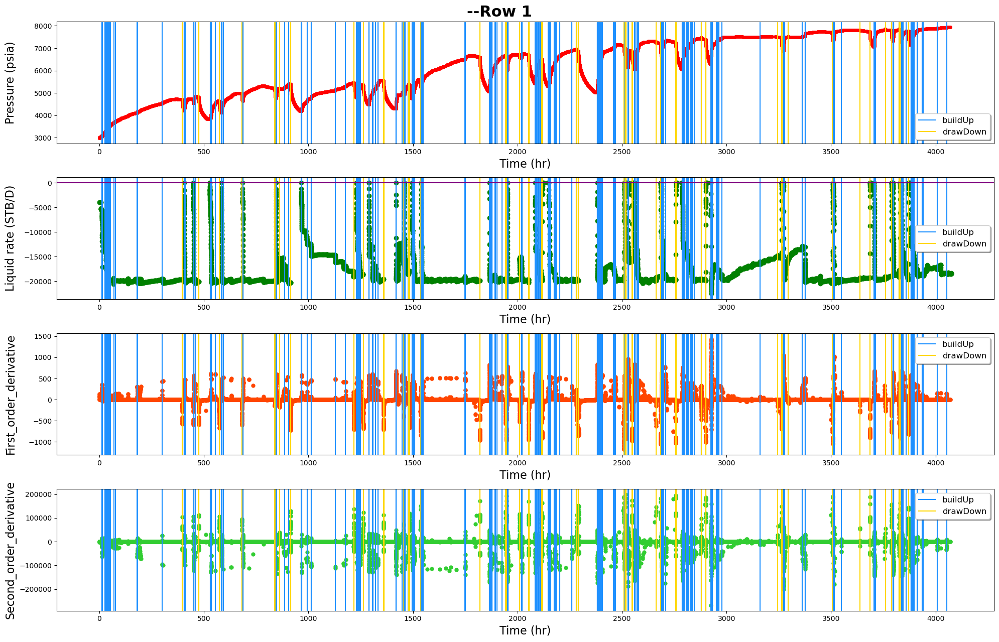

save whole....
detected 479 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[32, 42, 43, 79, 287, 434, 514, 606, 607, 696, 820, 841, 911, 1033, 1035]


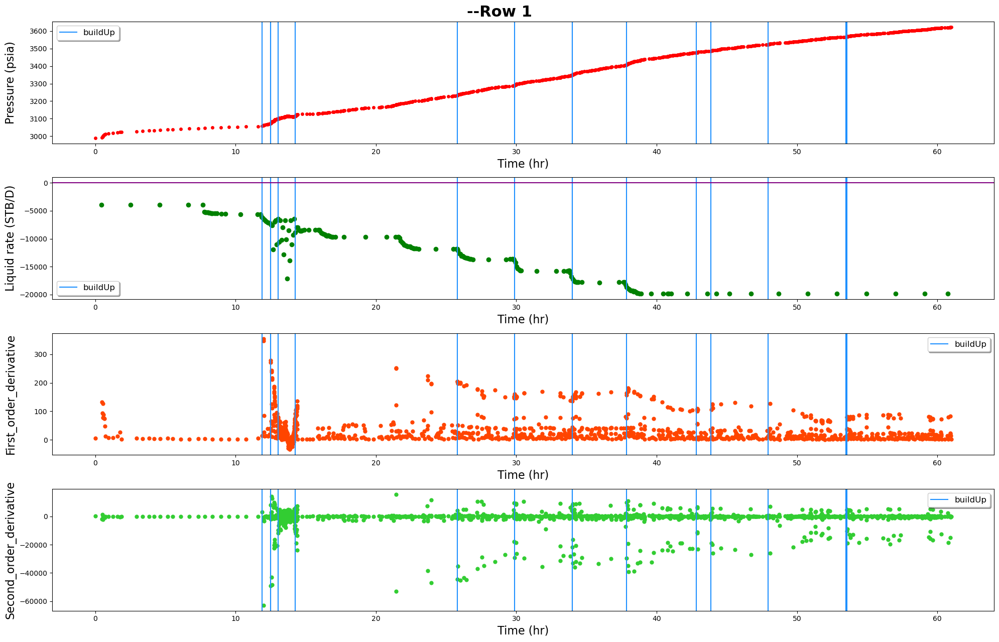

------row 2-----detected points:[1358, 1440, 1814, 1839, 2113, 2257]


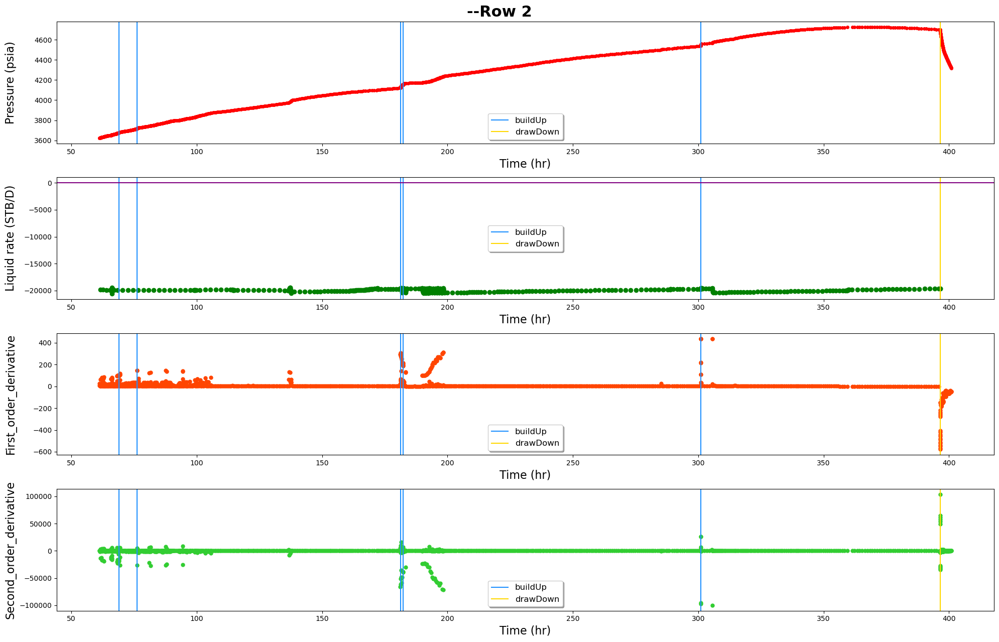

------row 3-----detected points:[2477, 2498, 2515, 2540, 2603, 2661, 2812, 2892, 2900, 2931, 2943, 3022, 3023, 3103, 3130, 3596, 3599]


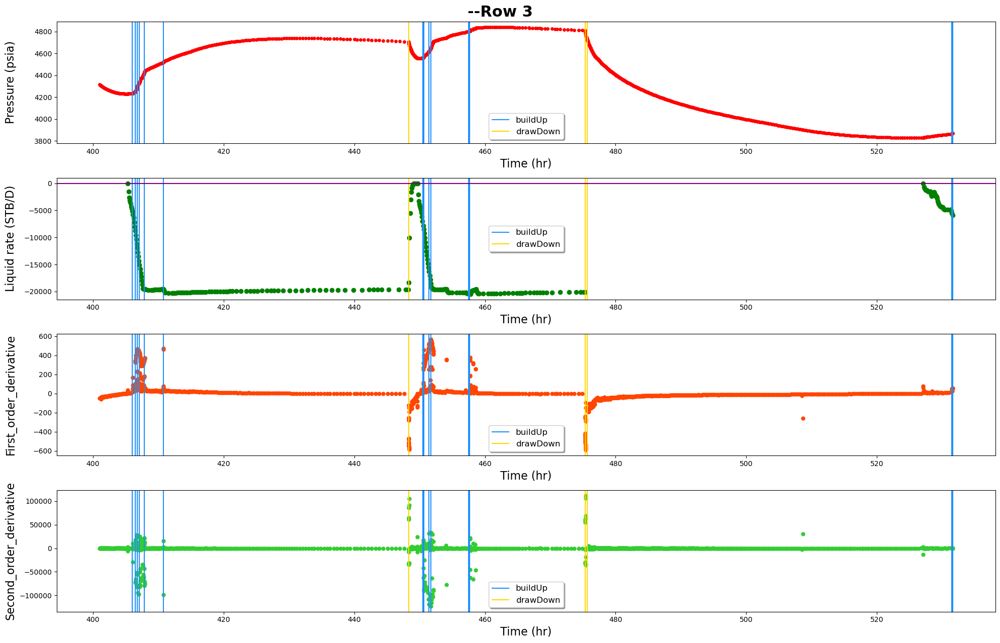

------row 4-----detected points:[3623, 3628, 3666, 3693, 3700, 3723, 3901, 3903, 4017, 4042, 4229, 4247, 4262, 4288, 4293, 4370, 4393, 4491, 4493, 4760, 4763]


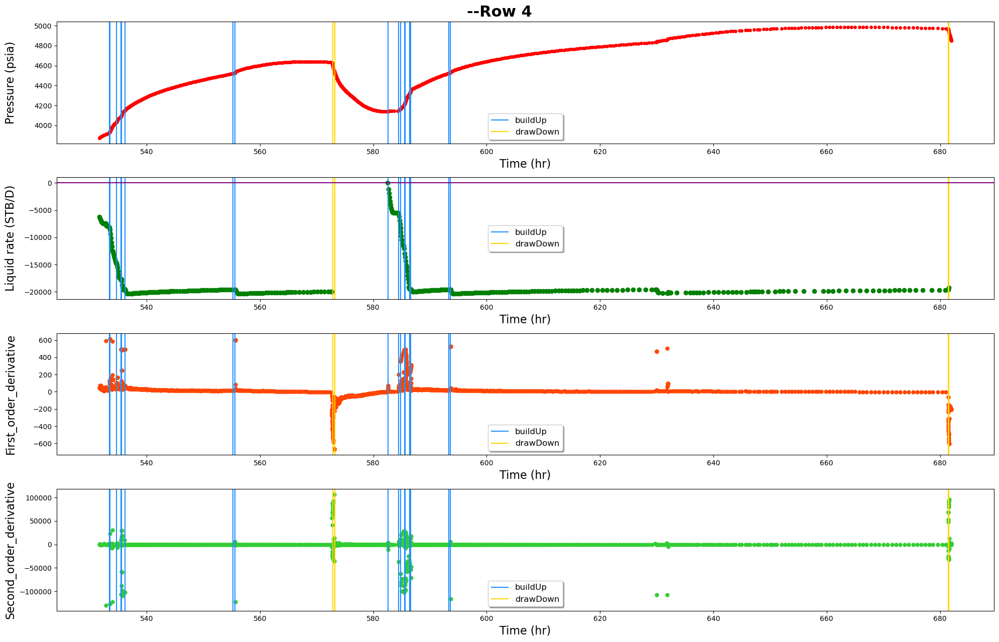

------row 5-----detected points:[4899, 4919, 4949, 4955, 4984, 5303, 5305, 5395, 5466, 5483, 5498, 5528, 5698, 5834, 5946]


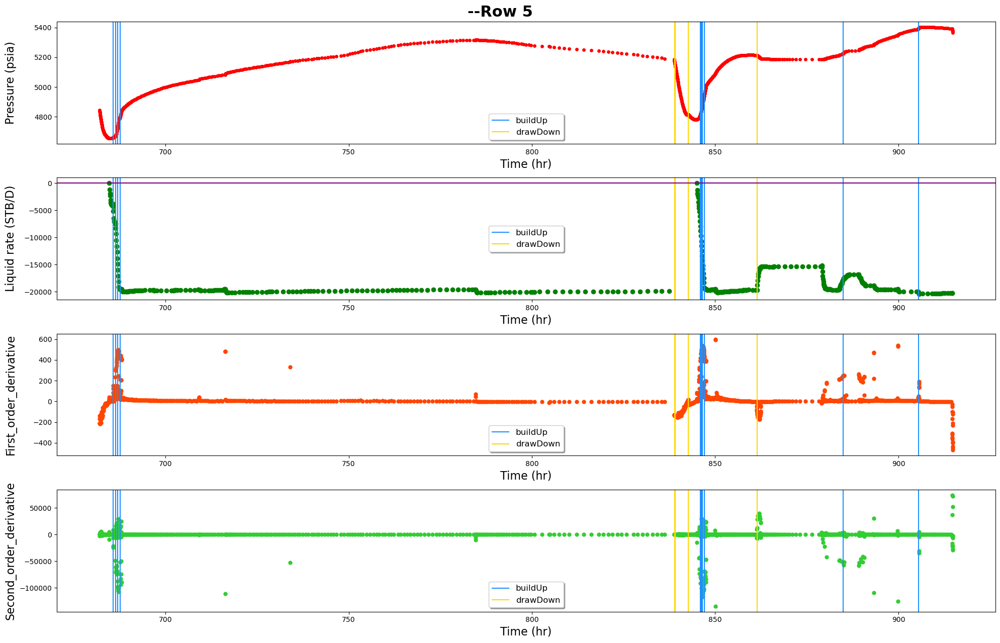

------row 6-----detected points:[6020, 6034, 6544, 6579, 6598, 6776, 6791, 6872, 6880, 7038, 7137]


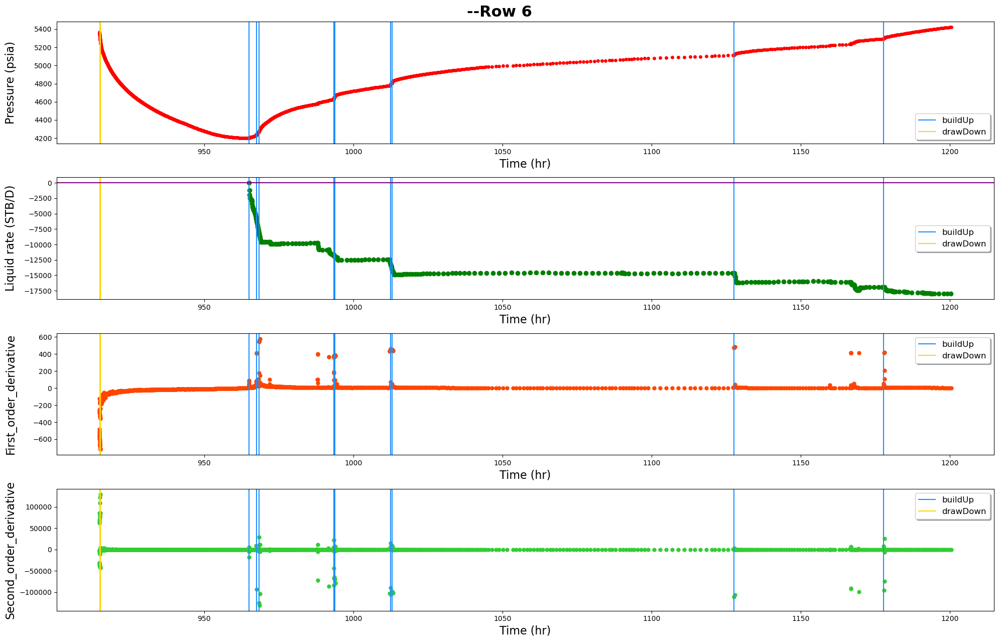

------row 7-----detected points:[7273, 7291, 7556, 7621, 7623, 7647, 7688, 7691, 7716, 7723, 7773, 7775, 7816, 7820, 7849, 7984, 8005, 8372, 8393]


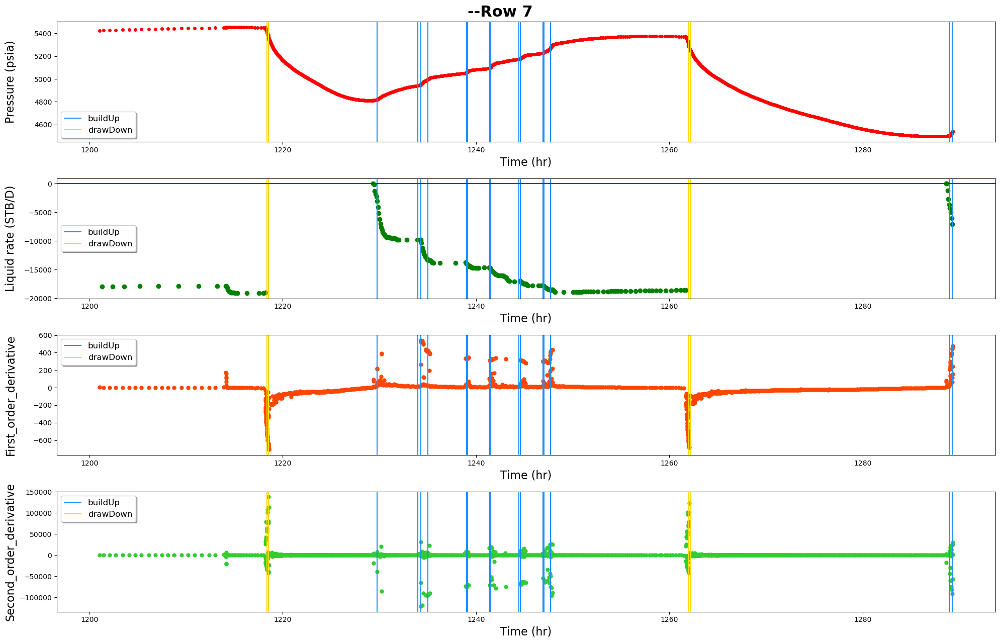

------row 8-----detected points:[8417, 8426, 8601, 8626, 8628, 8662, 8786, 8874, 8876, 8895, 9040, 9125]


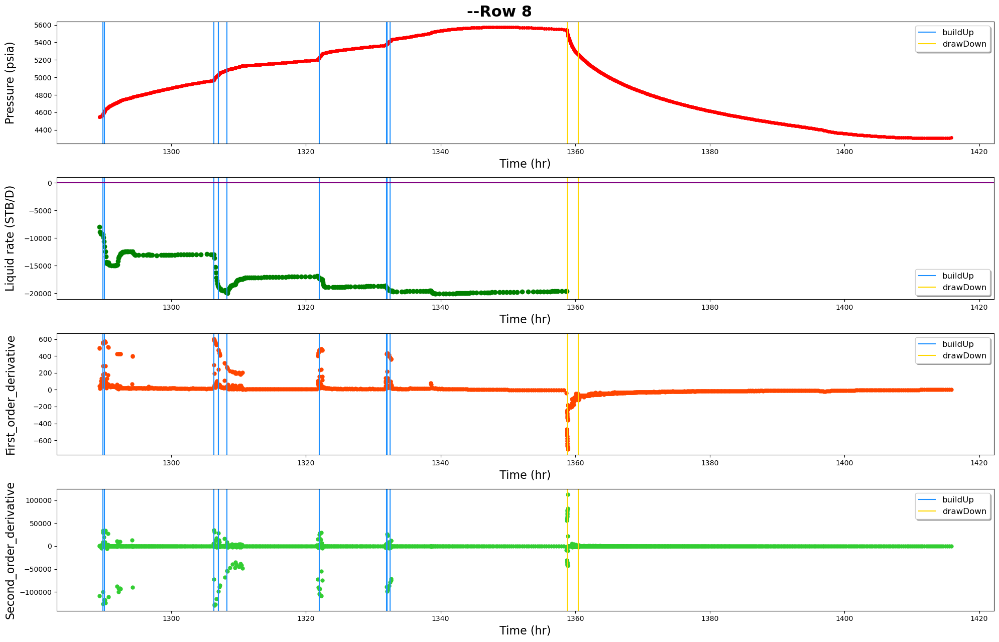

------row 9-----detected points:[9626, 9667, 9680, 9726, 9766, 10069, 10077, 10157, 10238, 10260, 10262, 10337, 10343, 10466, 10490, 10565]


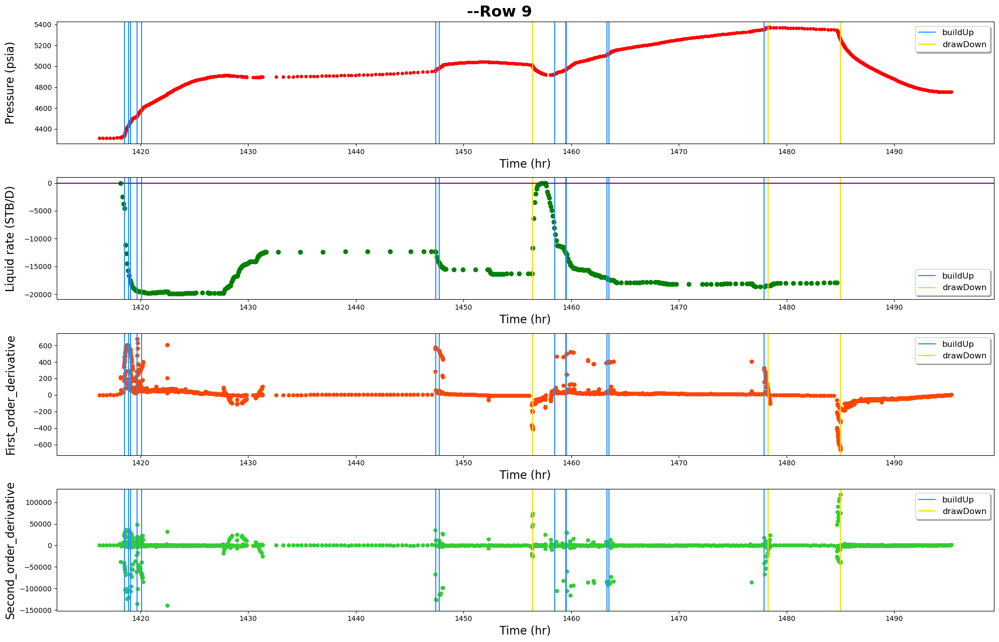

------row 10-----detected points:[10801, 10818, 10871, 10874, 10891, 10946, 10953, 10972, 10974, 10996, 11029, 11083, 11091, 11359, 11378, 11480, 11510, 11539, 11554, 11595, 11607, 11641, 11645, 11672, 11758, 11780]


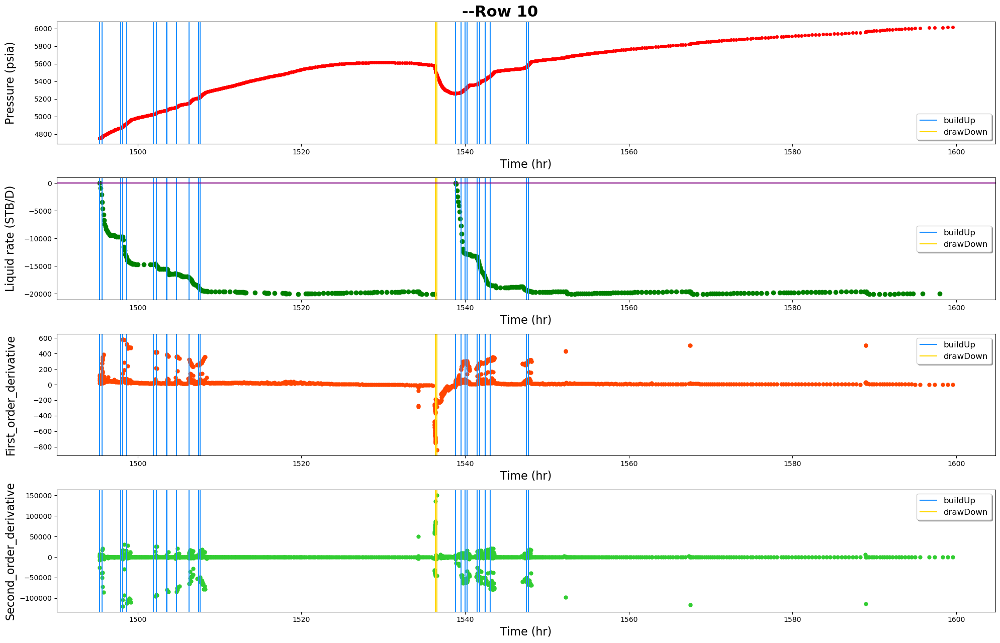

------row 11-----detected points:[12240, 12250, 12391, 12466, 13043, 13080, 13104, 13150, 13163, 13196]


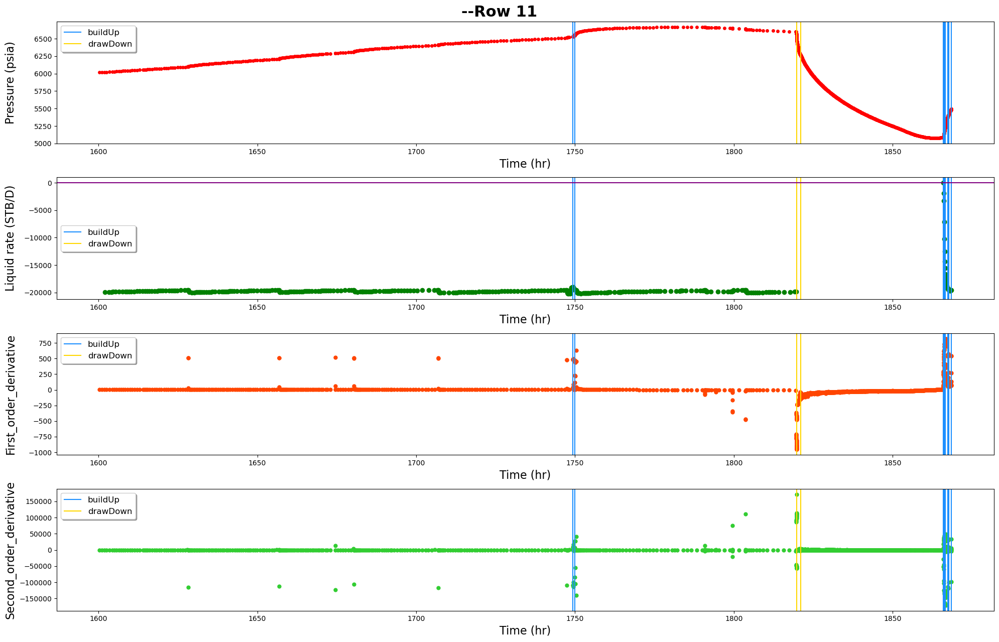

------row 12-----detected points:[13270, 13332, 13336, 13398, 13401, 13424, 13529, 13548, 13562, 13601, 13606, 13667, 13778, 13842, 13852, 13907, 13909, 13987, 14094, 14134, 14143, 14197, 14237, 14277]


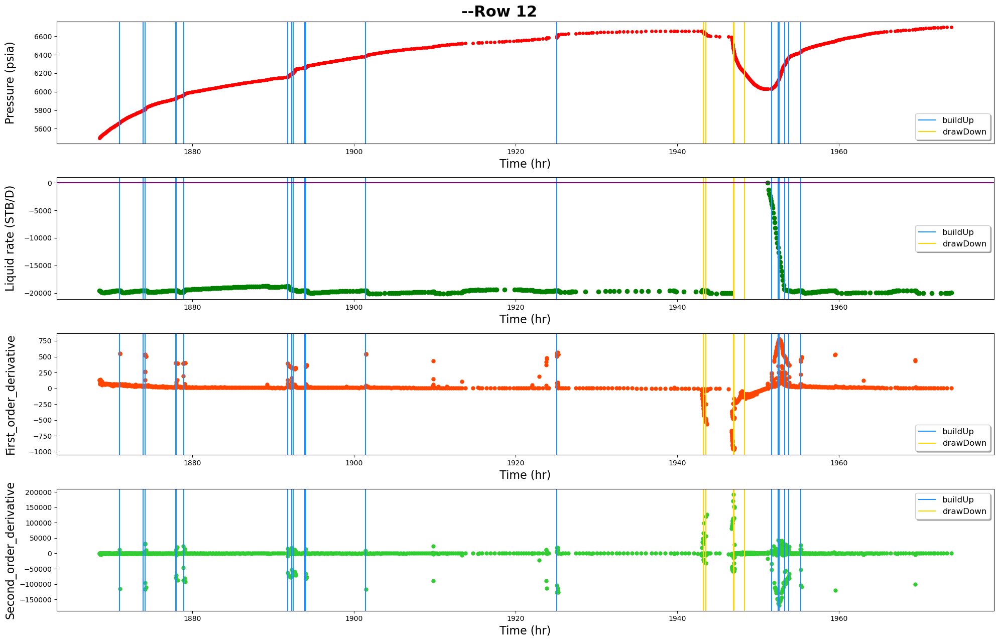

------row 13-----detected points:[14444, 14478, 14590, 14601, 14625, 14650, 14686, 14768, 14806, 14884, 15345, 15356, 15389, 15405, 15427, 15468, 15576, 15582]


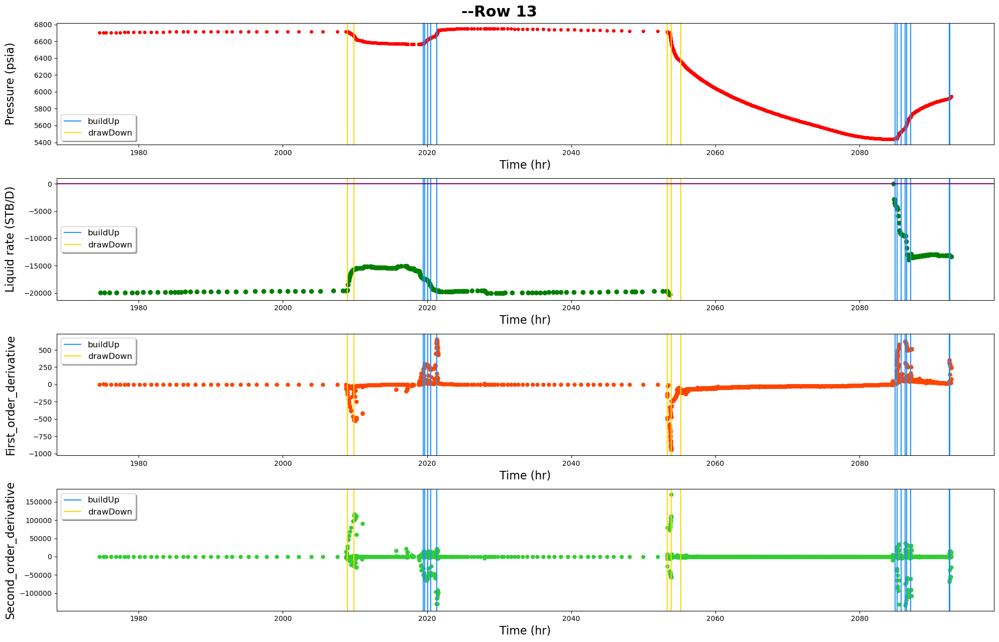

------row 14-----detected points:[15633, 15639, 15660, 15738, 15741, 15756, 15816, 15870, 15940, 15957, 15961, 16009, 16015, 16055, 16069, 16120, 16203, 16583, 16589, 16626, 16651, 16669, 16700, 16764, 16787]


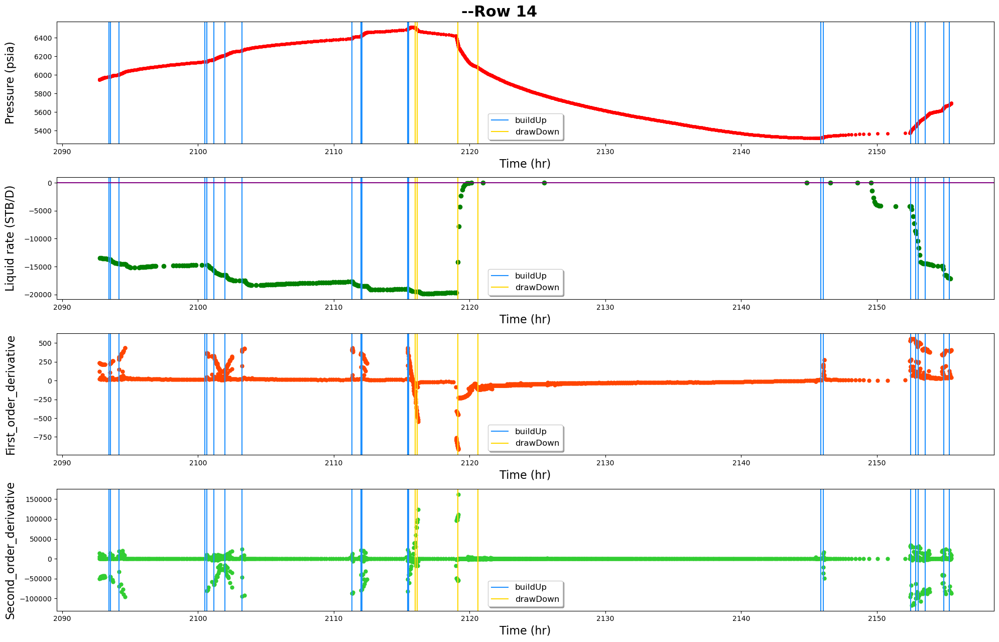

------row 15-----detected points:[16805, 16837, 16908, 17064, 17066, 17085, 17091, 17129, 17158, 17193, 17244, 17253, 17342, 17462, 17467, 17511, 17529, 17560, 17628, 17632]


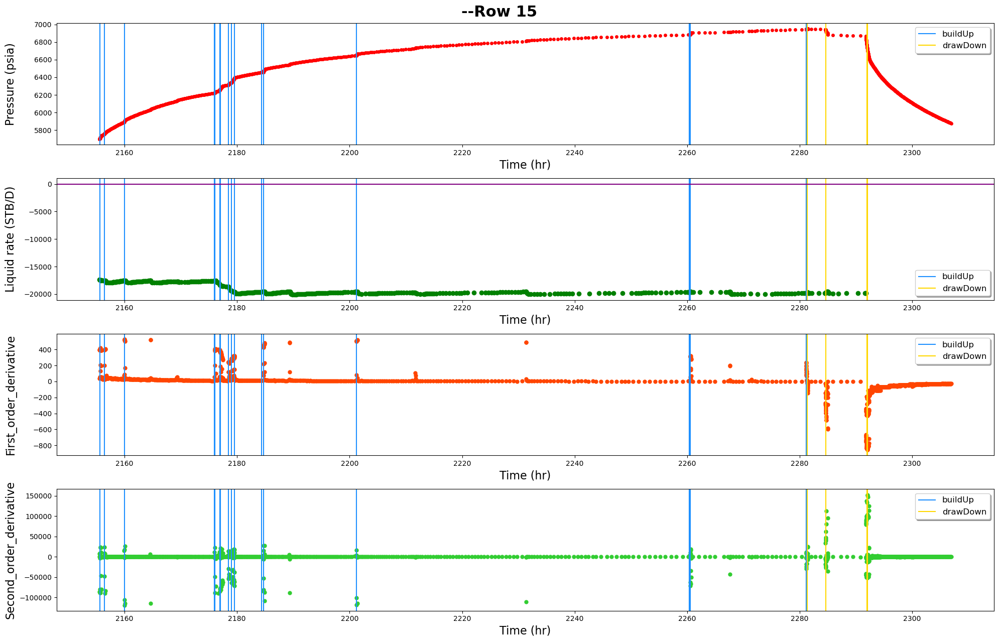

------row 16-----detected points:[18437, 18452, 18486, 18526, 18563, 18593, 18649, 18715, 18722, 18776, 18782, 18818, 18840, 18873, 18918, 18951, 19029, 19037, 19070, 19147, 19151]


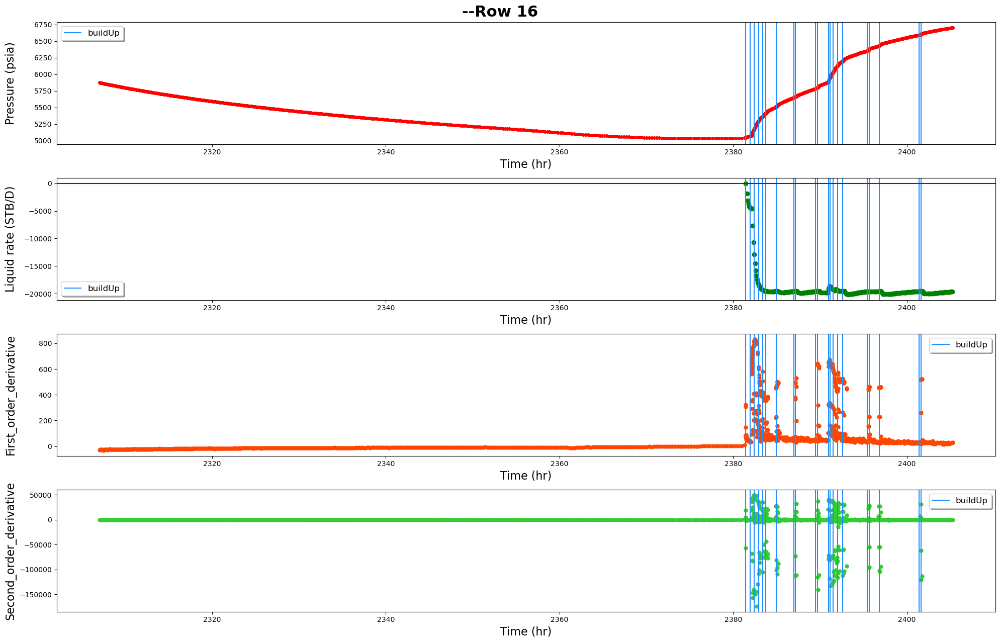

------row 17-----detected points:[19204, 19208, 19459, 19503, 19543, 19560, 19676, 19685, 19762, 19793, 19829, 19864, 19920, 19939, 19979, 19990, 20018, 20071, 20348, 20383]


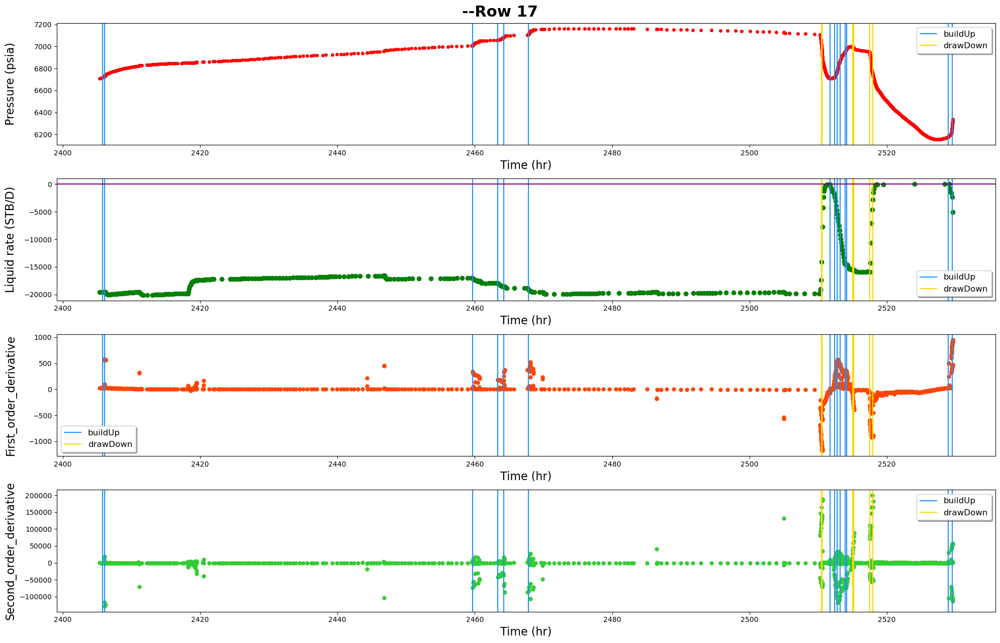

------row 18-----detected points:[20417, 20457, 20505, 20527, 20542, 20722, 20741, 20807, 21065, 21094, 21121, 21184, 21214, 21241, 21301, 21424, 21427, 21440, 21445, 21498, 21525, 21536, 21572, 21589]


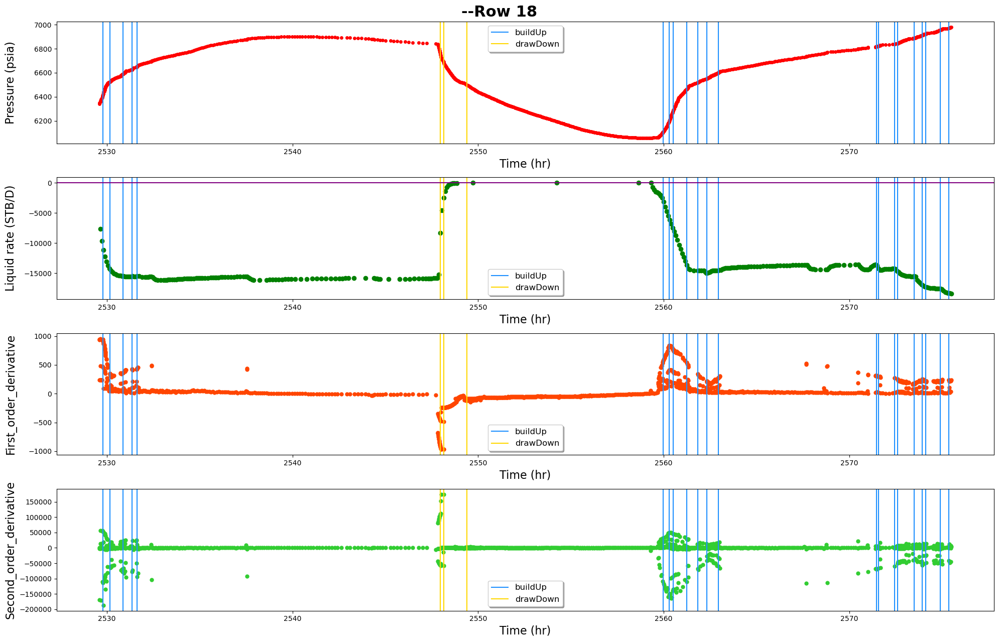

------row 19-----detected points:[21655, 21673, 21695, 21952, 22010, 22083, 22195, 22243, 22275, 22296, 22330, 22355, 22408, 22414, 22457, 22466, 22489, 22496, 22535, 22557, 22621, 22729]


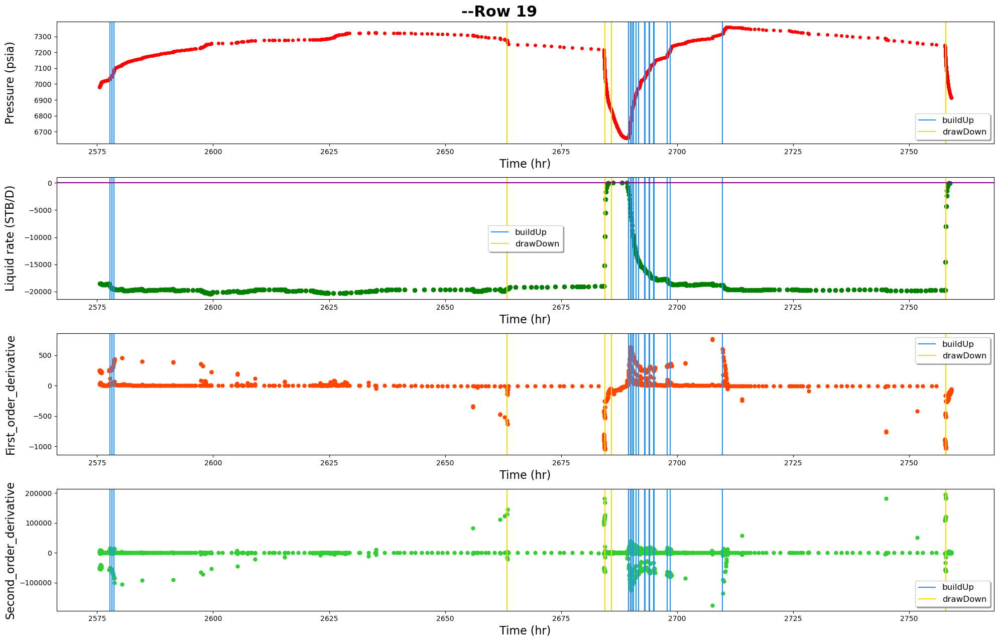

------row 20-----detected points:[22814, 23235, 23245, 23274, 23286, 23332, 23350, 23395, 23456, 23564, 23565, 23639, 23717, 23772, 23790, 23833, 23867, 23924, 23935, 23977, 23981]


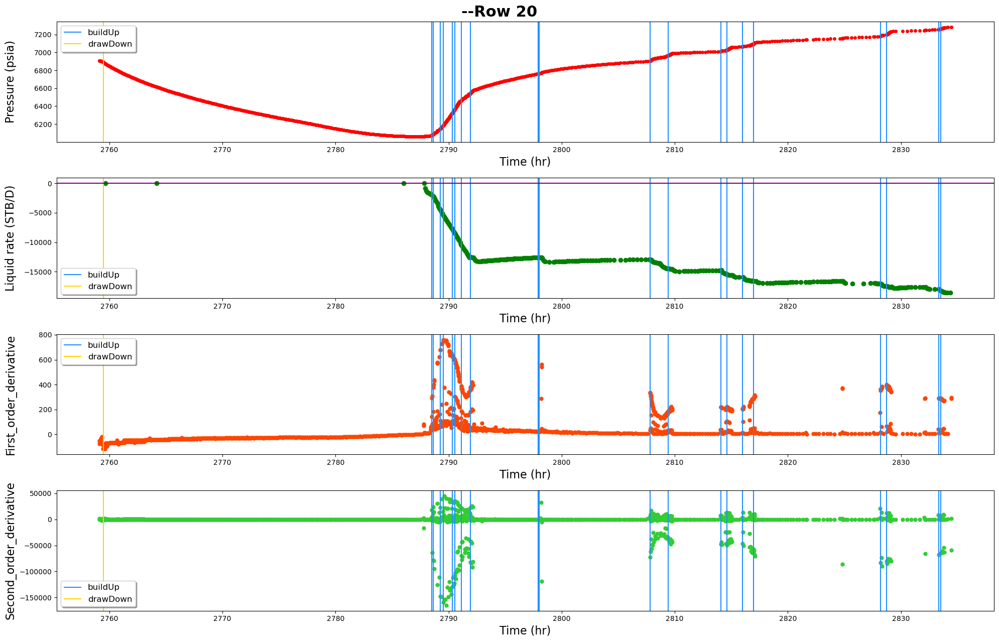

------row 21-----detected points:[24001, 24003, 24021, 24073, 24123, 24161, 24182, 24216, 24224, 24263, 24676, 24696, 24759, 24765, 24858, 24890, 24957, 24989, 25065, 25099, 25198]


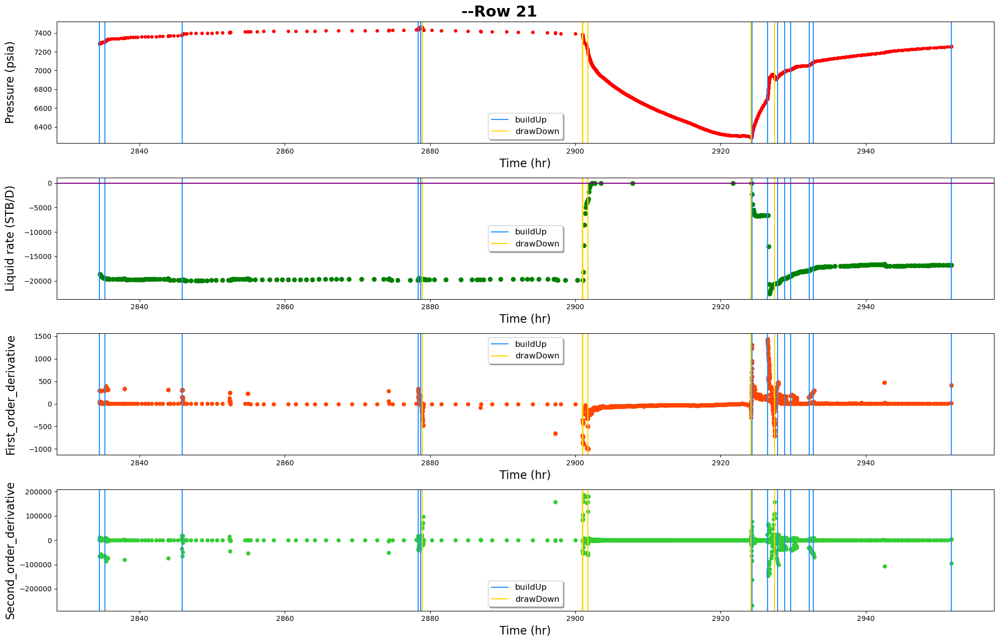

------row 22-----detected points:[25214, 25252, 25272, 25276, 25289, 25296, 25342, 25345, 25617, 25679, 25748, 25760, 25894, 26003, 26032, 26057, 26125, 26138, 26160, 26179, 26205, 26224, 26289, 26335]


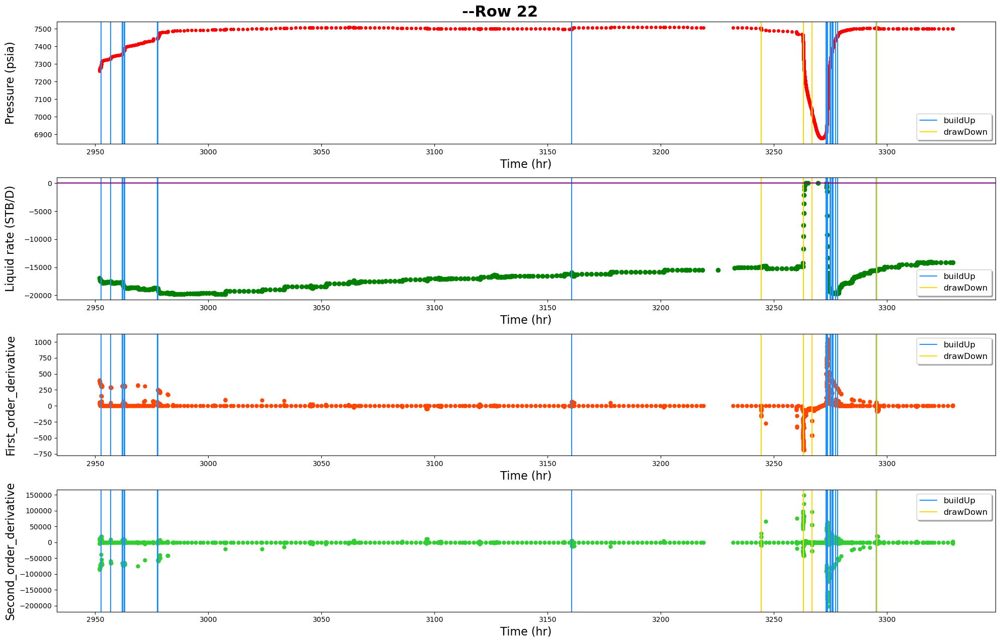

------row 23-----detected points:[26469, 26484, 26507, 26526, 26547, 26662, 26682, 26708, 26711, 26734, 26767, 26779, 26780, 26790, 26798, 26811, 26817, 26836, 26837, 26921, 26983, 27023, 27044, 27336, 27383, 27416, 27445, 27464, 27551, 27569]


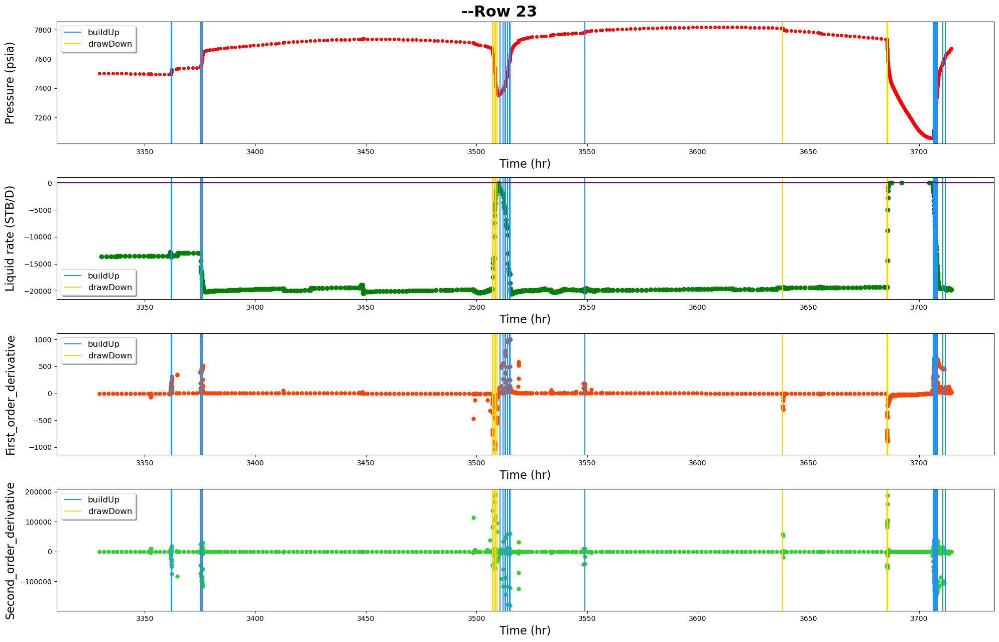

------row 24-----detected points:[27729, 27770, 27803, 27825, 27980, 28013, 28043, 28073, 28138, 28141, 28155, 28227, 28232, 28248, 28266, 28321, 28497, 28546, 28594, 28653, 28657, 28720, 28784]


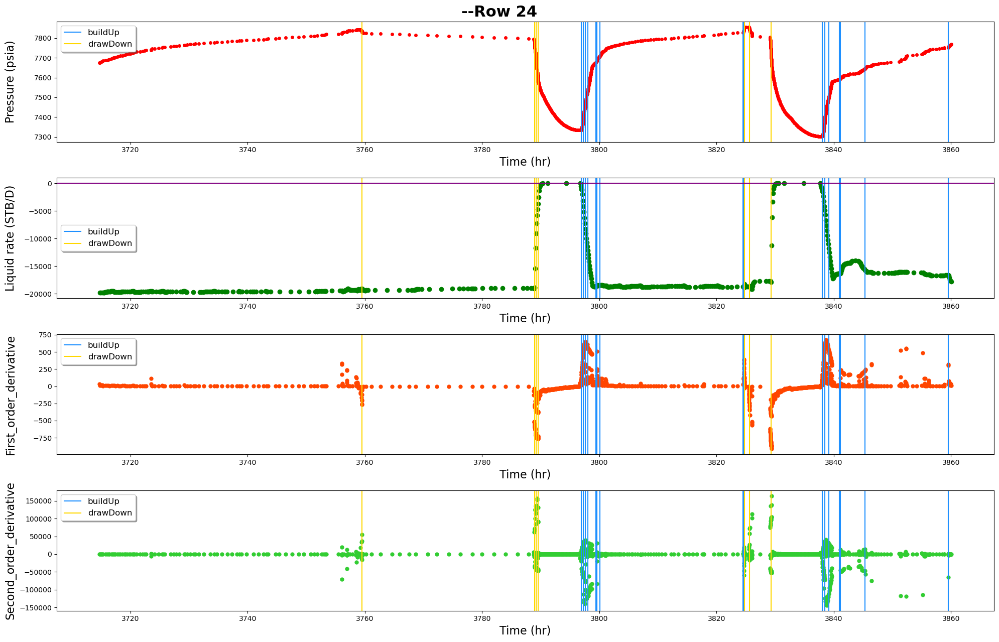

------row 25-----detected points:[28838, 28886, 29113, 29146, 29165, 29181, 29235, 29303, 29318, 29322, 29365, 29394, 29480, 29483, 29540, 29648, 29722, 29784]


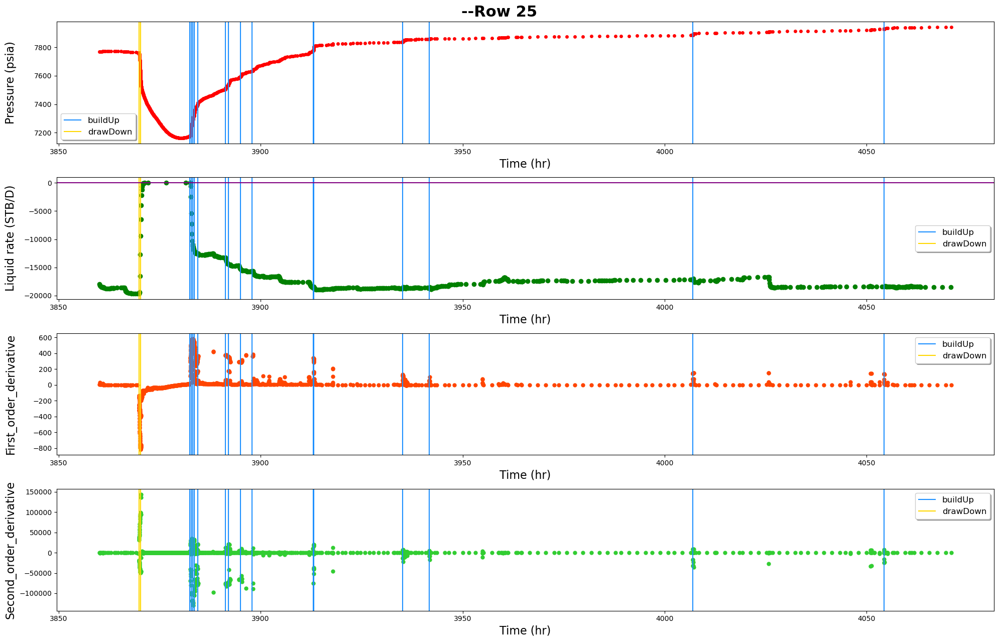

In [10]:
parameters={"polynomialOrder":polynomial_order,
            "deltaTangentThre":deltaTangent_criterion,
            "timeStep":time_step}

detect_points_dict={"buildUp":Max_FOD[0],"drawDown":Max_FOD[1]}
txt=f"buildup:{len(Max_FOD[0])}, drawdown:{len(Max_FOD[1])}"
# pprint(txt)
plot_whole=True
plot_details=True
plot_statistics=False
folder_name=f"deltaTangent_N_MFOD/point_halfWindow_{point_halfWindow}/timeStep_{time_step}"
%run plot_N_save.ipynb

# find major transents

In [3]:
points_buildUp=[43,
 510,
 1035,
 1811,
 2113,
 2515,
 2540,
 2899,
 2947,
 3023,
 3598,
 3628,
 3666,
 3693,
 4260,
 4292,
 4393,
 4944,
 4954,
 5450,
 5477,
 5531,
 6776,
 6870,
 7556,
 7623,
 7690,
 7723,
 7775,
 7816,
 7847,
 8372,
 8414,
 8601,
 8779,
 8874,
 8876,
 9667,
 9726,
 9765,
 10068,
 10261,
 10333,
 10466,
 10818,
 10874,
 10950,
 10974,
 10998,
 11029,
 11091,
 11479,
 11539,
 11541,
 11607,
 11641,
 11672,
 11758,
 12240,
 13043,
 13080,
 13148,
 13195,
 13333,
 13336,
 13419,
 13529,
 13568,
 13601,
 13604,
 13778,
 14094,
 14143,
 14197,
 14275,
 14594,
 14683,
 15356,
 15405,
 15468,
 15576,
 15635,
 15739,
 15755,
 15940,
 15960,
 16009,
 16584,
 16589,
 16626,
 16700,
 16748,
 16805,
 16836,
 16906,
 17064,
 17085,
 17090,
 17156,
 17253,
 17342,
 17467,
 17511,
 18437,
 18486,
 18560,
 18649,
 18782,
 18818,
 18840,
 18918,
 19037,
 19070,
 19150,
 19205,
 19208,
 19459,
 19542,
 19560,
 19829,
 19878,
 19938,
 20347,
 20417,
 20492,
 20527,
 21062,
 21094,
 21184,
 21299,
 21426,
 21445,
 21499,
 21554,
 21589,
 21654,
 21695,
 22243,
 22296,
 22338,
 22408,
 22414,
 22462,
 22529,
 22556,
 22621,
 23238,
 23285,
 23351,
 23395,
 23639,
 23789,
 23851,
 23935,
 23980,
 24021,
 24073,
 24123,
 24696,
 24759,
 24889,
 24985,
 25198,
 25214,
 25294,
 26003,
 26057,
 26125,
 26160,
 26484,
 26526,
 26547,
 26749,
 26779,
 26790,
 26798,
 26817,
 26837,
 27377,
 27416,
 27467,
 27550,
 27979,
 28043,
 28082,
 28140,
 28232,
 28497,
 28543,
 28597,
 28654,
 29130,
 29165,
 29228,
 29318,
 29481,
 29483,
 29540,
 29721,
 29784]
points_drawDown=[2255,
 2812,
 3103,
 4017,
 4762,
 5303,
 5305,
 6019,
 6034,
 7291,
 7984,
 9040,
 10157,
 10565,
 11359,
 12384,
 12463,
 12465,
 13852,
 13907,
 13909,
 14438,
 14477,
 14803,
 16055,
 16067,
 16095,
 16104,
 16199,
 17536,
 17560,
 17628,
 17632,
 19684,
 19979,
 19985,
 20071,
 20722,
 20803,
 21952,
 22010,
 22728,
 22814,
 24181,
 24216,
 24263,
 24676,
 24858,
 25679,
 25698,
 25744,
 25894,
 26340,
 26353,
 26682,
 26708,
 26733,
 27038,
 27725,
 27767,
 27825,
 28248,
 28266,
 28313,
 28838,
 28880]

In [3]:
points_buildUp=[32,
 43,
 79,
 287,
 434,
 514,
 606,
 607,
 696,
 820,
 841,
 911,
 1035,
 1358,
 1440,
 1814,
 1839,
 2113,
 2477,
 2515,
 2540,
 2661,
 2900,
 2943,
 3023,
 3599,
 3628,
 3666,
 3693,
 3723,
 3903,
 4229,
 4262,
 4293,
 4393,
 4493,
 4899,
 4949,
 4955,
 5387,
 5466,
 5498,
 5528,
 5834,
 5946,
 6544,
 6579,
 6598,
 6791,
 6872,
 7038,
 7137,
 7556,
 7621,
 7623,
 7647,
 7688,
 7691,
 7723,
 7775,
 7816,
 7849,
 8372,
 8417,
 8426,
 8601,
 8628,
 8662,
 8786,
 8874,
 8895,
 9667,
 9726,
 9766,
 10069,
 10238,
 10262,
 10343,
 10466,
 10818,
 10871,
 10874,
 10946,
 10953,
 10974,
 10996,
 11029,
 11091,
 11480,
 11539,
 11554,
 11607,
 11641,
 11672,
 11780,
 12240,
 13043,
 13104,
 13150,
 13196,
 13270,
 13332,
 13336,
 13398,
 13401,
 13529,
 13548,
 13601,
 13606,
 13667,
 13778,
 14094,
 14143,
 14197,
 14277,
 14601,
 14625,
 14686,
 15345,
 15356,
 15405,
 15468,
 15576,
 15639,
 15660,
 15741,
 15756,
 15870,
 15940,
 15961,
 16009,
 16583,
 16589,
 16626,
 16669,
 16764,
 16805,
 16837,
 16908,
 17064,
 17066,
 17091,
 17158,
 17193,
 17253,
 17340,
 17342,
 17467,
 17511,
 18437,
 18486,
 18563,
 18649,
 18715,
 18722,
 18782,
 18818,
 18840,
 18918,
 19037,
 19070,
 19151,
 19204,
 19208,
 19459,
 19503,
 19543,
 19560,
 19758,
 19829,
 19864,
 19939,
 20348,
 20417,
 20505,
 20542,
 21065,
 21094,
 21184,
 21301,
 21424,
 21440,
 21525,
 21572,
 21589,
 21655,
 21695,
 22243,
 22275,
 22330,
 22408,
 22457,
 22466,
 22496,
 22535,
 22557,
 22621,
 23245,
 23286,
 23332,
 23395,
 23564,
 23565,
 23639,
 23717,
 23772,
 23833,
 23867,
 23922,
 23935,
 23981,
 24001,
 24021,
 24073,
 24123,
 24696,
 24759,
 24890,
 24957,
 24989,
 25065,
 25198,
 25214,
 25252,
 25272,
 25276,
 25296,
 25345,
 25617,
 26003,
 26057,
 26125,
 26138,
 26179,
 26205,
 26224,
 26289,
 26469,
 26484,
 26526,
 26547,
 26749,
 26767,
 26779,
 26780,
 26798,
 26817,
 26837,
 26921,
 27383,
 27416,
 27464,
 27551,
 27569,
 27980,
 28043,
 28073,
 28141,
 28155,
 28232,
 28497,
 28546,
 28594,
 28653,
 28657,
 28720,
 28784,
 29146,
 29165,
 29235,
 29303,
 29322,
 29365,
 29394,
 29480,
 29483,
 29540,
 29648,
 29722,
 29784]
points_drawDown=[2257,
 2349,
 2812,
 3094,
 3103,
 3197,
 4017,
 4042,
 4763,
 5303,
 5305,
 5396,
 5698,
 6020,
 6034,
 7291,
 7984,
 8005,
 9040,
 9125,
 10157,
 10490,
 10565,
 11338,
 11378,
 12391,
 12463,
 12466,
 13827,
 13852,
 13907,
 13909,
 13987,
 14444,
 14478,
 14806,
 14876,
 14884,
 16055,
 16069,
 16095,
 16120,
 16203,
 17537,
 17560,
 17628,
 17632,
 19685,
 19979,
 19990,
 20009,
 20071,
 20722,
 20741,
 20807,
 21951,
 21952,
 22010,
 22083,
 22650,
 22729,
 22814,
 24182,
 24216,
 24263,
 24669,
 24676,
 24858,
 25495,
 25679,
 25698,
 25748,
 25760,
 25894,
 26340,
 26351,
 26412,
 26682,
 26708,
 26734,
 26983,
 27021,
 27044,
 27729,
 27770,
 27825,
 28248,
 28266,
 28321,
 28838,
 28886]

In [ ]:
print("len(Max_FOD[0]),len(Max_FOD[1])",len(Max_FOD[0]),len(Max_FOD[1]))

====detected_shutIns 34
====filtered_shutIns 31
====len(flowingPeriods) 32
====finally detect buildUp:142,drawDown:31
'buildup:32, drawdown:31'
---initializing...
---plotting...


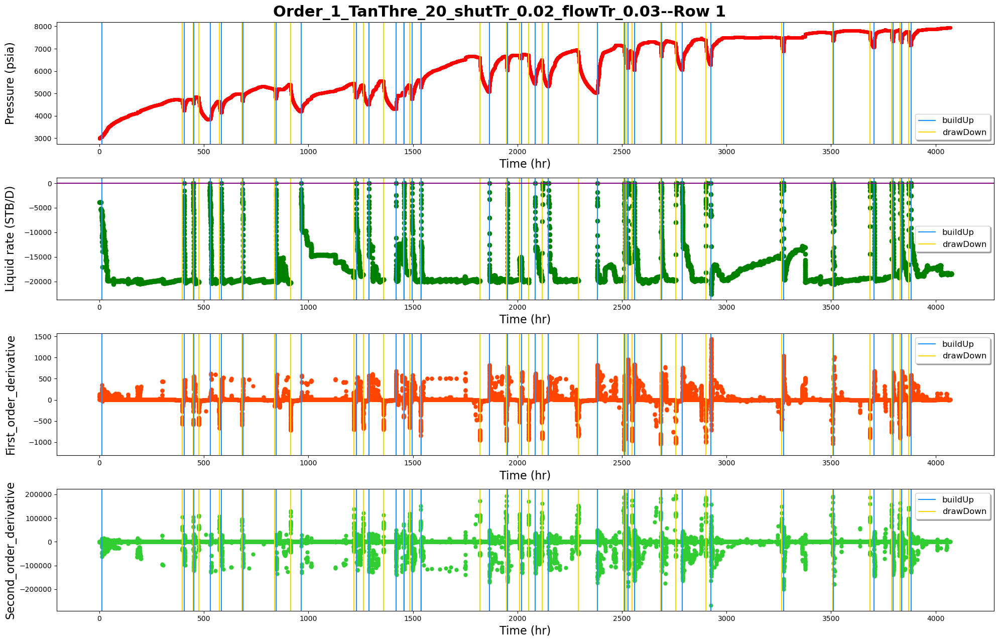

detected 63 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[32]


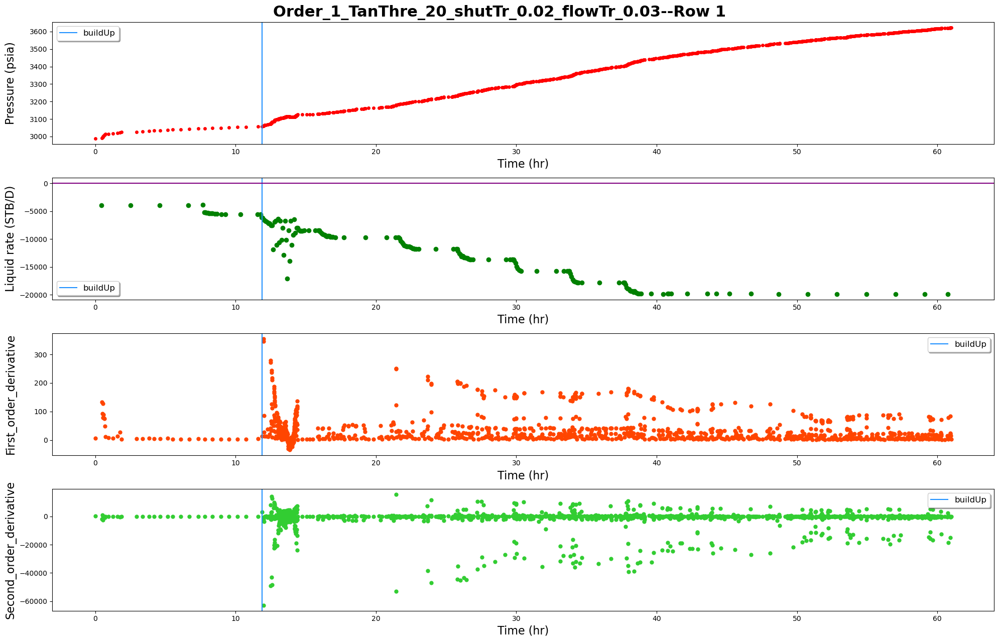

------row 2-----detected points:[2257]


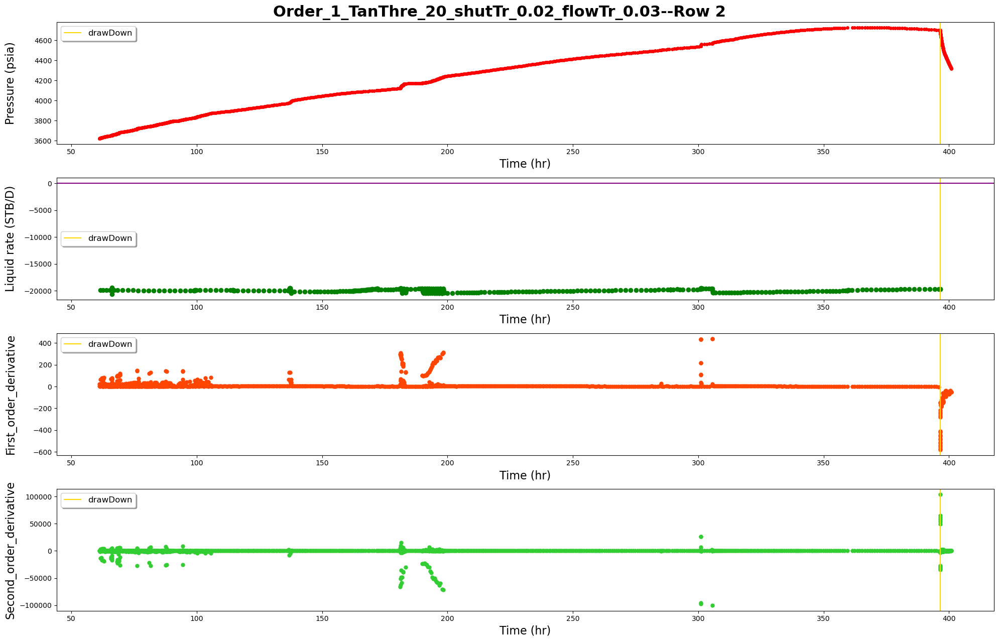

------row 3-----detected points:[2477, 2812, 2892, 3103, 3596]


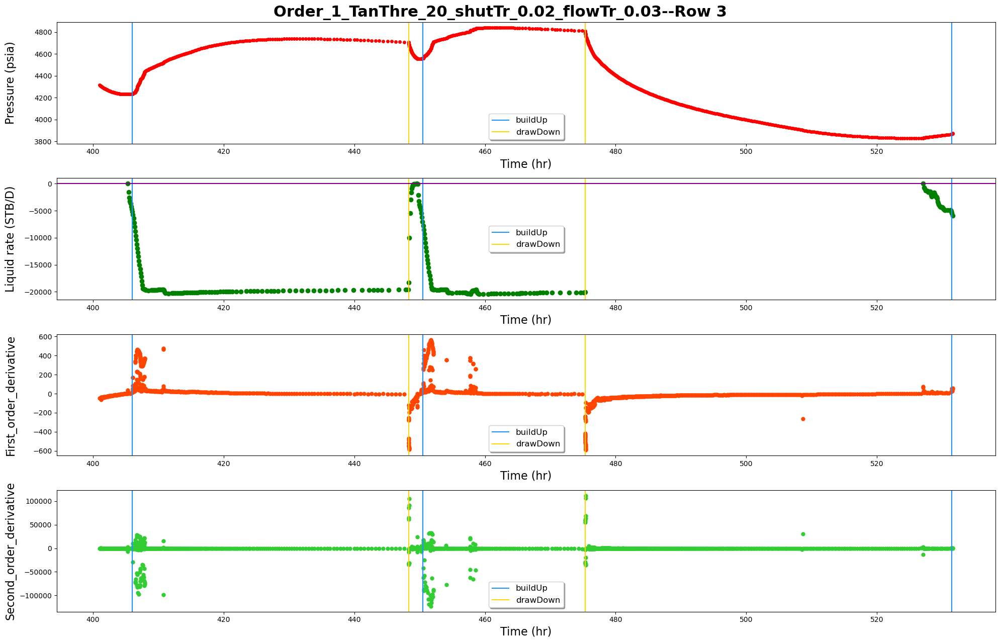

------row 4-----detected points:[4017, 4229, 4763]


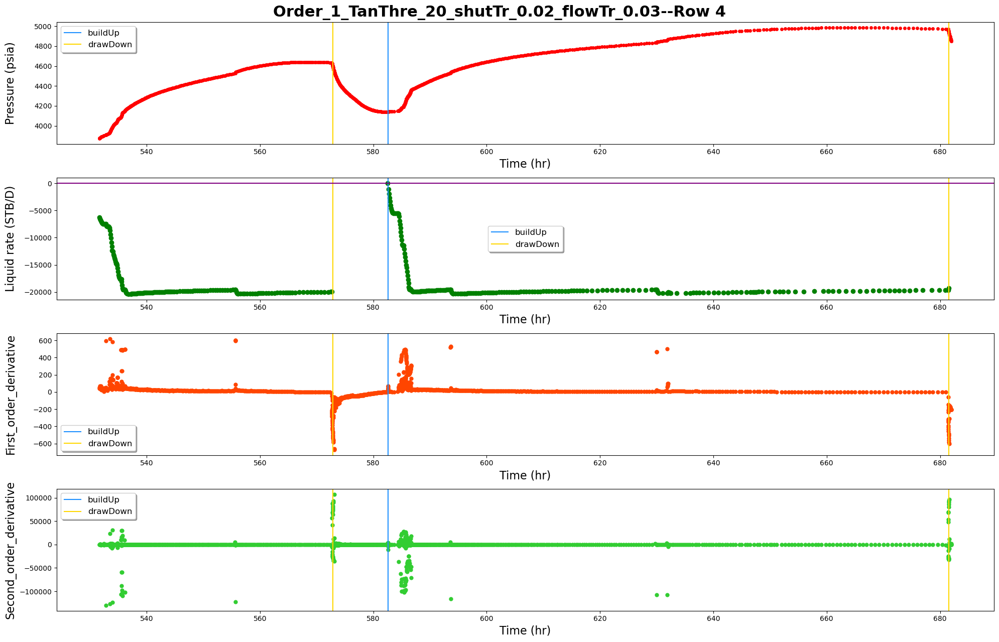

------row 5-----detected points:[4899, 5305, 5466]


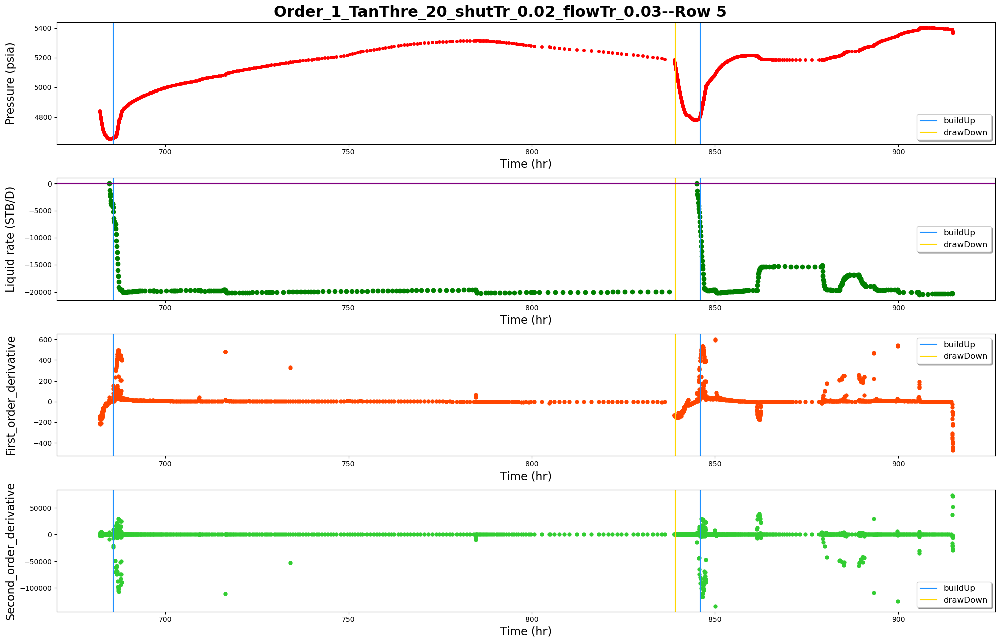

------row 6-----detected points:[6034, 6544]


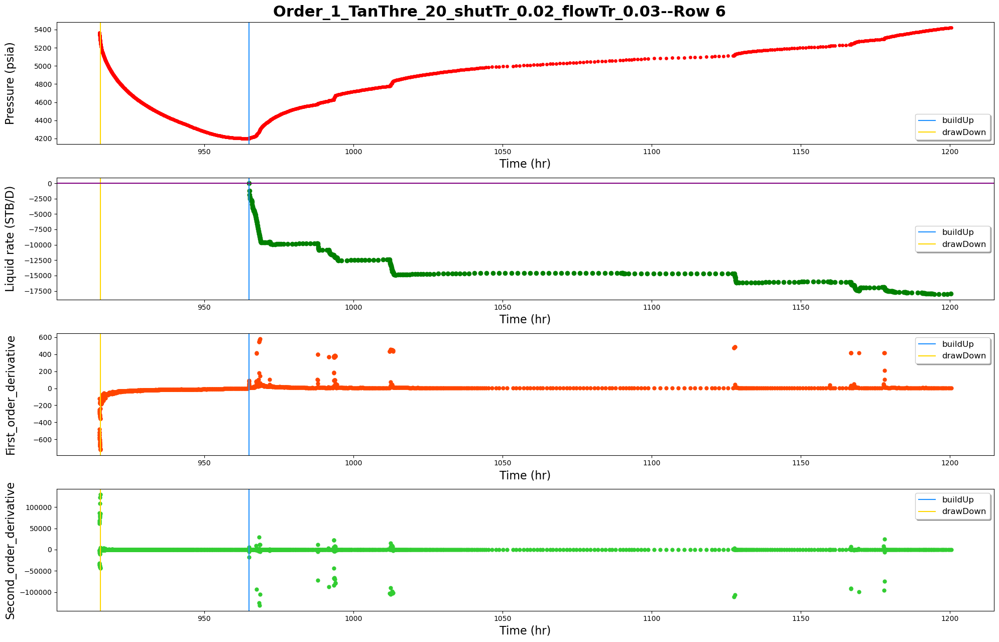

------row 7-----detected points:[7291, 7556, 7984, 8372]


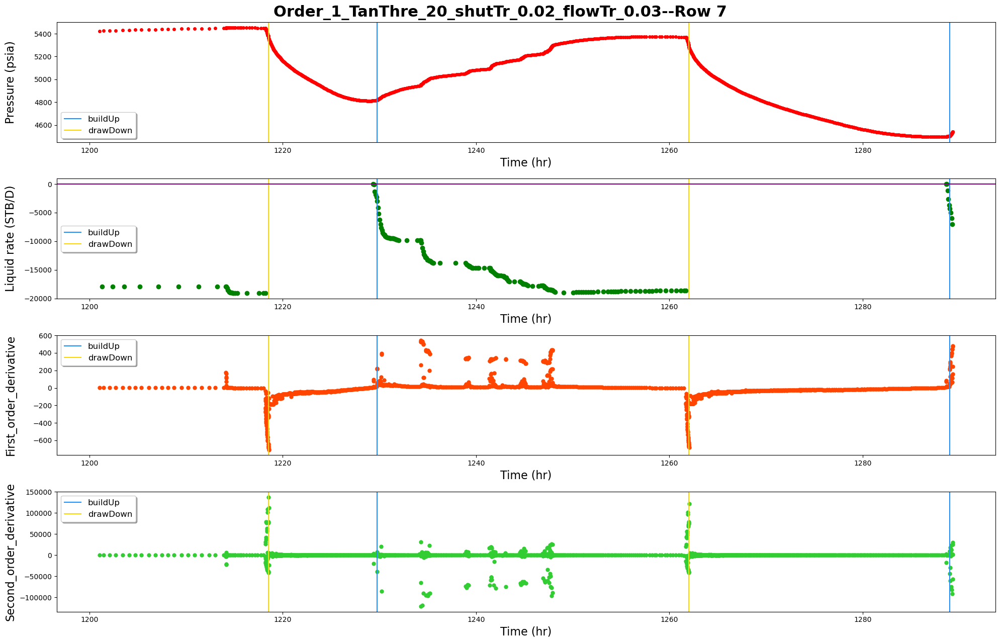

------row 8-----detected points:[9040]


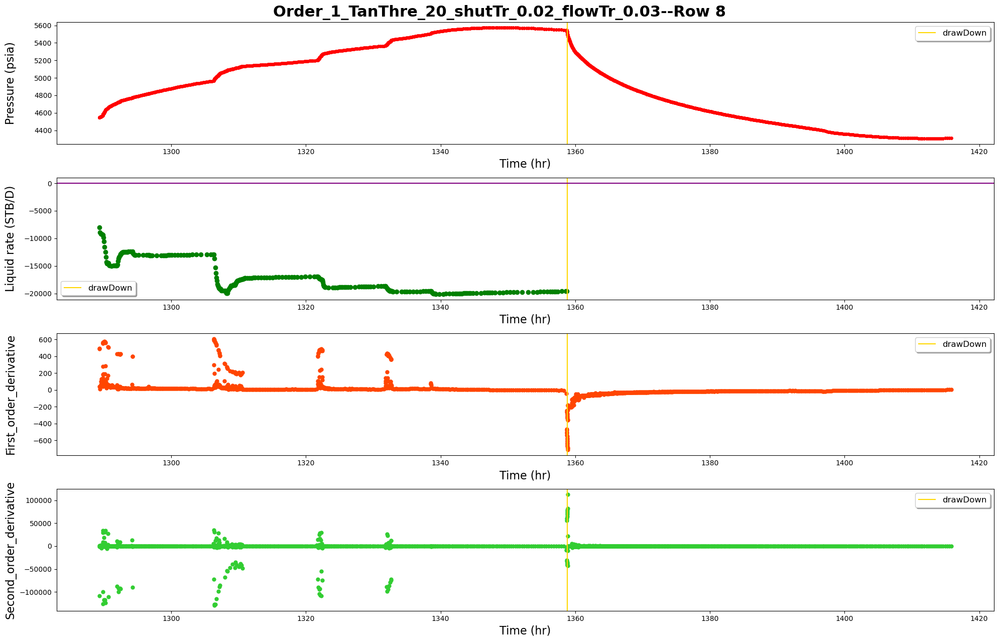

------row 9-----detected points:[9626, 10157, 10238, 10565]


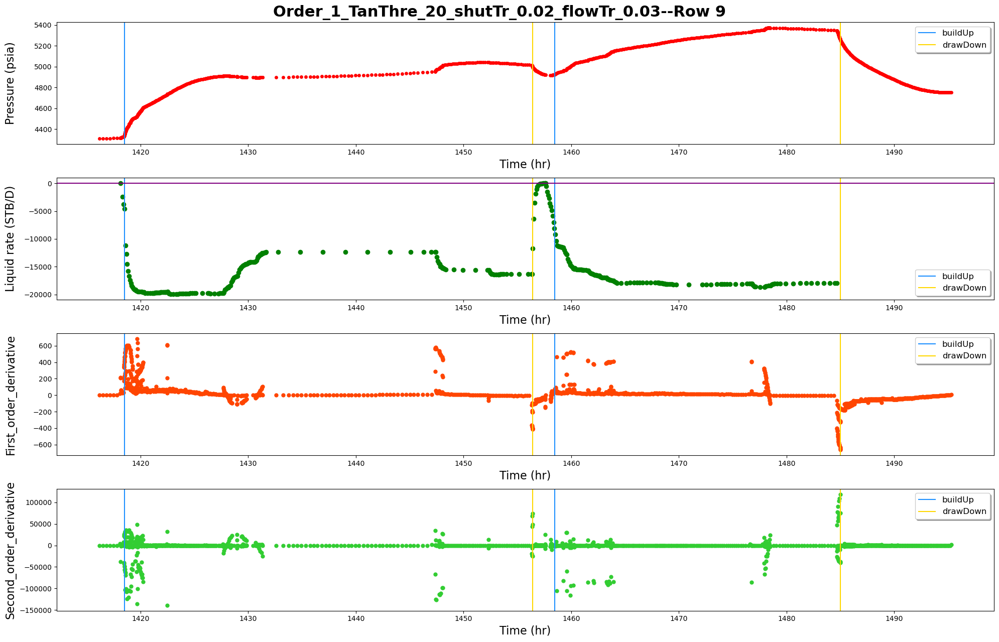

------row 10-----detected points:[10801, 11378, 11480]


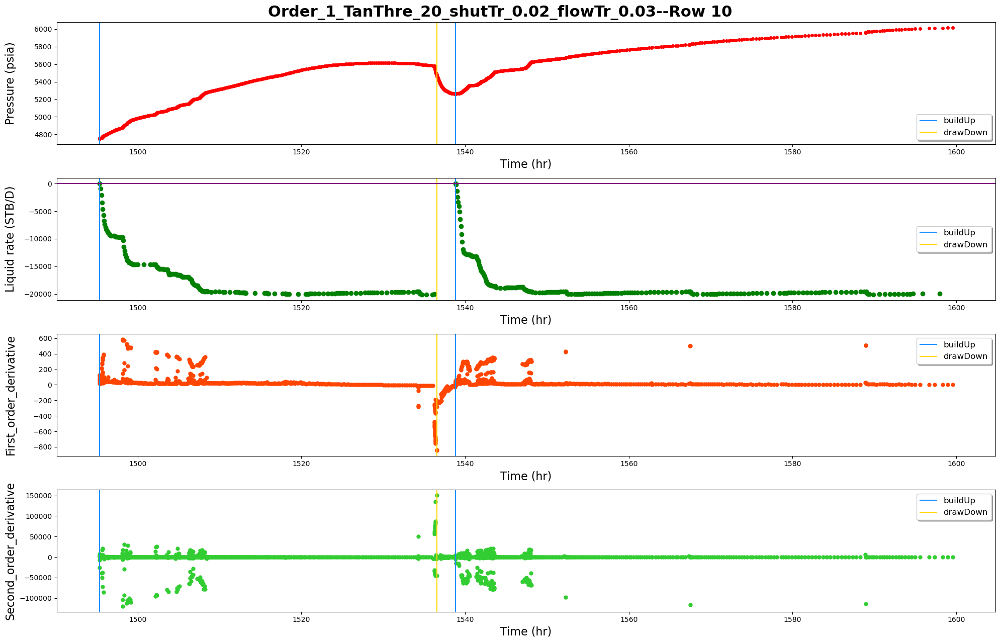

------row 11-----detected points:[12391, 13043]


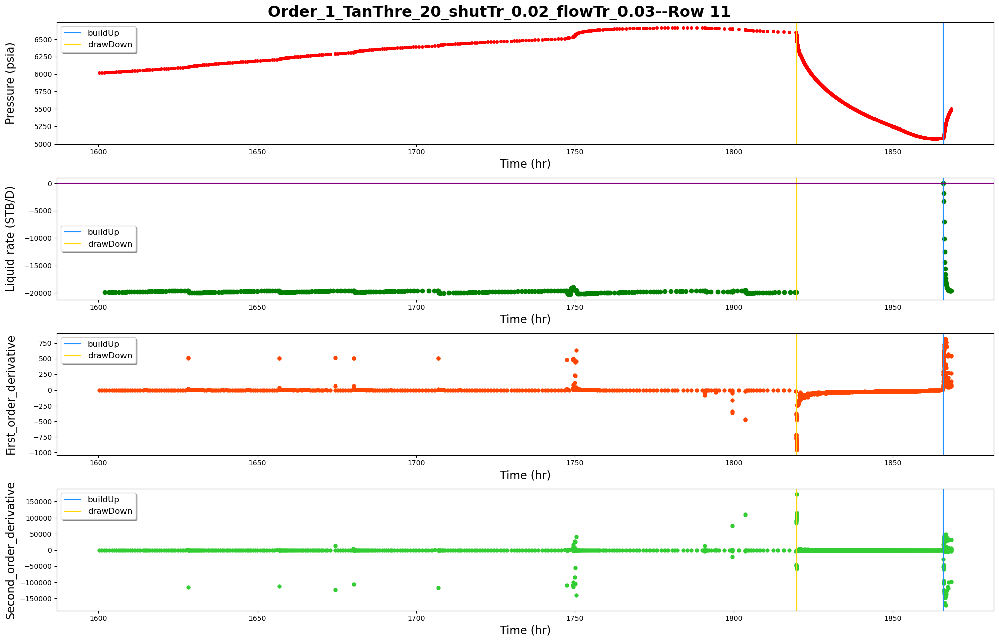

------row 12-----detected points:[13909, 14094]


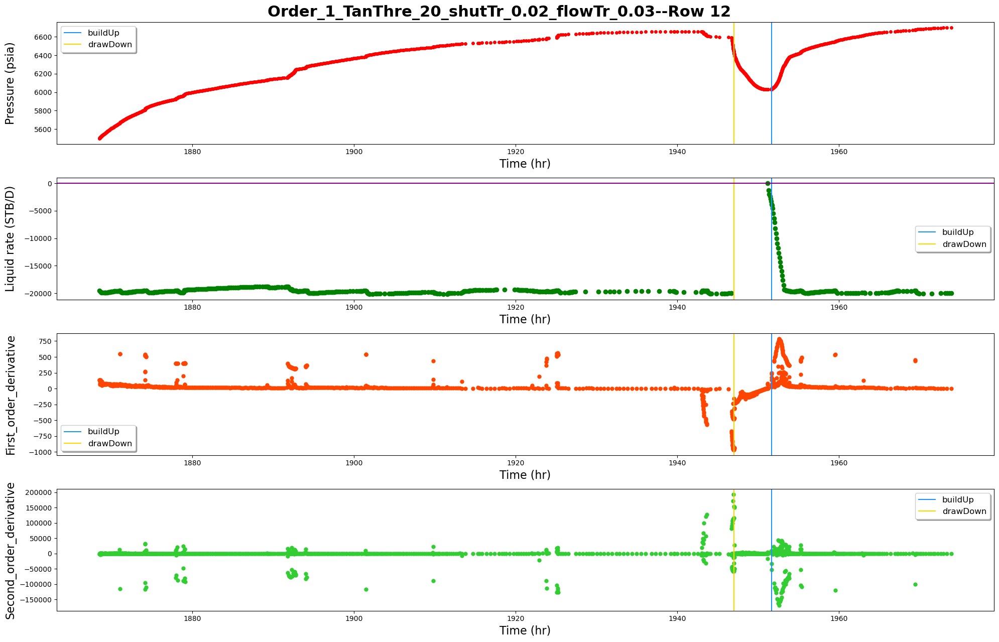

------row 13-----detected points:[14478, 14590, 14806, 15345]


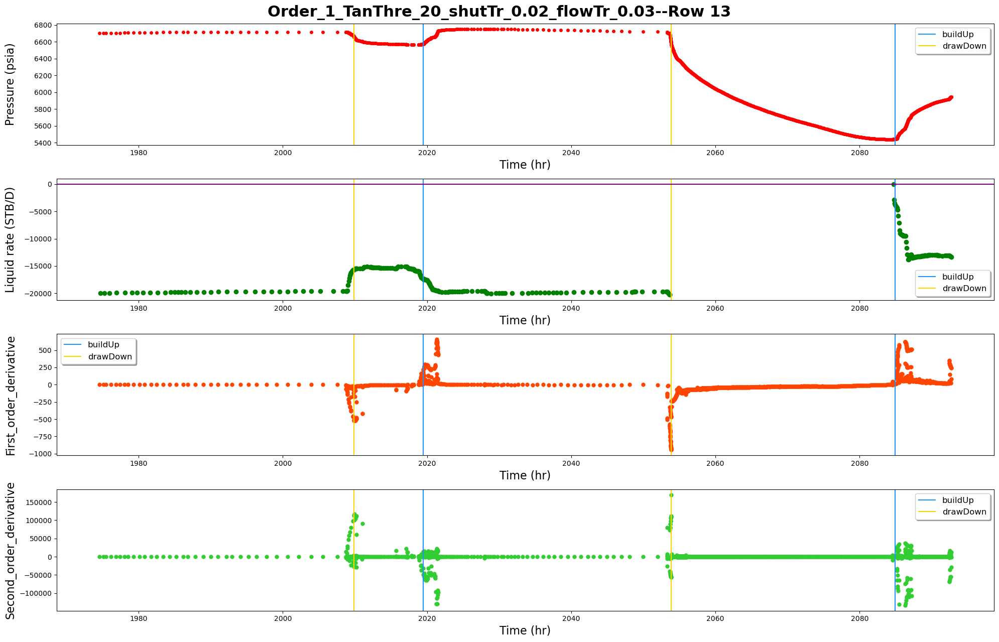

------row 14-----detected points:[16120, 16583]


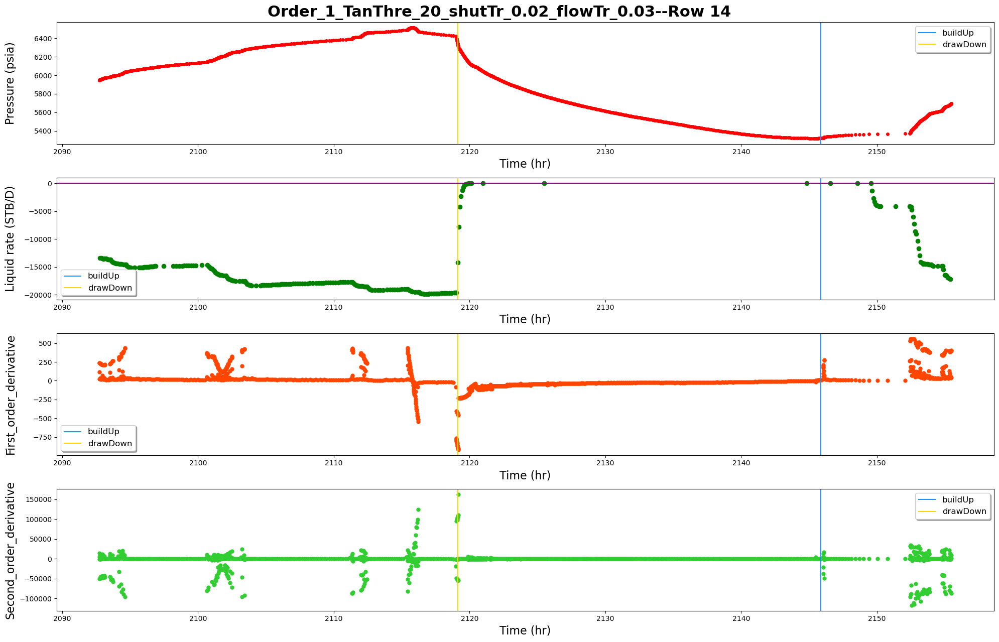

------row 15-----detected points:[17632]


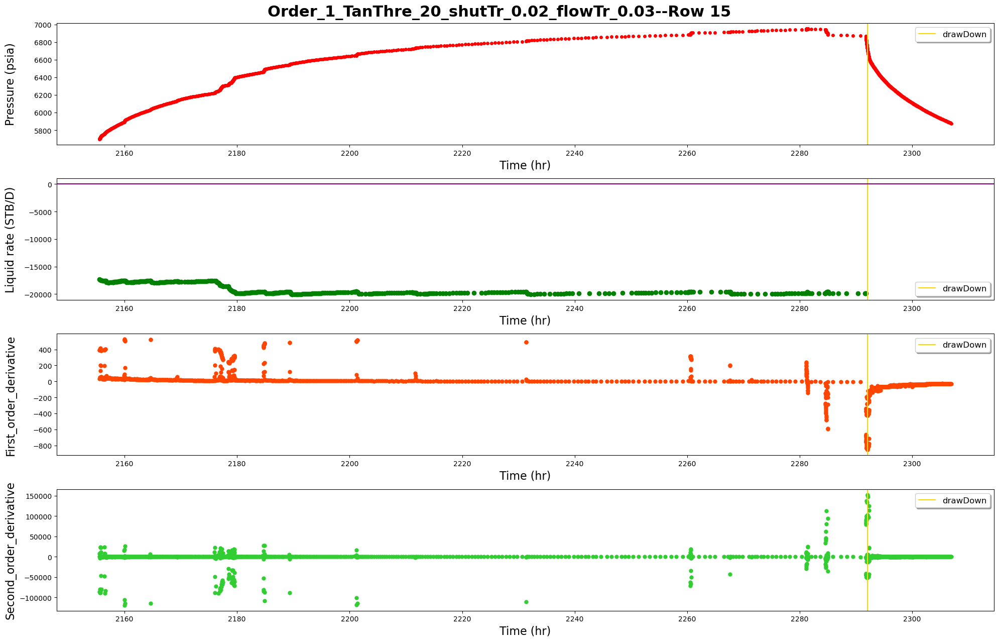

------row 16-----detected points:[18437]


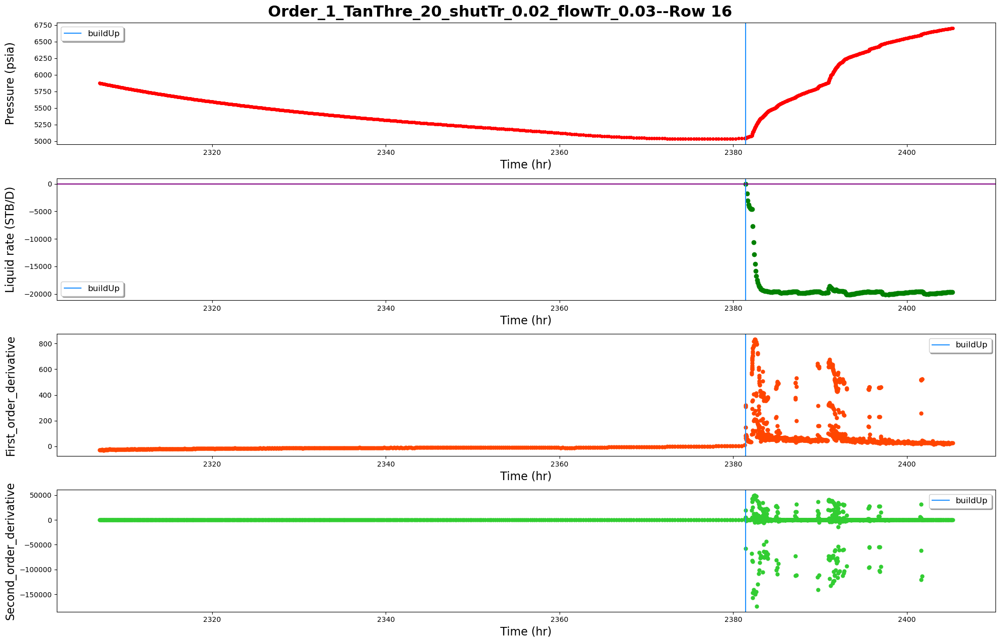

------row 17-----detected points:[19685, 19762, 20071, 20348]


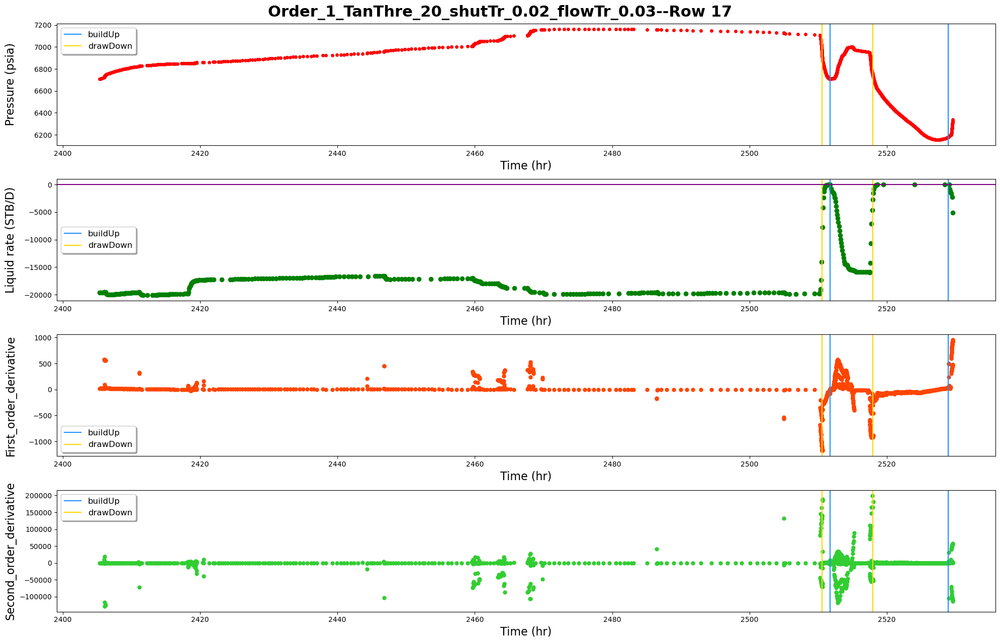

------row 18-----detected points:[20722, 21065]


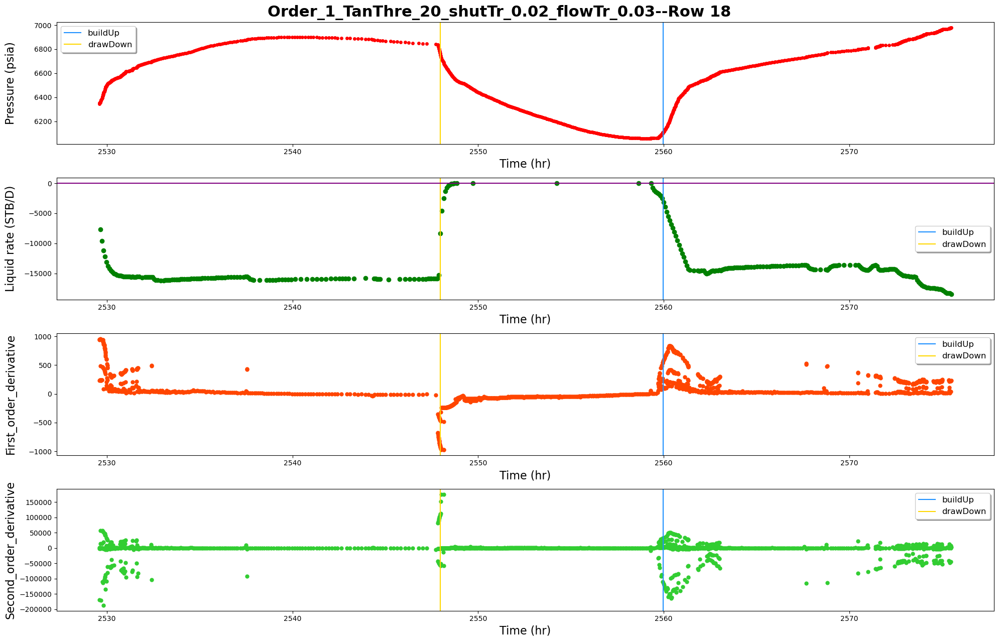

------row 19-----detected points:[22010, 22195, 22729]


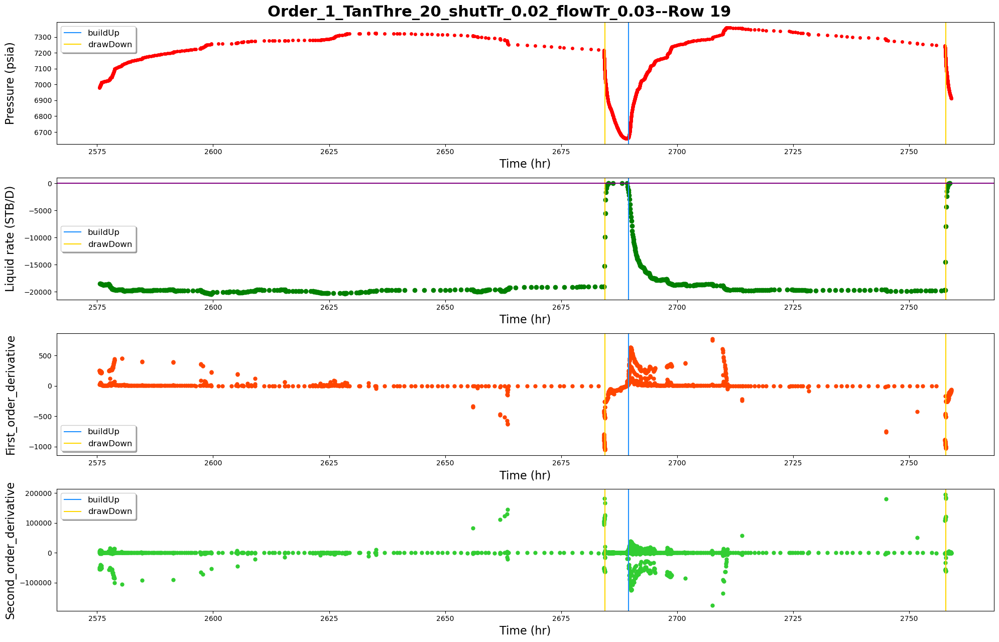

------row 20-----detected points:[23235]


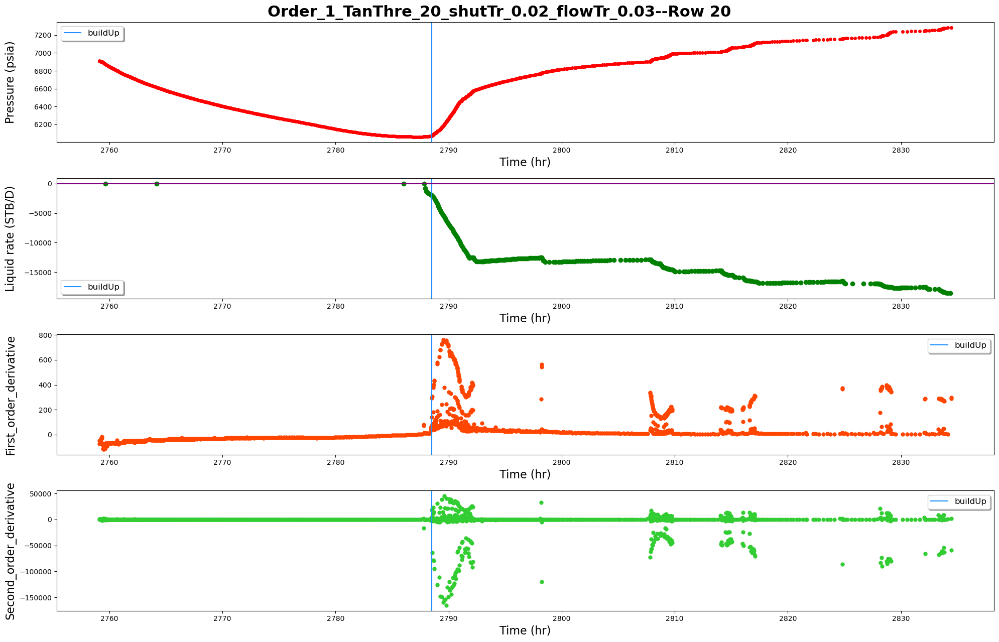

------row 21-----detected points:[24263, 24696]


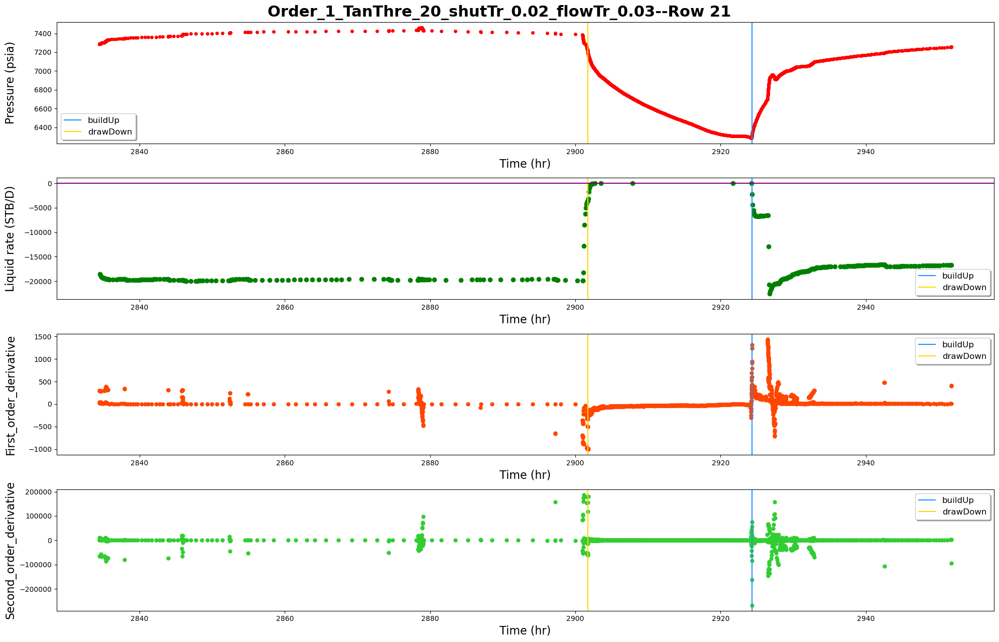

------row 22-----detected points:[25760, 26003]


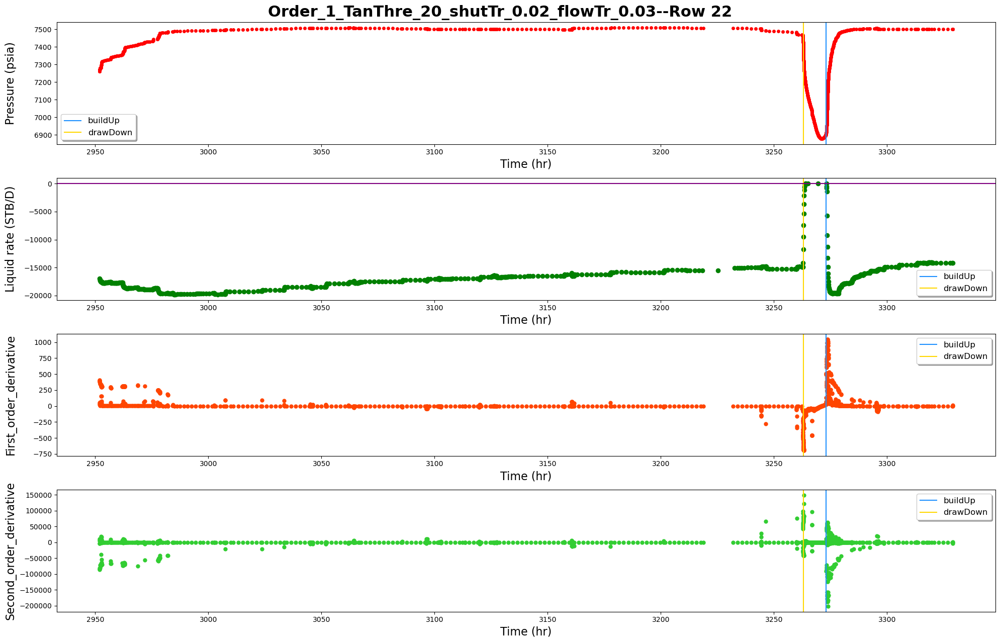

------row 23-----detected points:[26708, 26767, 27044, 27336]


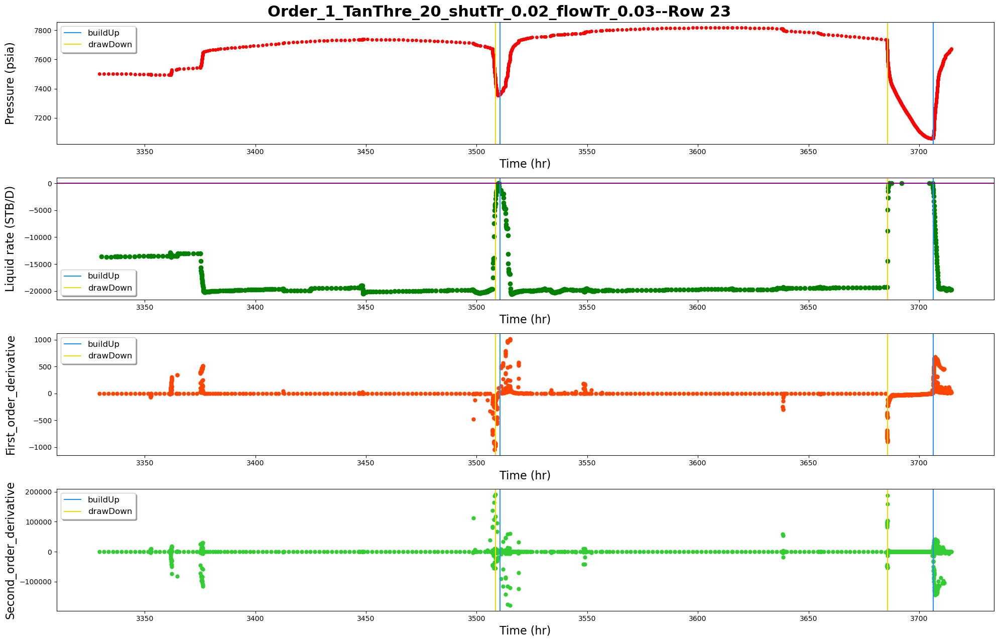

------row 24-----detected points:[27825, 27980, 28321, 28497]


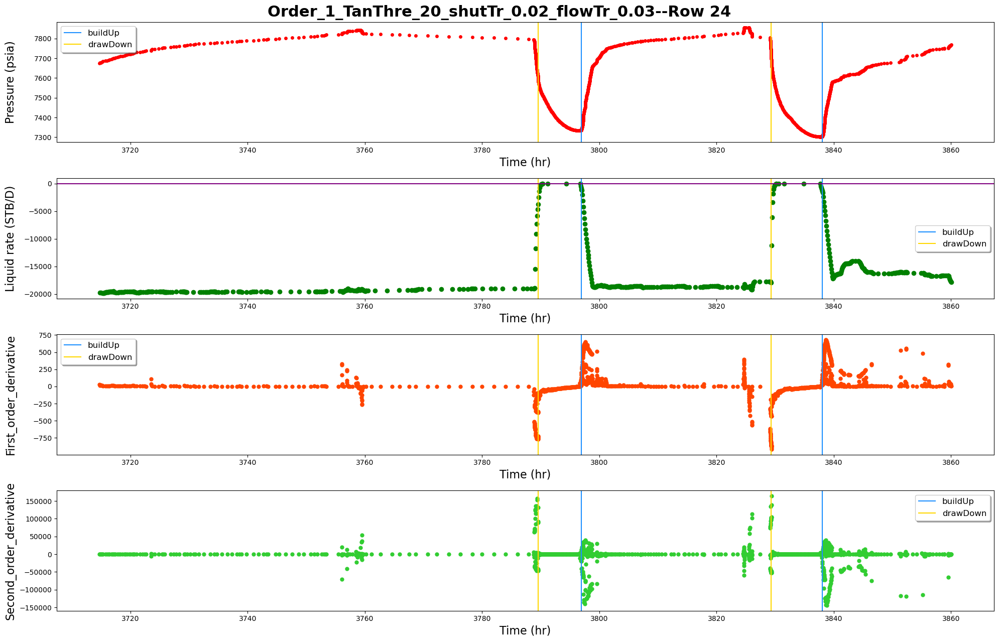

------row 25-----detected points:[28886, 29113]


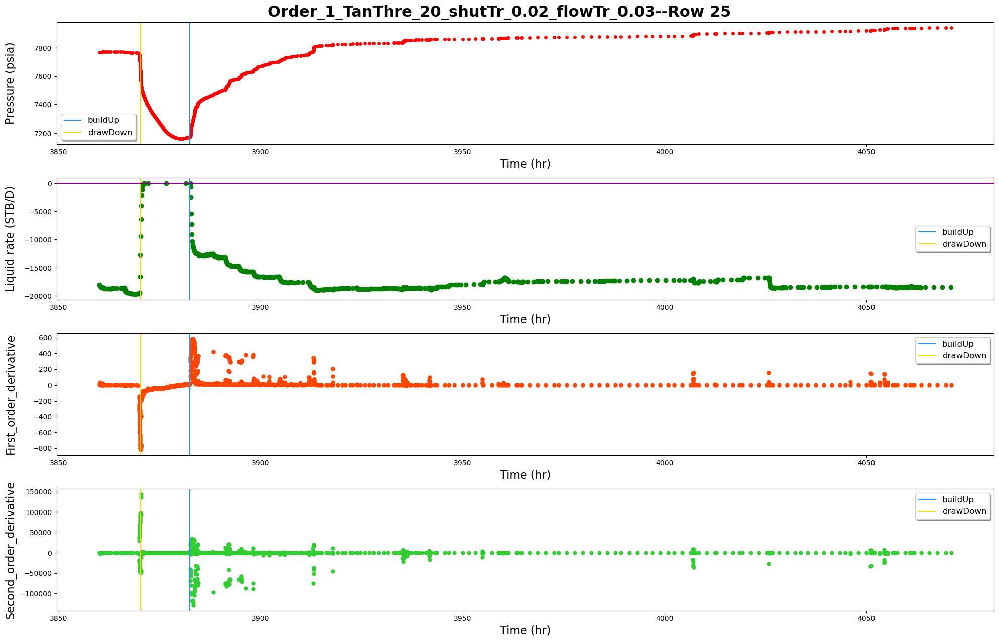

In [28]:
mode="Derivative"
points_buildUp=Max_FOD[0]
points_drawDown=Max_FOD[1]
# points_buildUp=First_FOD[0]
# points_drawDown=First_FOD[1]
mode="Derivative"
minor_threshold_shutIn=0.020
minor_threshold_Flowing=0.03
transients=StoreTransients(pressure_df,
                           minor_threshold_shutIn,
                           minor_threshold_Flowing,
                           points_buildUp,
                           points_drawDown,
                           colum_names,
                           mode)

parameters={"Order":polynomial_order,
            "TanThre":deltaTangent_criterion,
            "shutTr":minor_threshold_shutIn,
           "flowTr":minor_threshold_Flowing}
detect_points_dict={"buildUp":transients.major_buildUp,
                   "drawDown":transients.major_drawDown}

buildup=detect_points_dict["buildUp"]
drawdown=detect_points_dict["drawDown"]
txt=f"buildup:{len(buildup)}, drawdown:{len(drawdown)}"
pprint(txt)
plot_whole=True
plot_details=True
plot_statistics=False
save=False
folder_name=f"good/{mode}_major_transients/point_halfWindow_{point_halfWindow}/timeStep_{time_step}"
# folder_name="removed_transients"
%run plot_N_save.ipynb

In [13]:
mode="Derivative"
# points_buildUp=Max_FOD[0]
# points_drawDown=Max_FOD[1]
points_buildUp=First_FOD[0]
points_drawDown=First_FOD[1]
mode="Derivative"
minor_threshold_shutIn=0.020
minor_threshold_Flowing=0.03
transients=StoreTransients(pressure_df,
                           minor_threshold_shutIn,
                           minor_threshold_Flowing,
                           points_buildUp,
                           points_drawDown,
                           colum_names,
                           mode)

====detected_shutIns 34
====filtered_shutIns 31
====len(flowingPeriods) 32
====finally detect buildUp:143,drawDown:31


'buildup:32, drawdown:31'
---initializing...
---plotting...


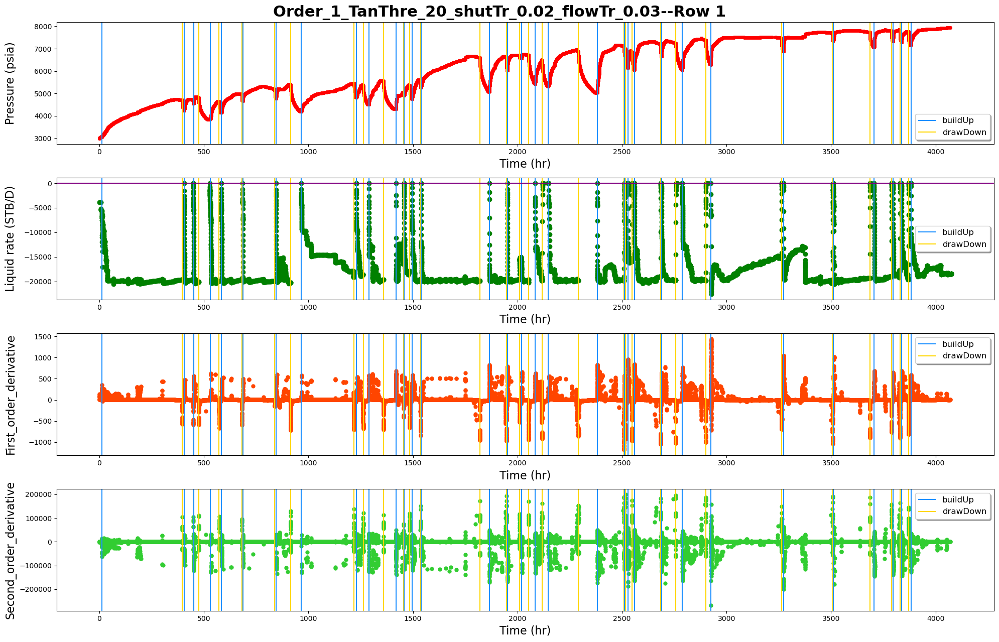

save whole....
detected 63 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[32]


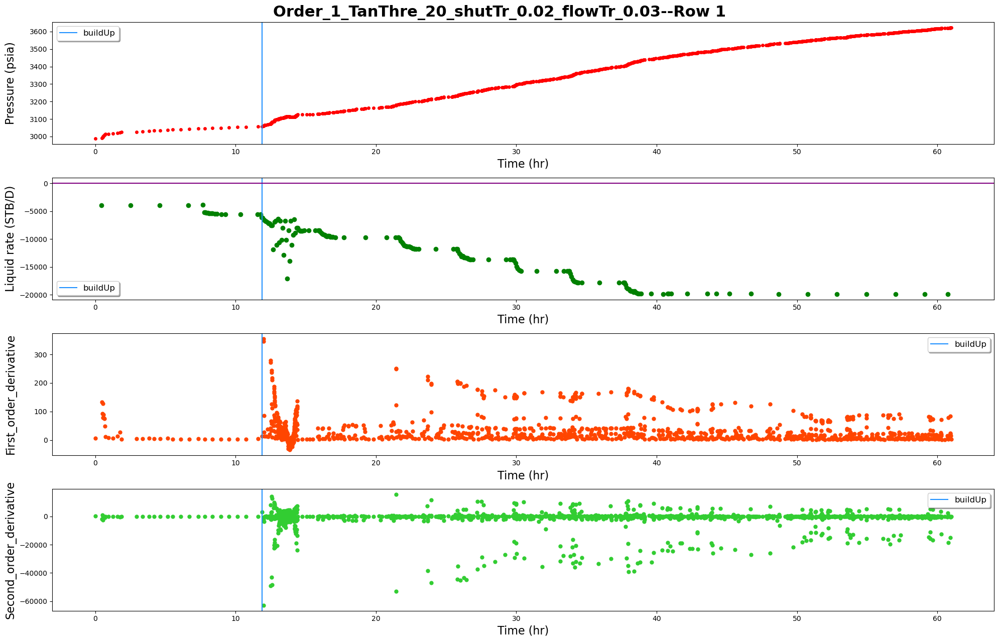

------row 2-----detected points:[2248]


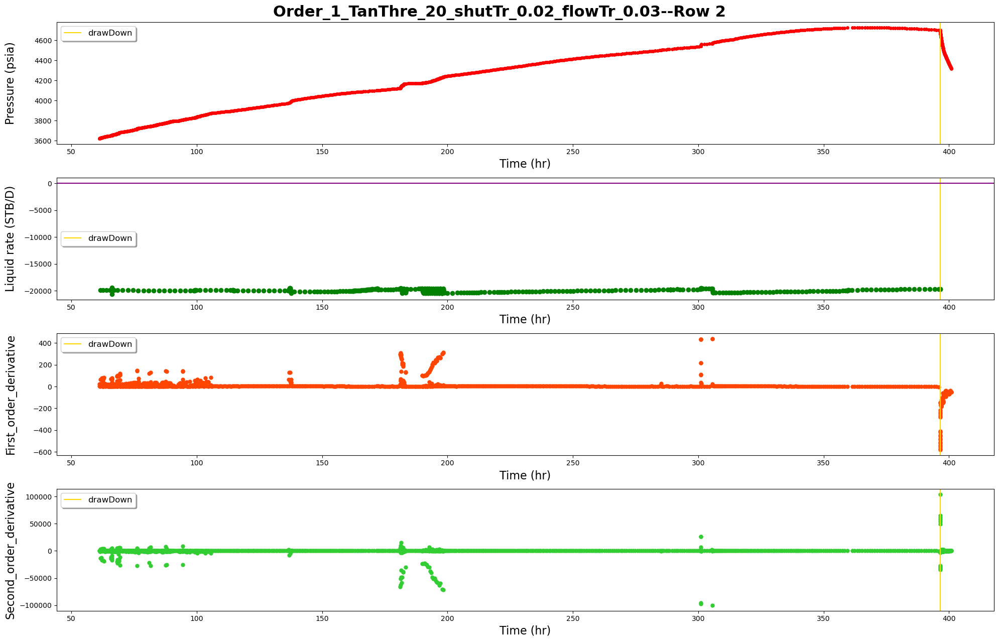

------row 3-----detected points:[2477, 2804, 2891, 3095, 3594]


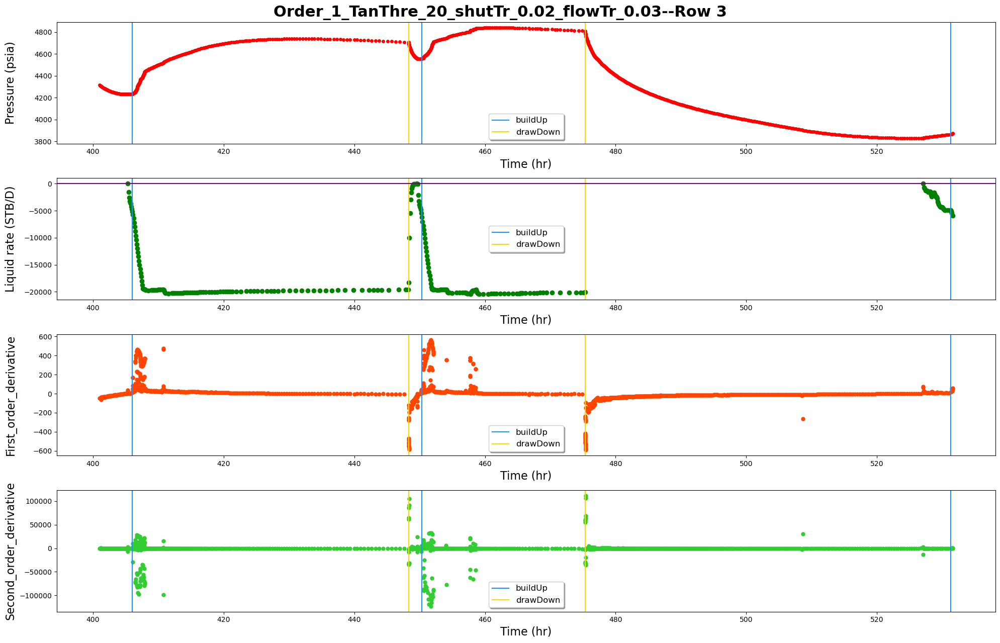

------row 4-----detected points:[3988, 4228, 4750]


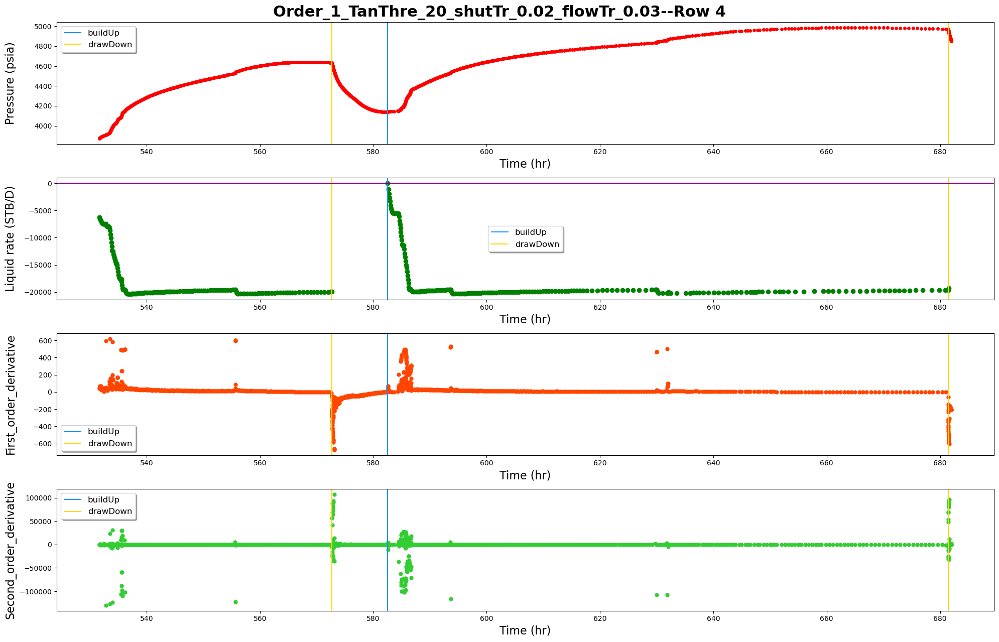

------row 5-----detected points:[4899, 5304, 5445, 5985]


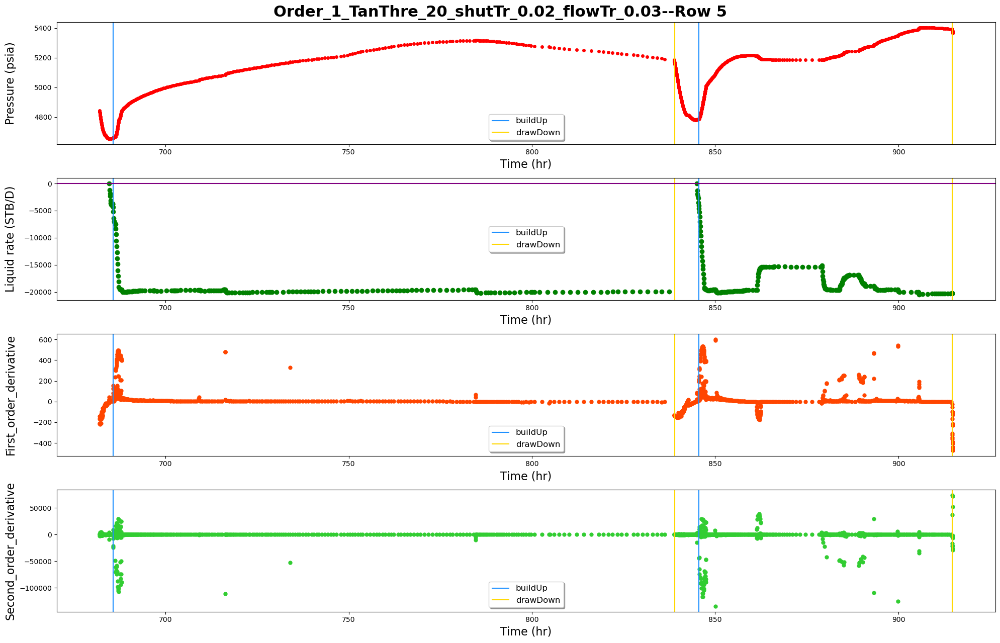

------row 6-----detected points:[6543]


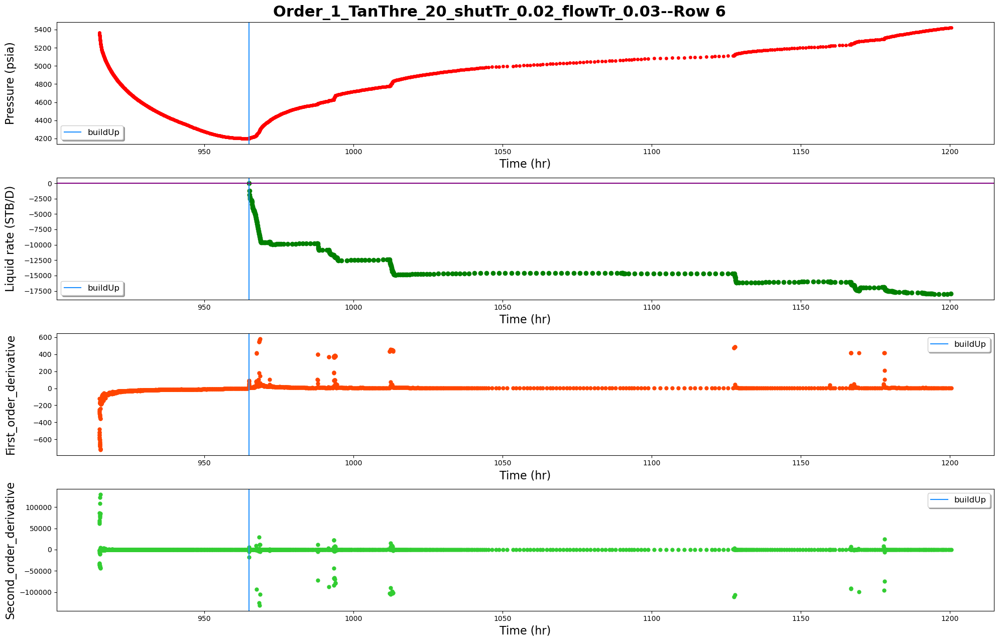

------row 7-----detected points:[7284, 7551, 8003, 8368]


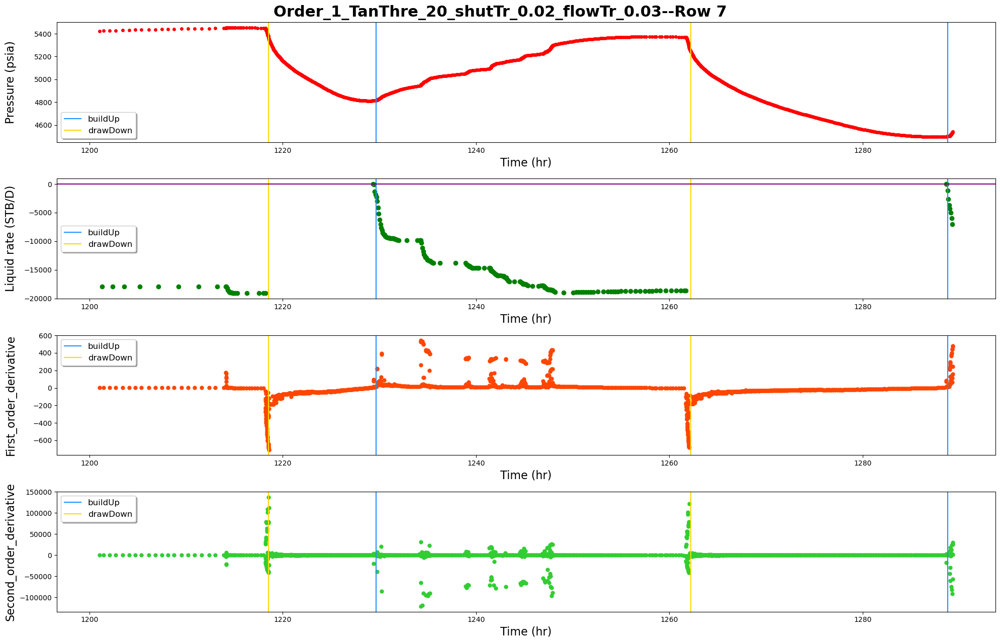

------row 8-----detected points:[9024]


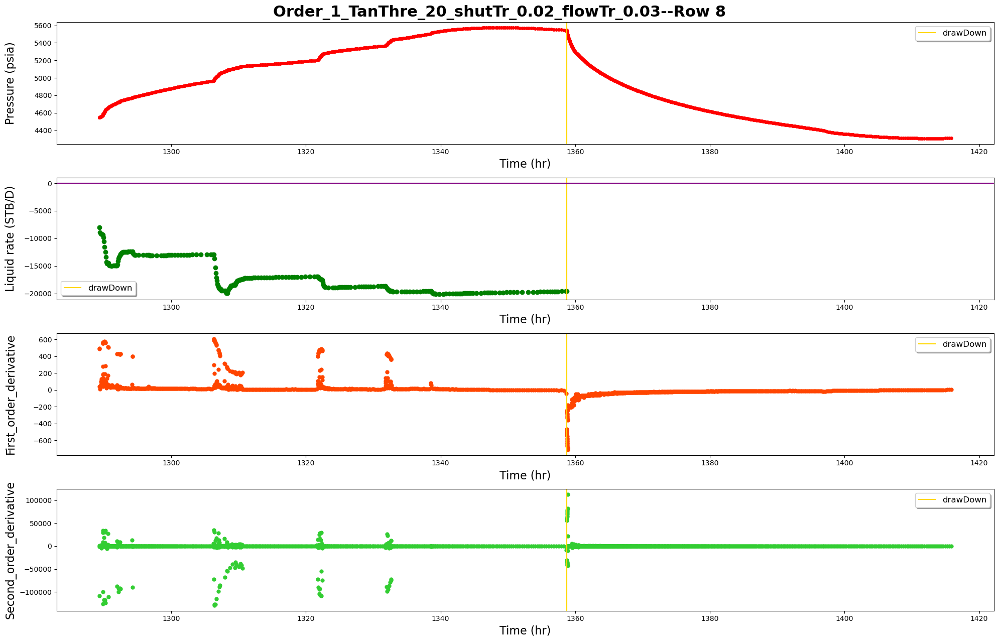

------row 9-----detected points:[9606, 10149, 10224, 10527]


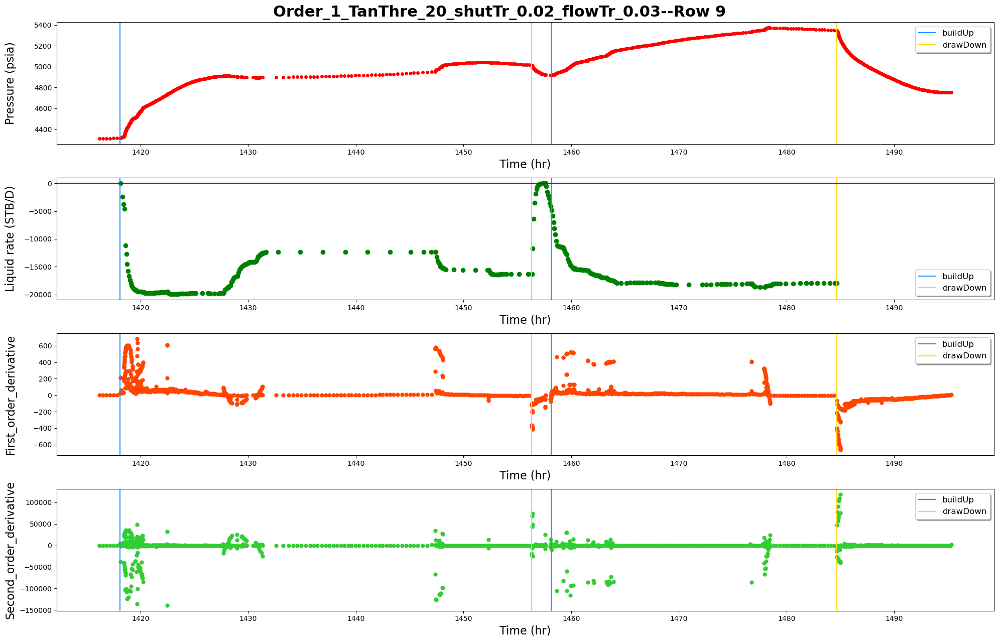

------row 10-----detected points:[10800, 11340, 11480]


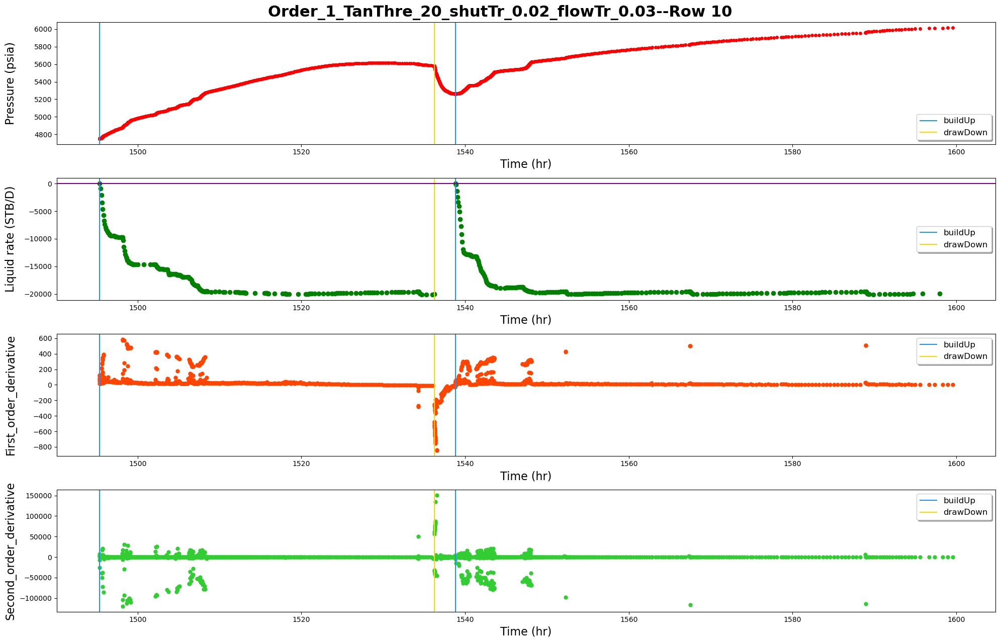

------row 11-----detected points:[12362, 13038]


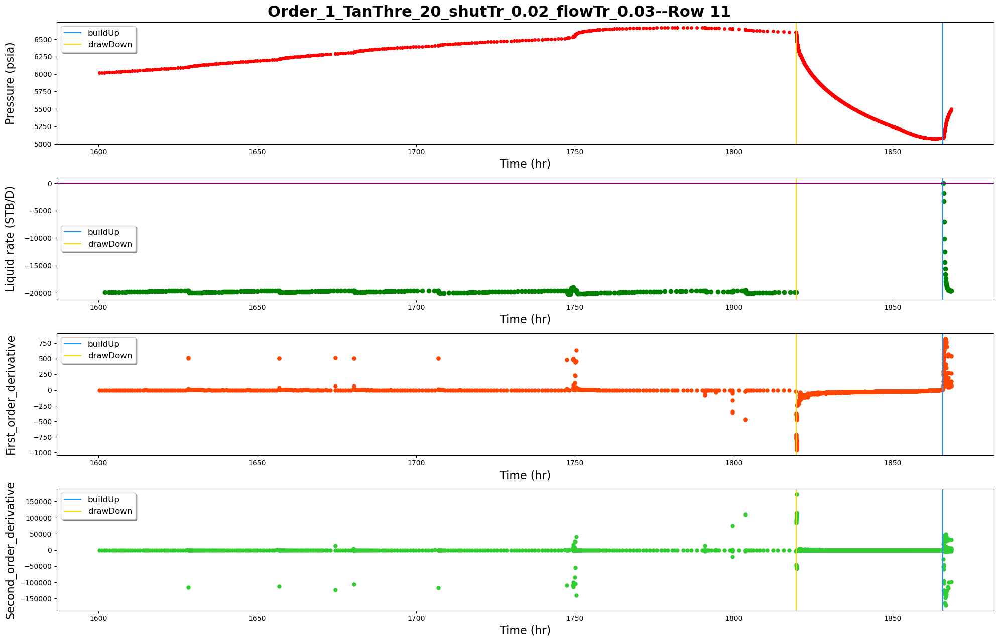

------row 12-----detected points:[13909, 14089]


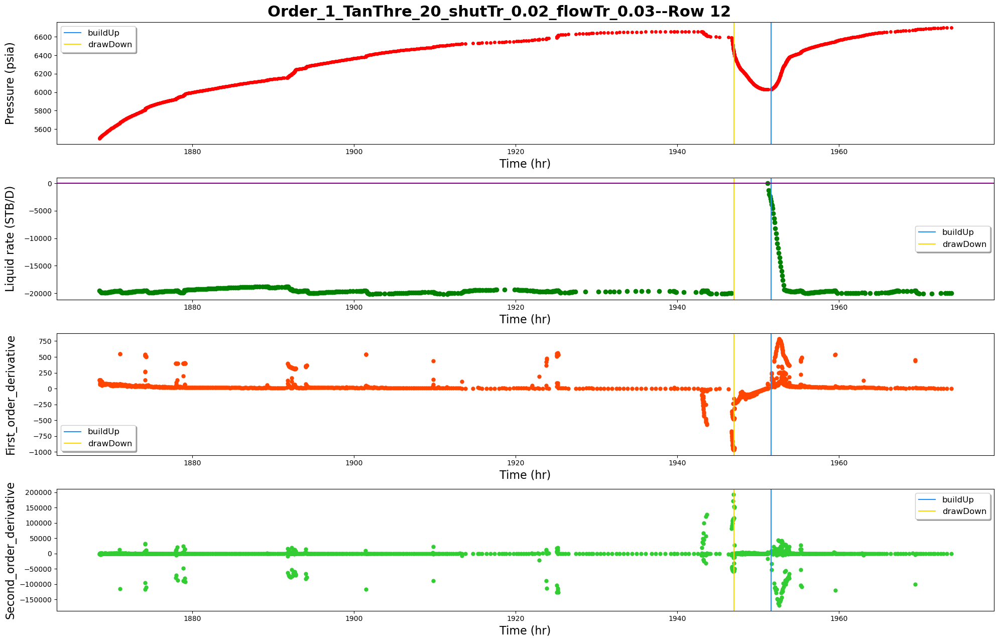

------row 13-----detected points:[14471, 14575, 14774, 15345]


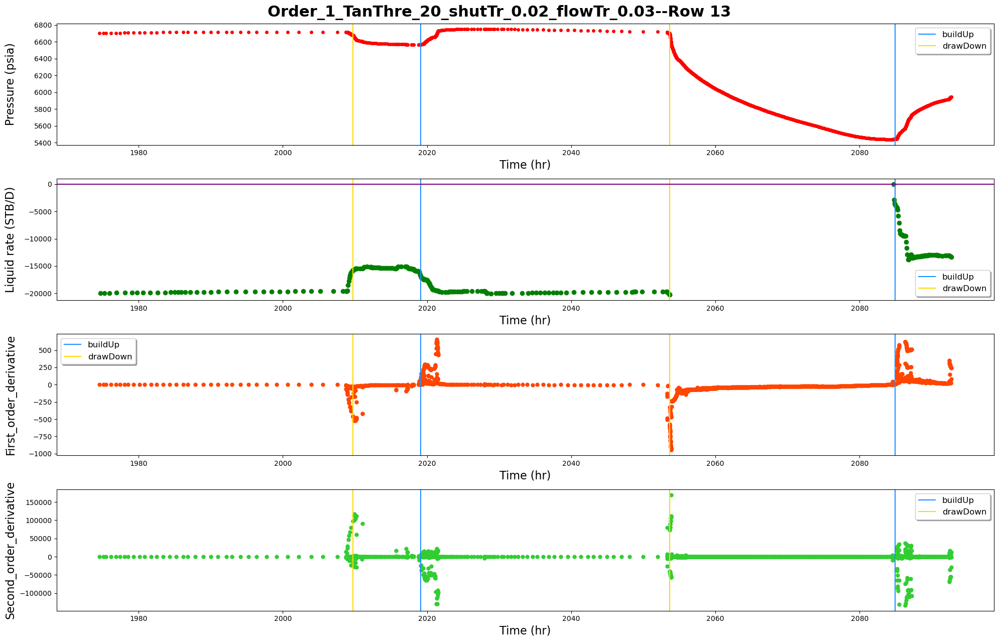

------row 14-----detected points:[16096, 16583]


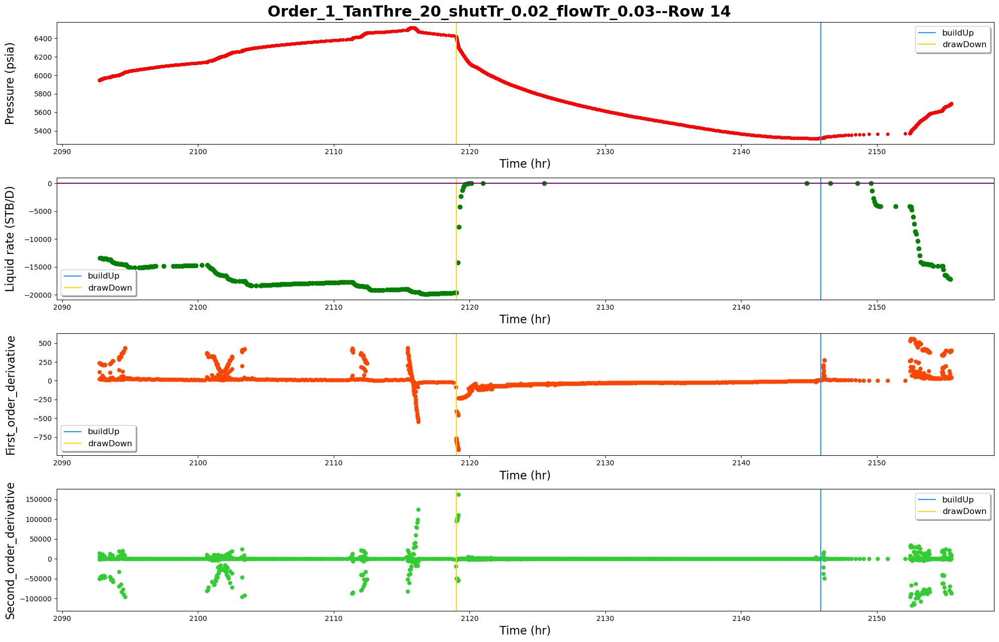

------row 15-----detected points:[17589]


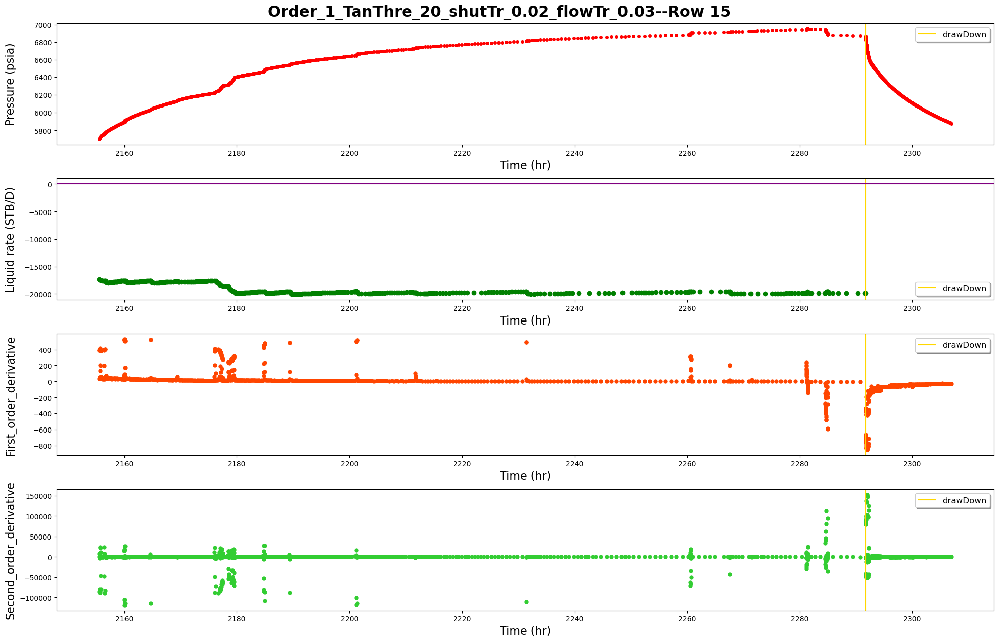

------row 16-----detected points:[18433]


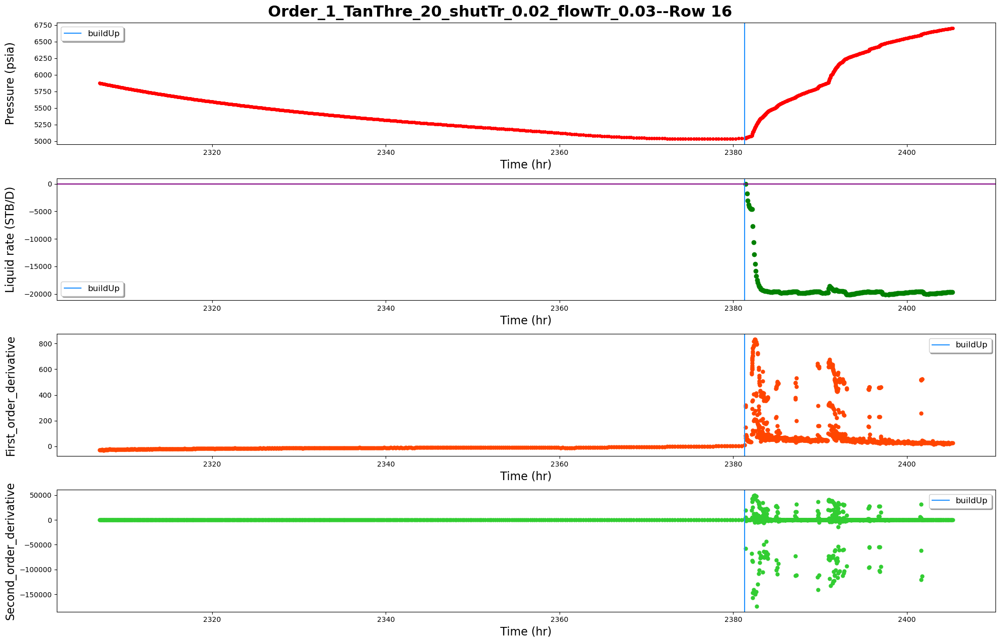

------row 17-----detected points:[19642, 19761, 20013, 20344]


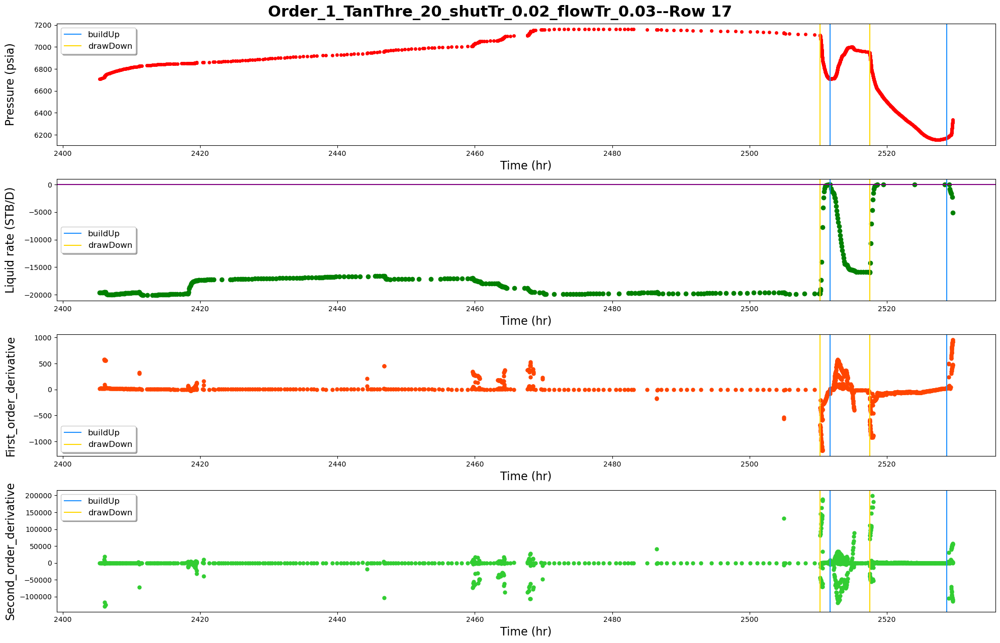

------row 18-----detected points:[20700, 21034]


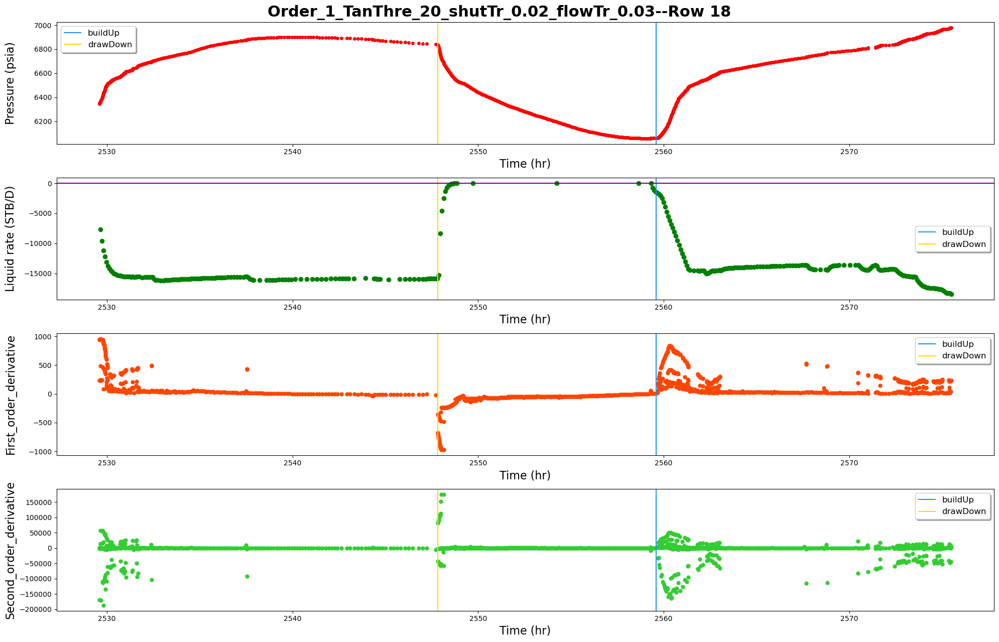

------row 19-----detected points:[21974, 22189, 22709]


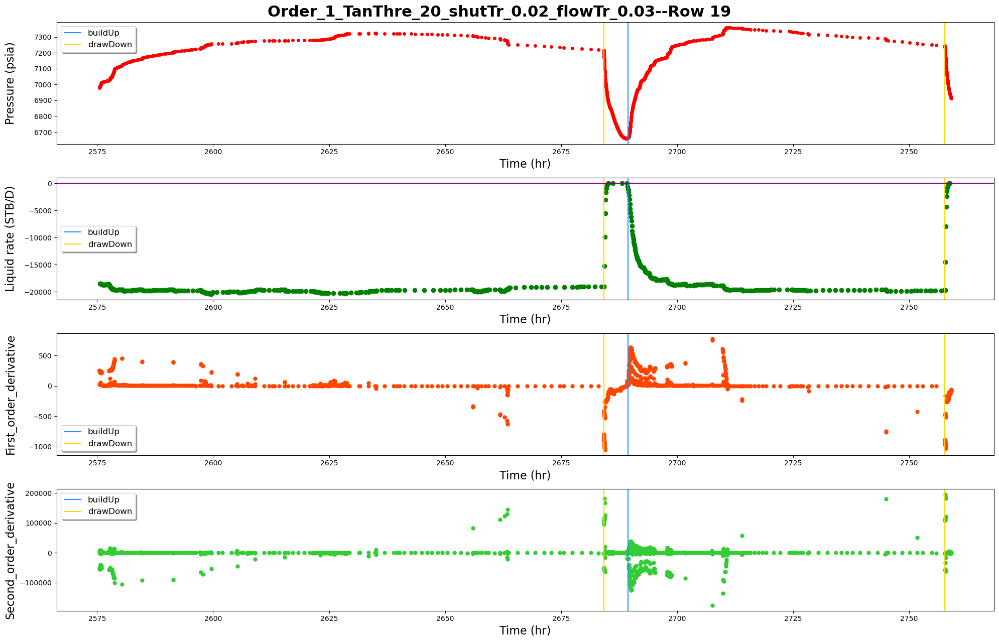

------row 20-----detected points:[23230]


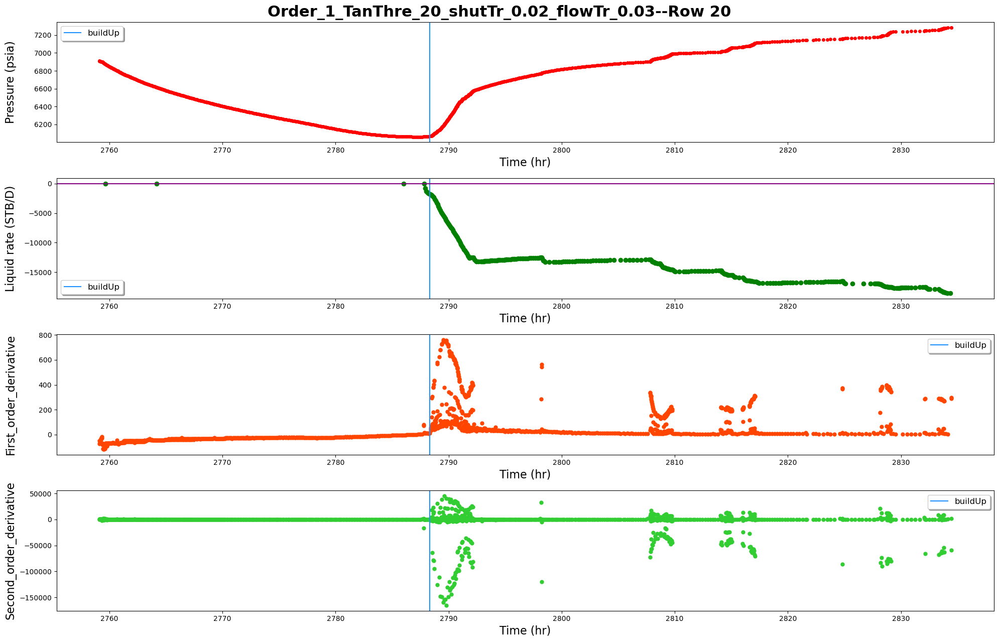

------row 21-----detected points:[24215, 24679]


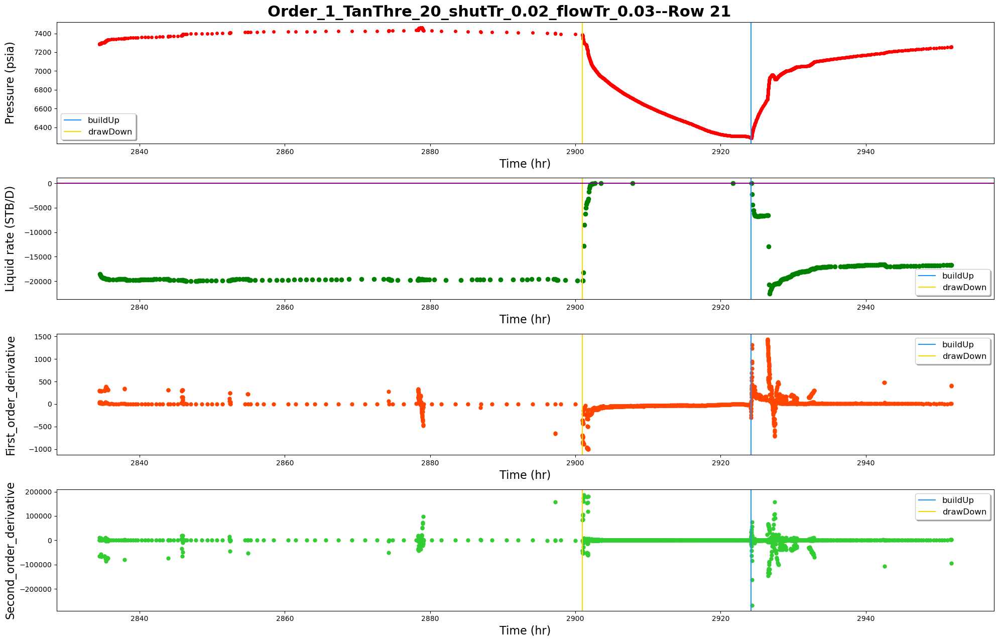

------row 22-----detected points:[25750, 26000]


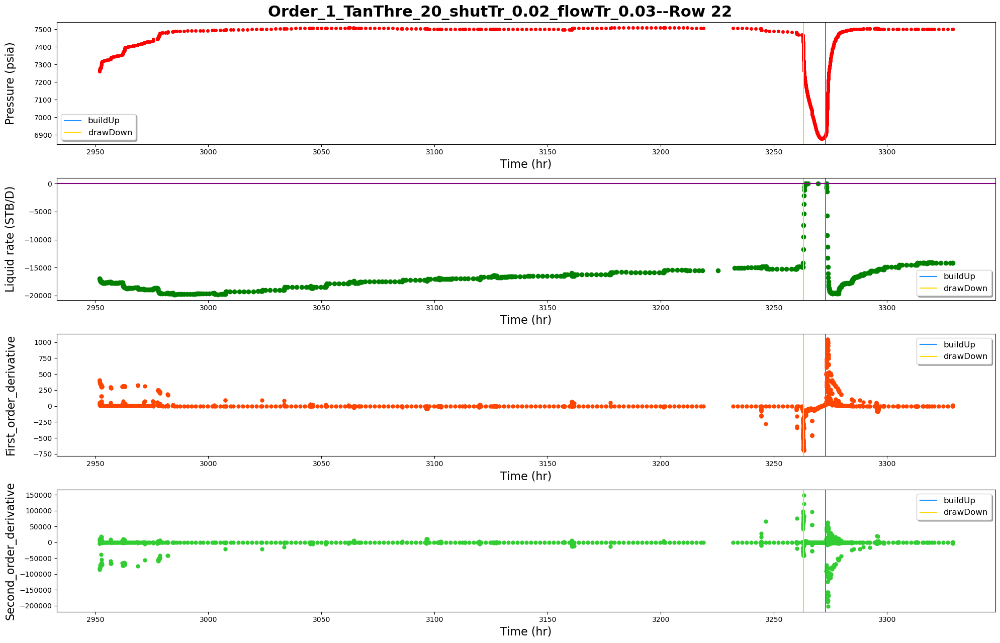

------row 23-----detected points:[26711, 26767, 27025, 27324]


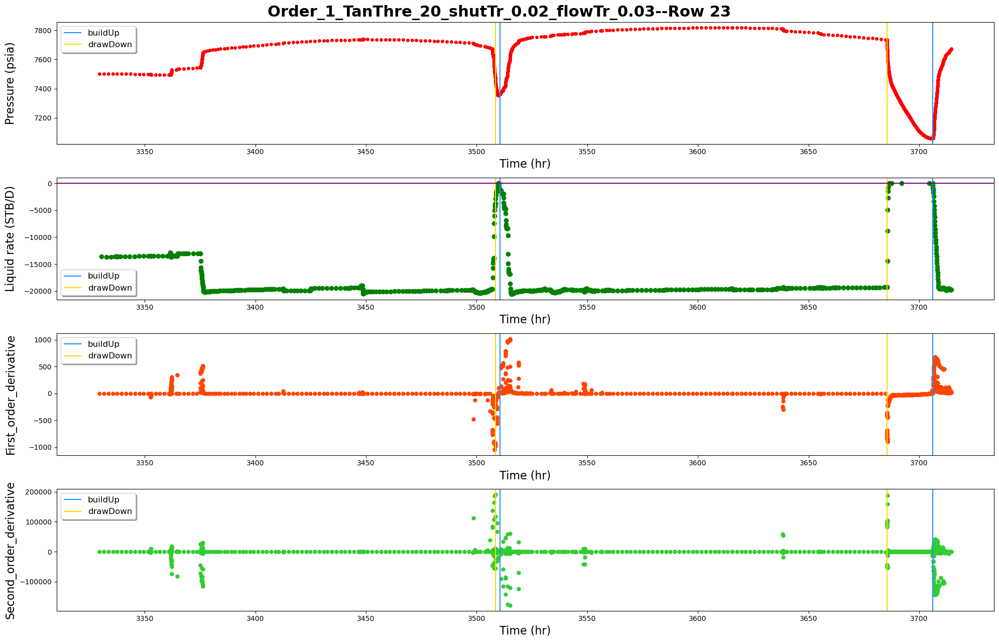

------row 24-----detected points:[27784, 27969, 28290, 28493]


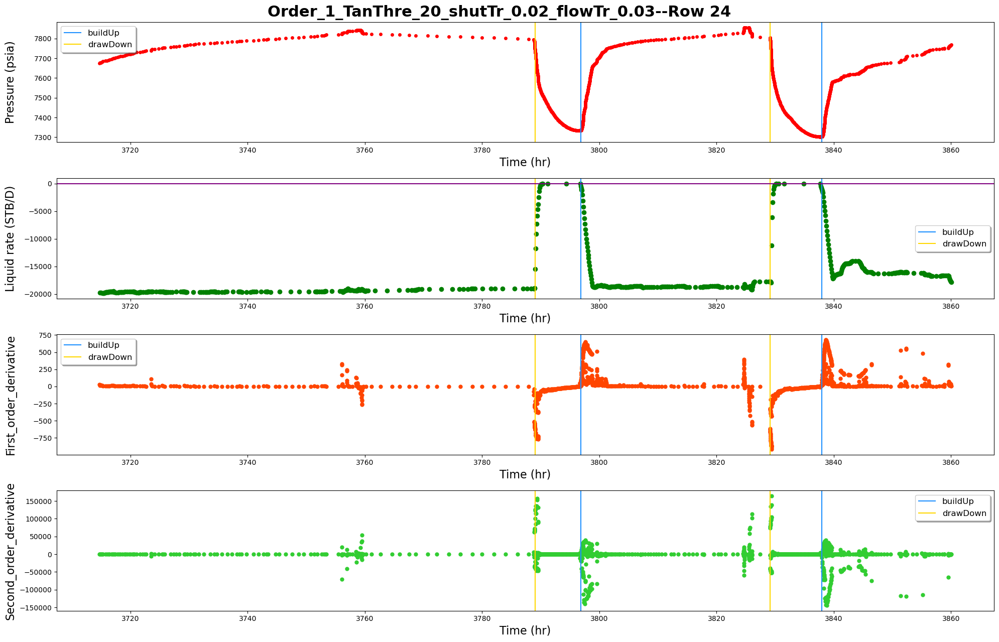

------row 25-----detected points:[28840, 29112]


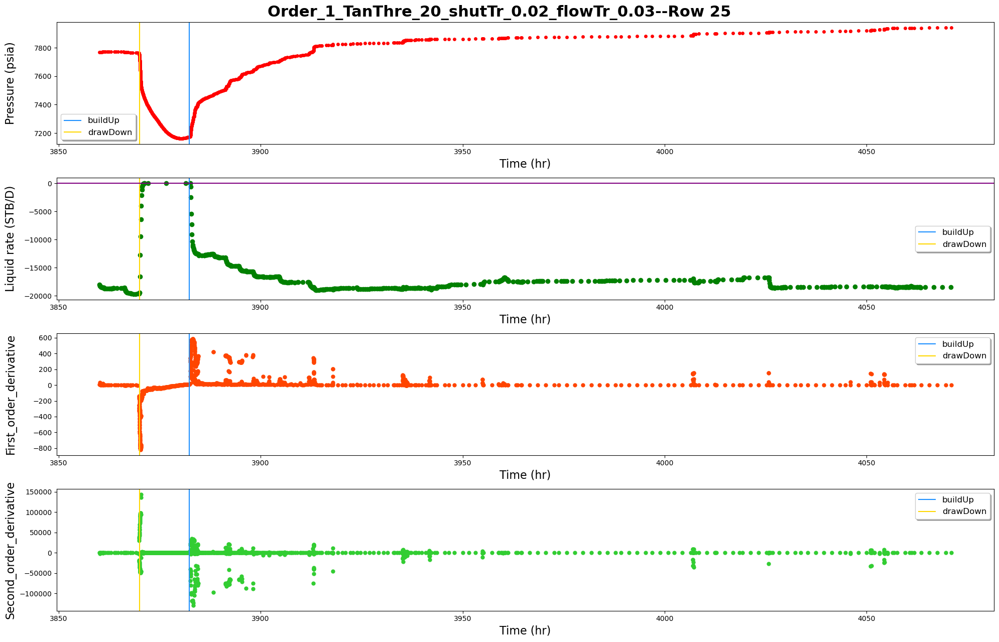

In [14]:

parameters={"Order":polynomial_order,
            "TanThre":deltaTangent_criterion,
            "shutTr":minor_threshold_shutIn,
           "flowTr":minor_threshold_Flowing}
detect_points_dict={"buildUp":transients.major_buildUp,
                   "drawDown":transients.major_drawDown}

buildup=detect_points_dict["buildUp"]
drawdown=detect_points_dict["drawDown"]
txt=f"buildup:{len(buildup)}, drawdown:{len(drawdown)}"
pprint(txt)
plot_whole=True
plot_details=True
plot_statistics=False
save=True
folder_name=f"good/first_FOD/{mode}_major_transients/point_halfWindow_{point_halfWindow}/timeStep_{time_step}"
# folder_name="removed_transients"
%run plot_N_save.ipynb

---initializing...
---plotting...


findfont: Font family ['Arial Black'] not found. Falling back to DejaVu Sans.


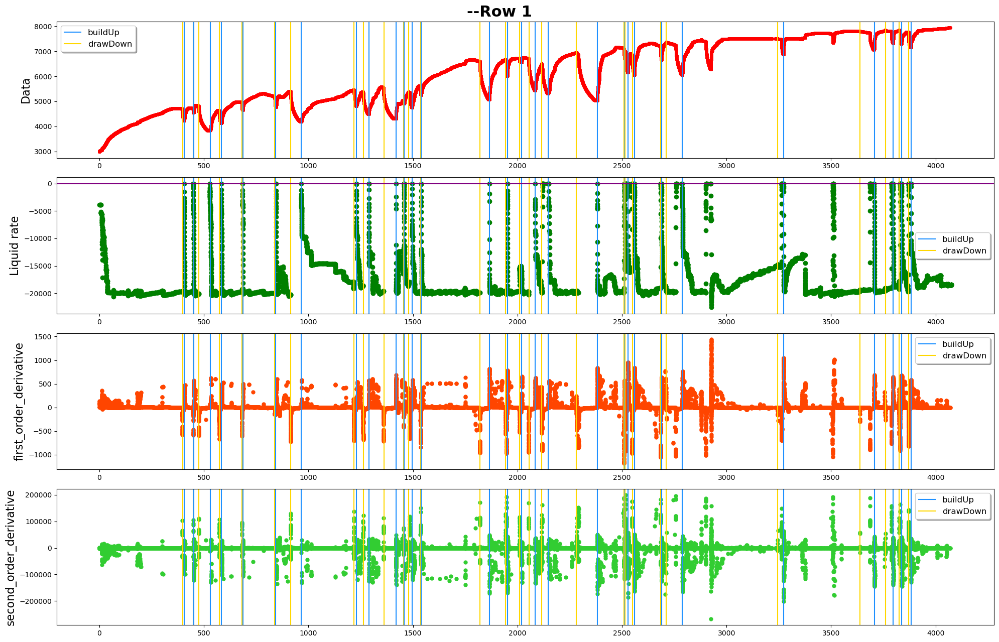

save whole....
detected 58 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]


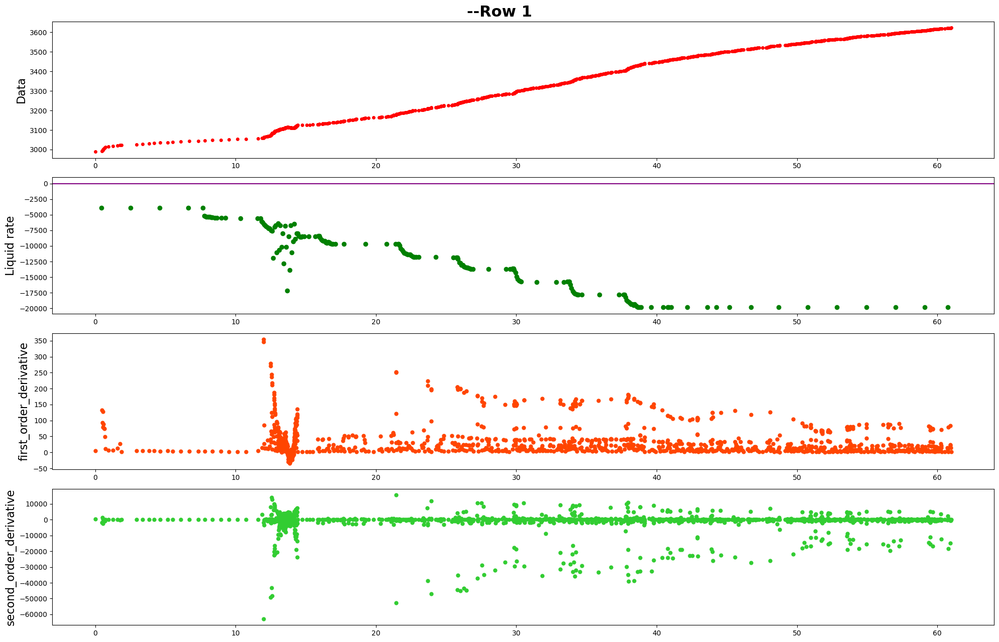

------row 2-----detected points:[2349]


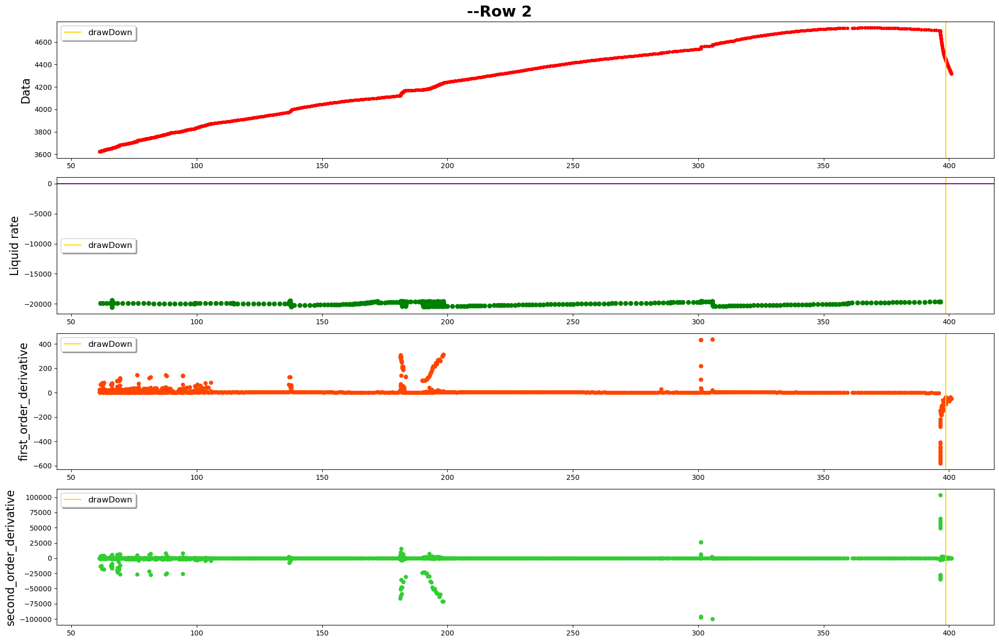

------row 3-----detected points:[2477, 2812, 2900, 3094, 3599]


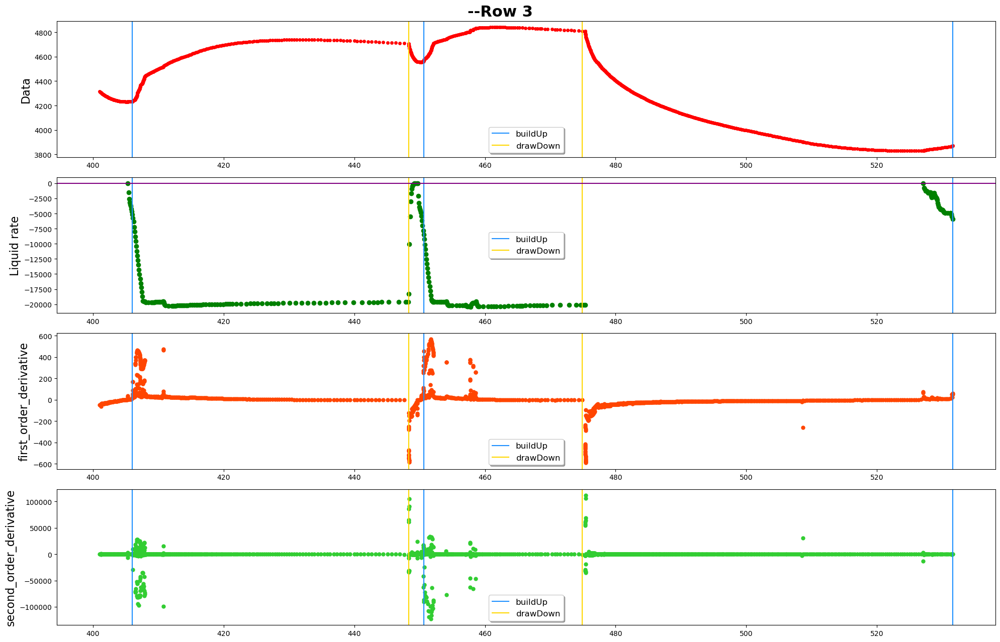

------row 4-----detected points:[4017, 4229, 4763]


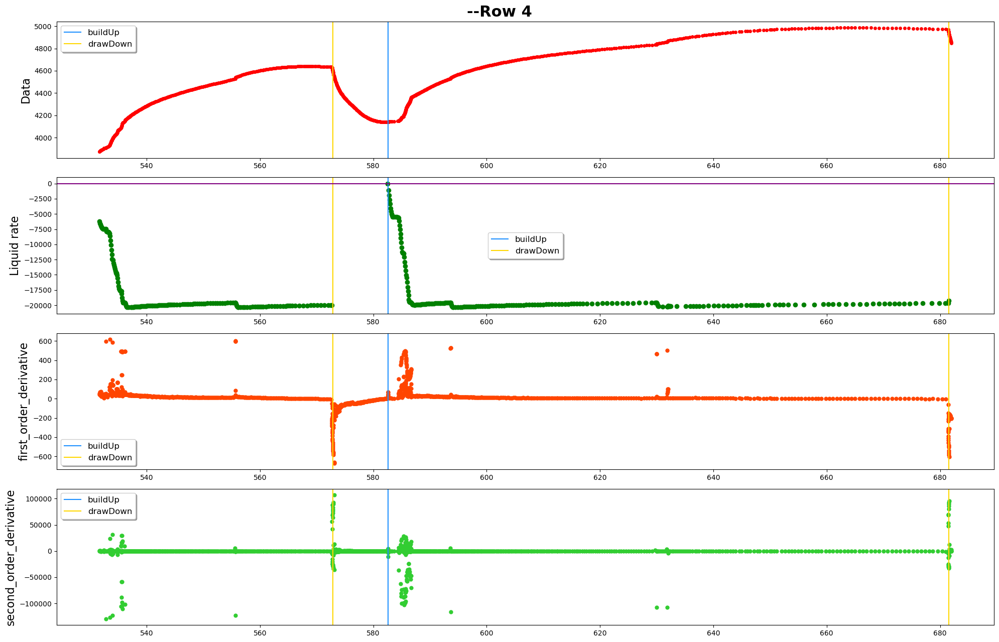

------row 5-----detected points:[4899, 5303, 5387]


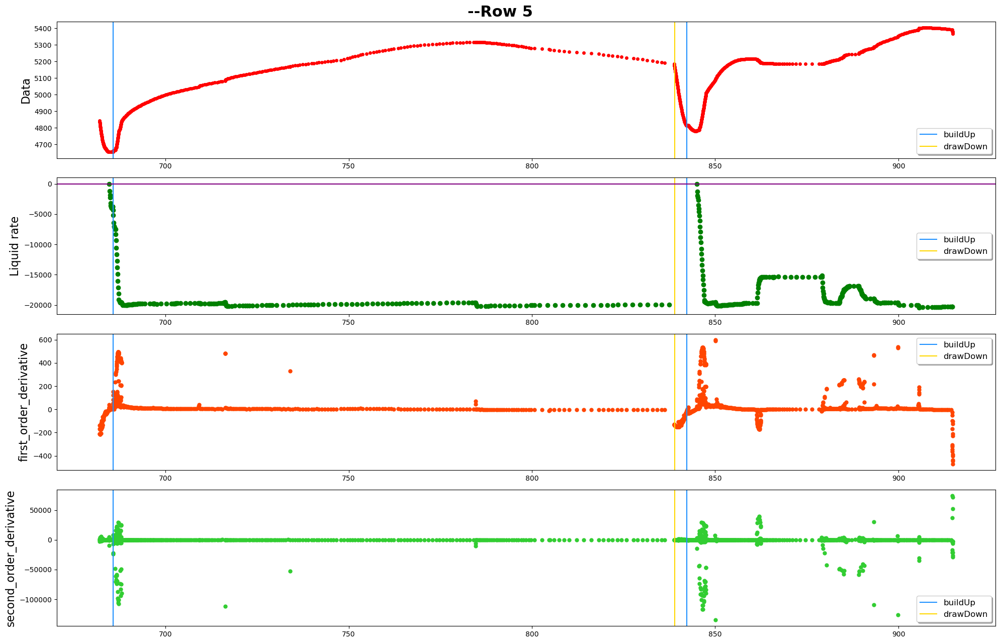

------row 6-----detected points:[6020, 6544]


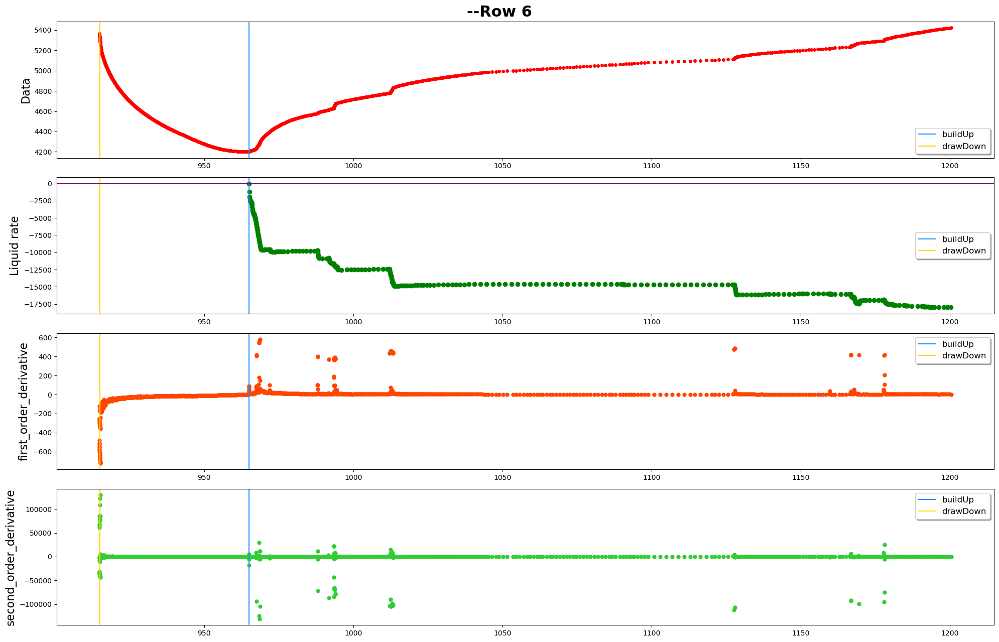

------row 7-----detected points:[7291, 7556, 7984, 8372]


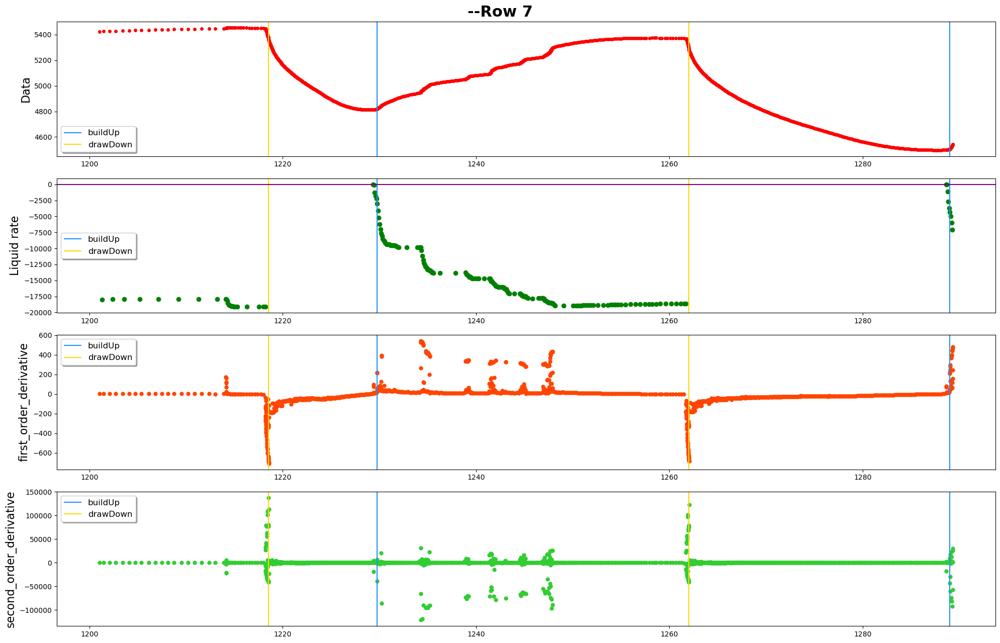

------row 8-----detected points:[9125]


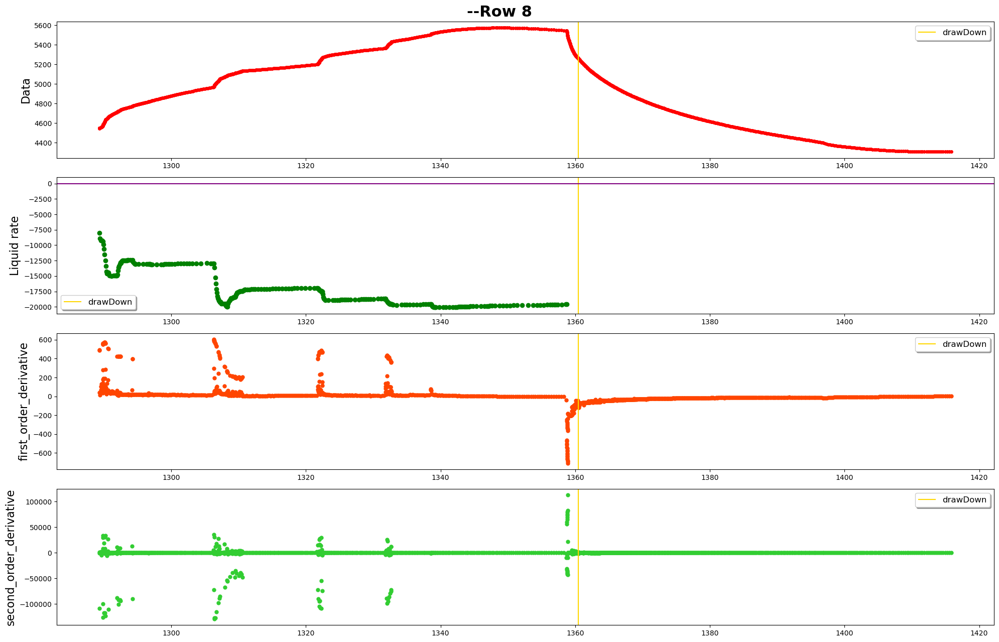

------row 9-----detected points:[9667, 10157, 10238, 10490]


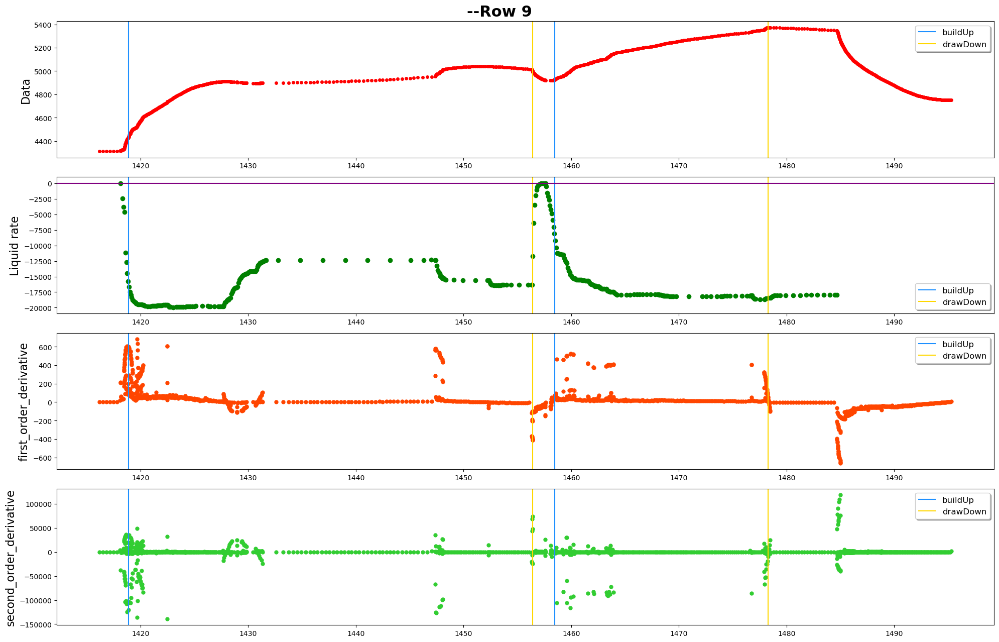

------row 10-----detected points:[10818, 11338, 11480]


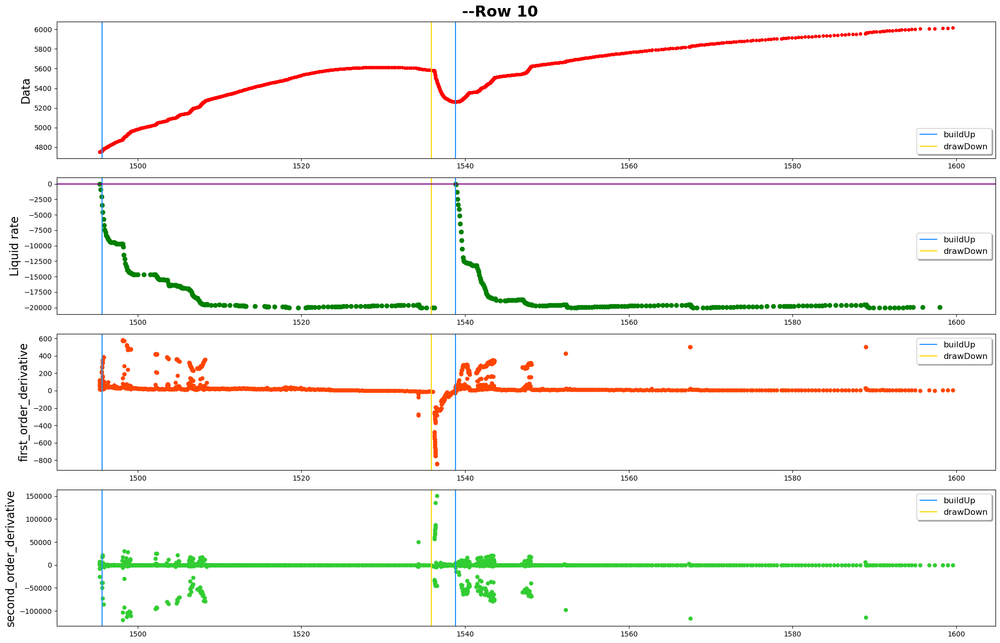

------row 11-----detected points:[12463, 13043]


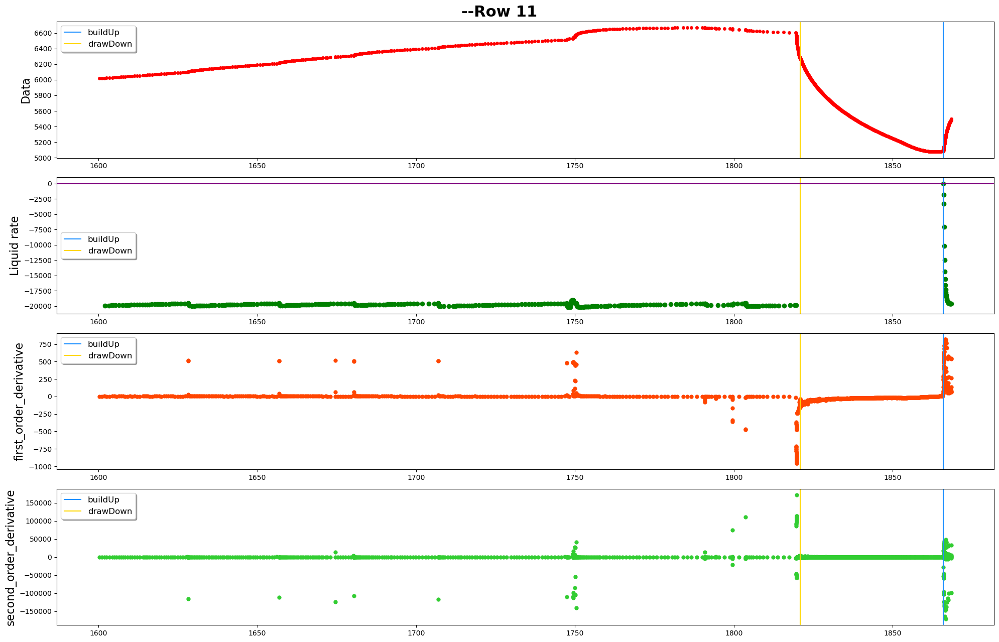

------row 12-----detected points:[13827, 14094]


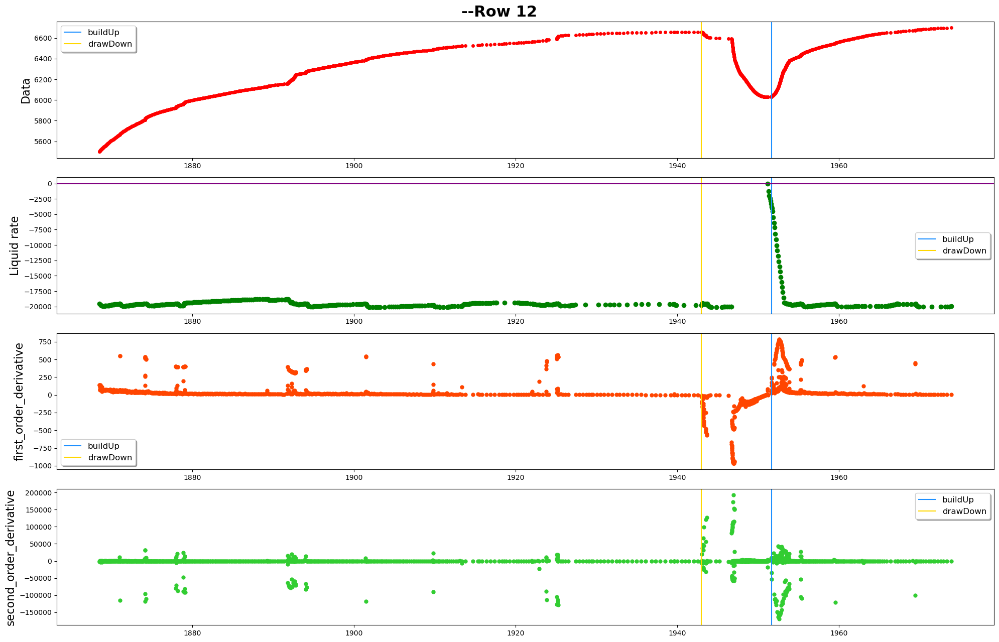

------row 13-----detected points:[14444, 14601, 14876, 15345]


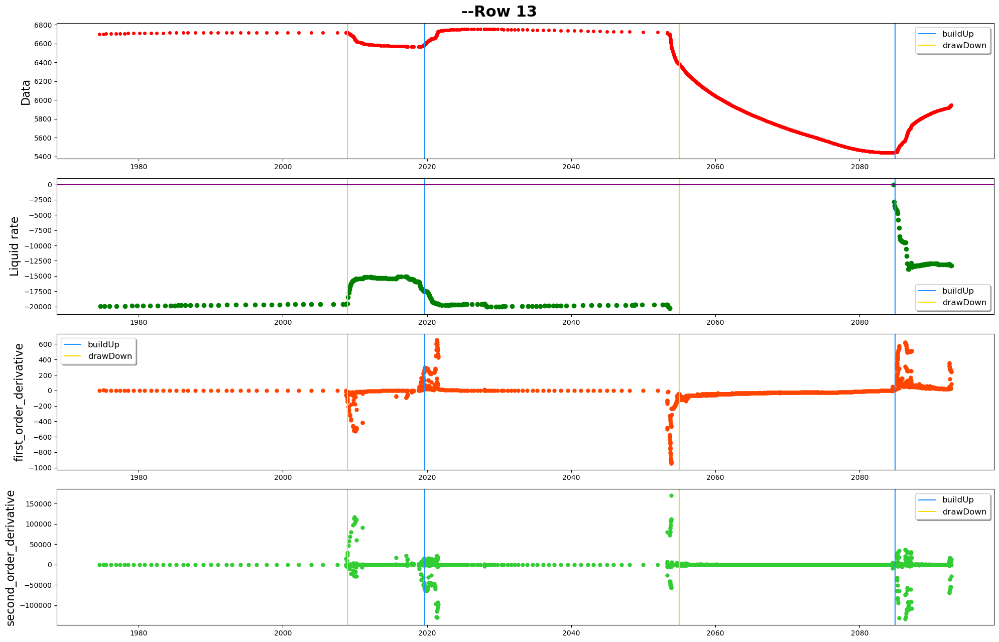

------row 14-----detected points:[16055, 16583]


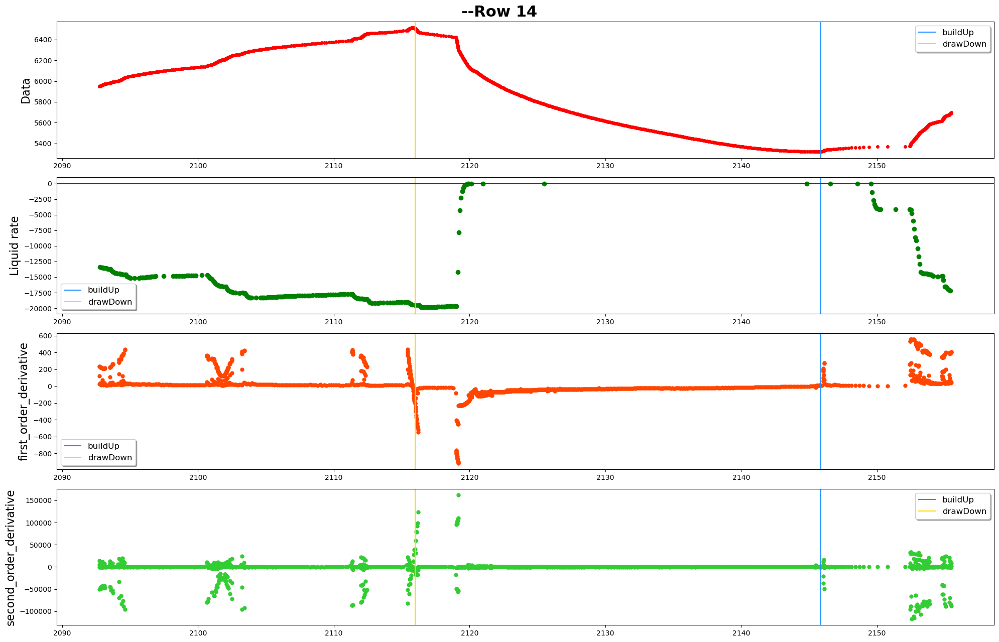

------row 15-----detected points:[17537]


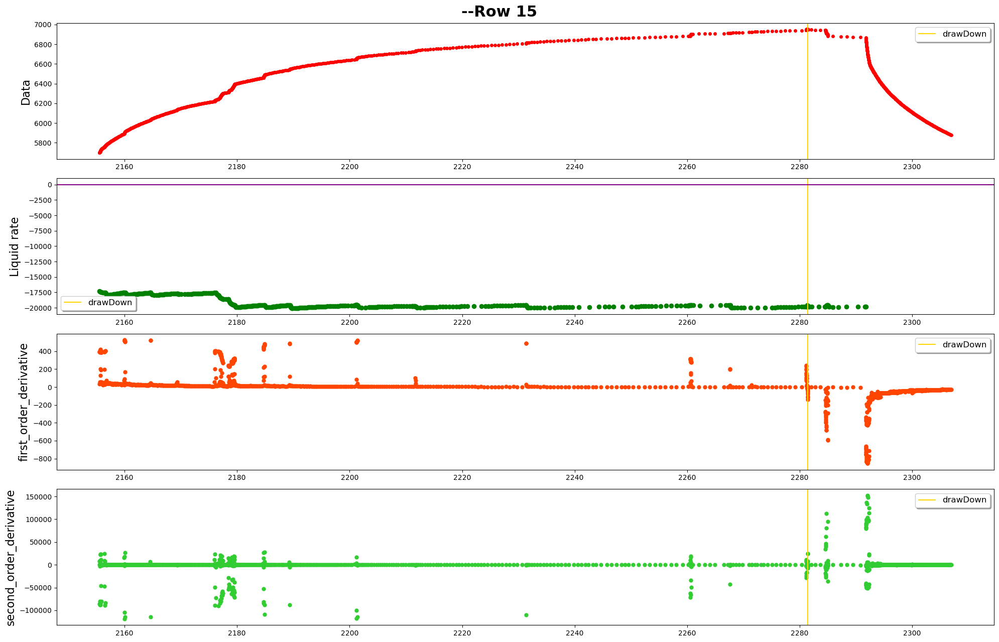

------row 16-----detected points:[18437]


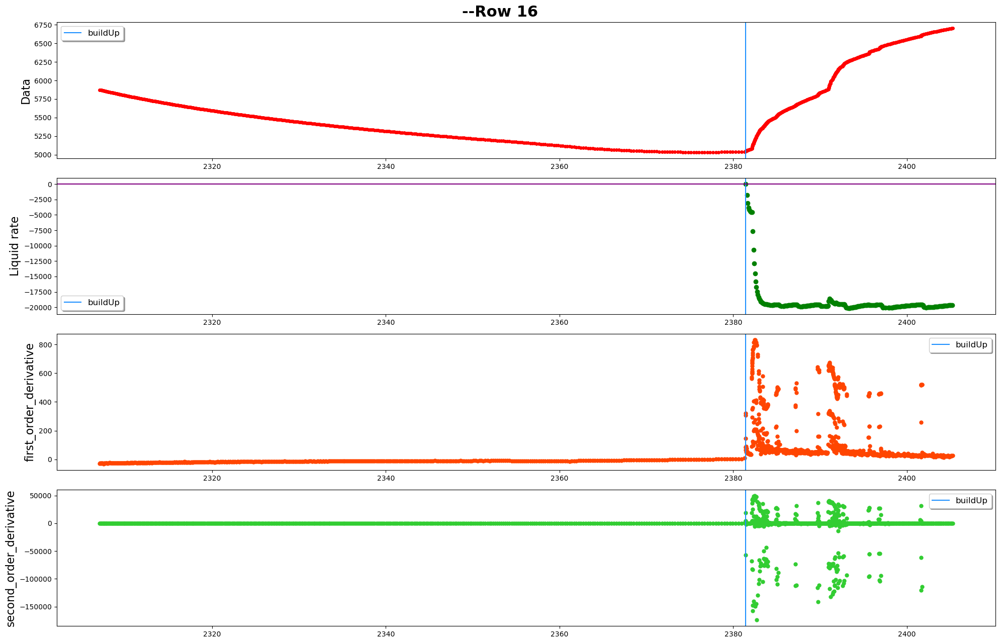

------row 17-----detected points:[19685, 19758, 19979, 20348]


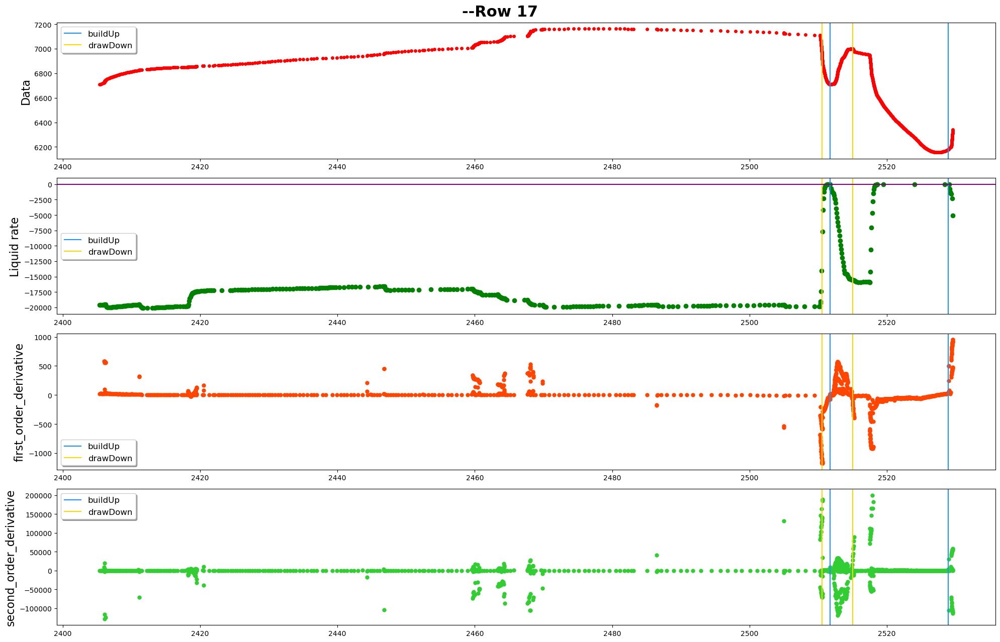

------row 18-----detected points:[20807, 21065]


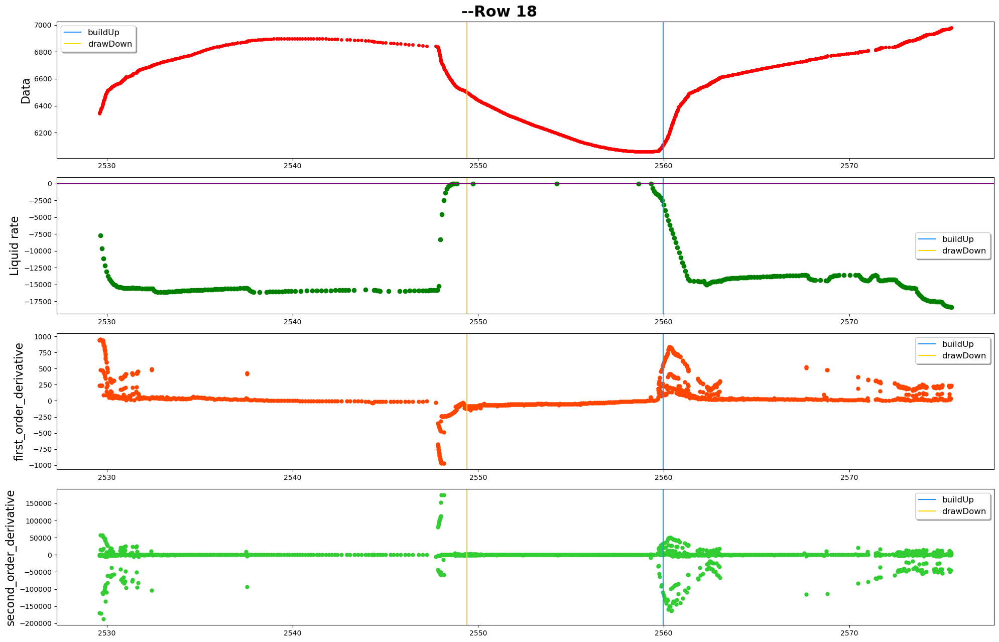

------row 19-----detected points:[22083, 22243, 22650]


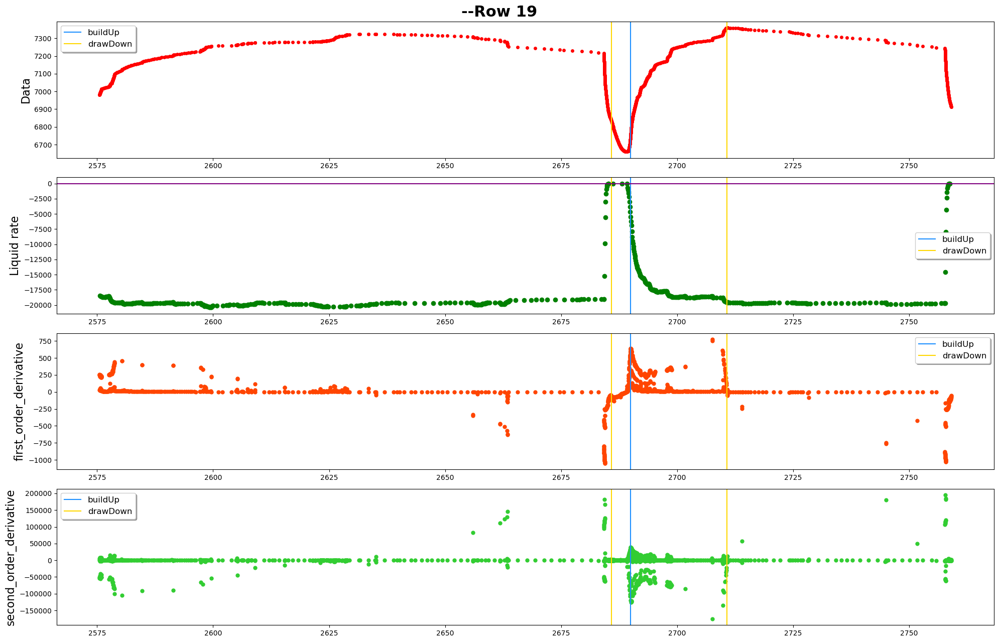

------row 20-----detected points:[23245]


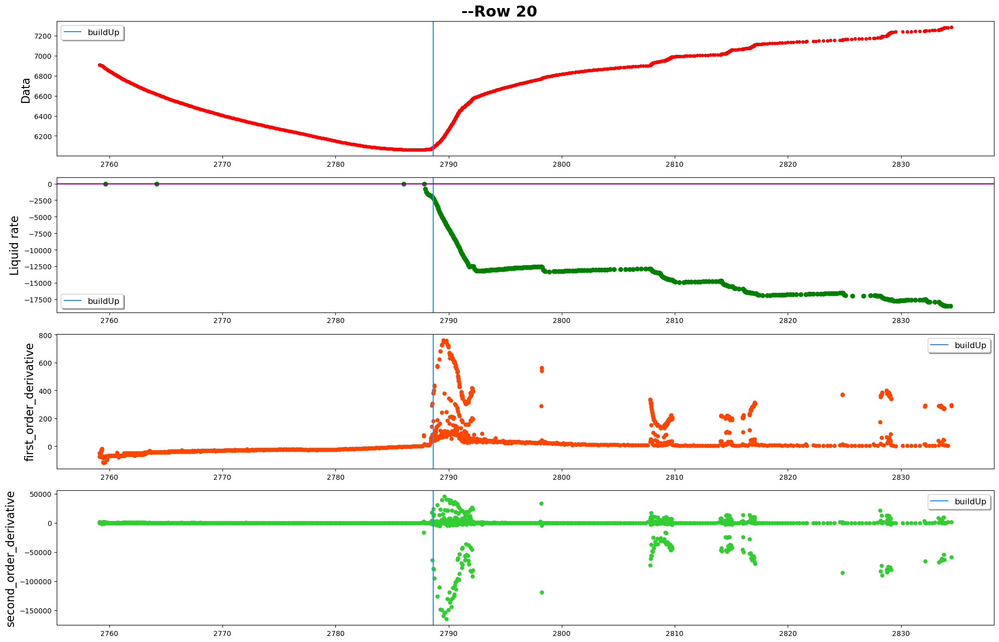

------row 21-----detected points:[]


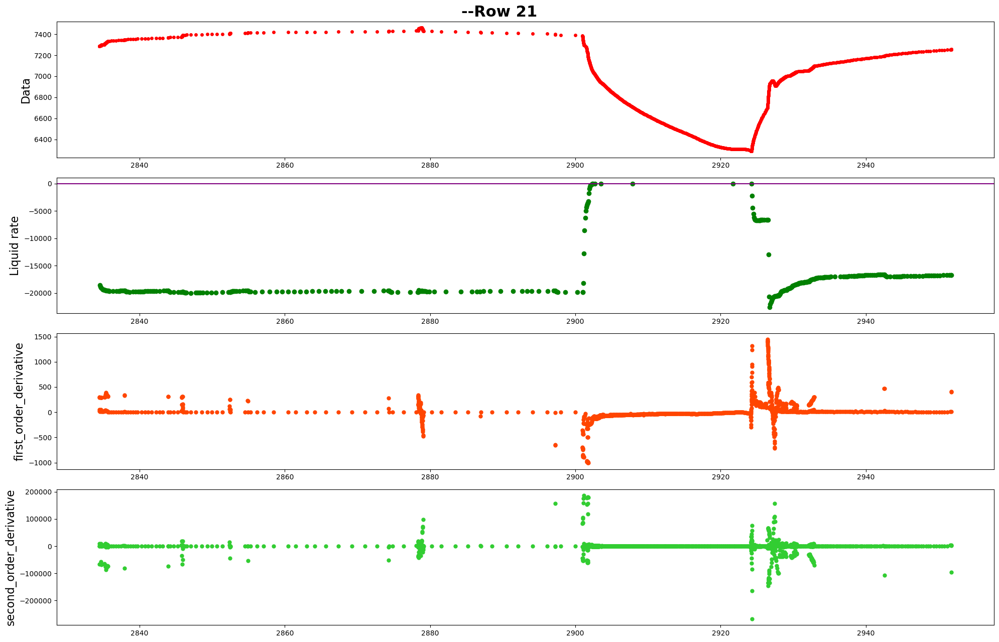

------row 22-----detected points:[25679, 26003]


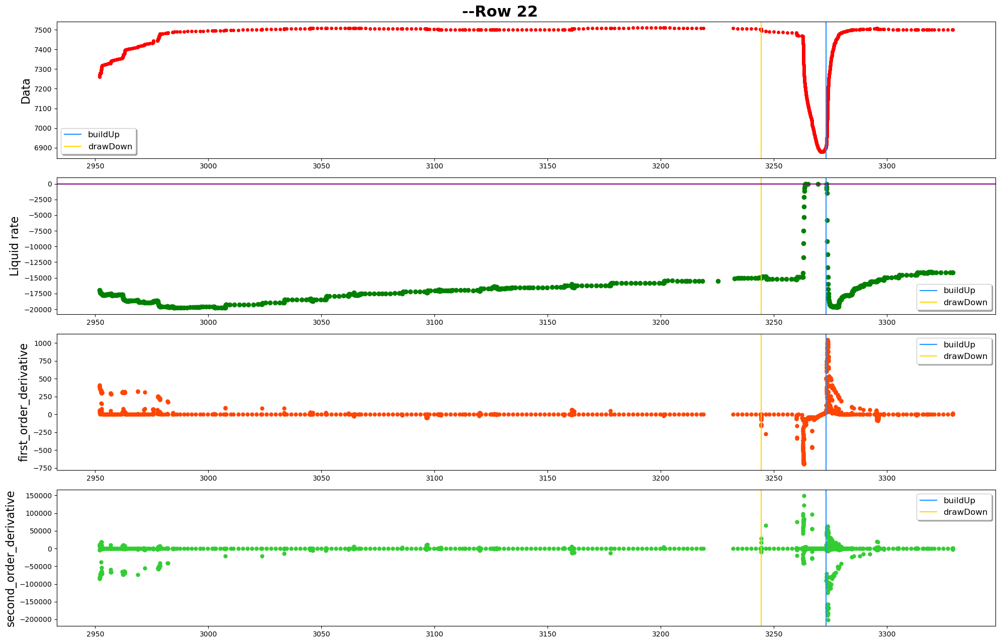

------row 23-----detected points:[26983, 27383]


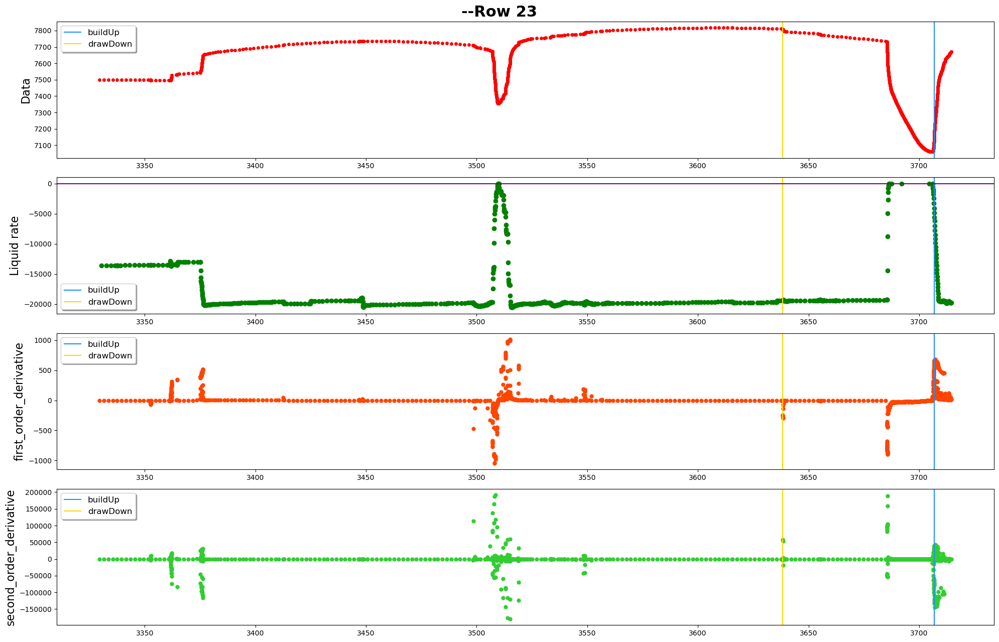

------row 24-----detected points:[27729, 27980, 28248, 28497]


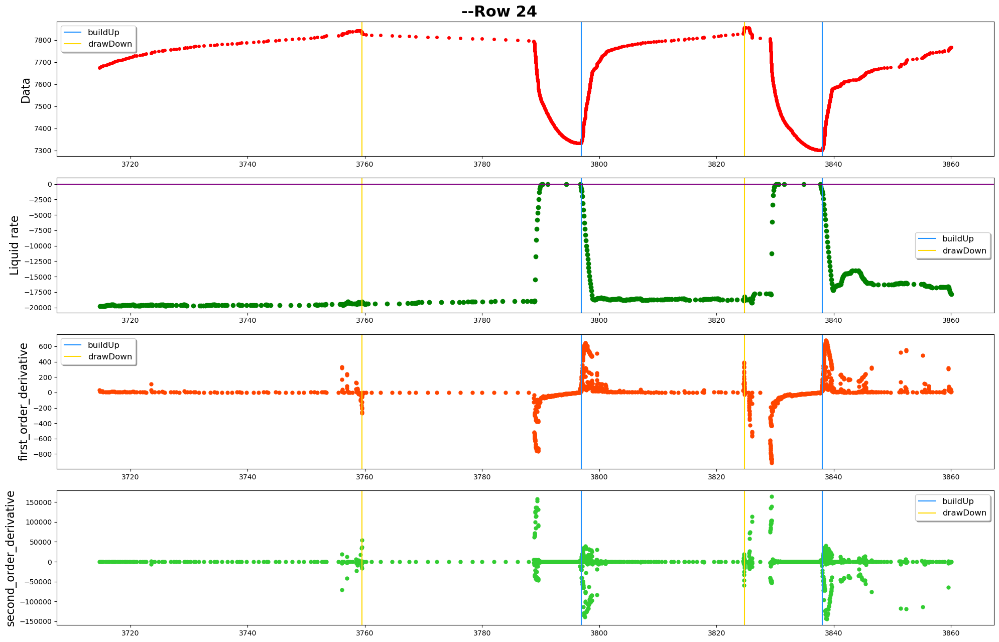

------row 25-----detected points:[28838, 29146]


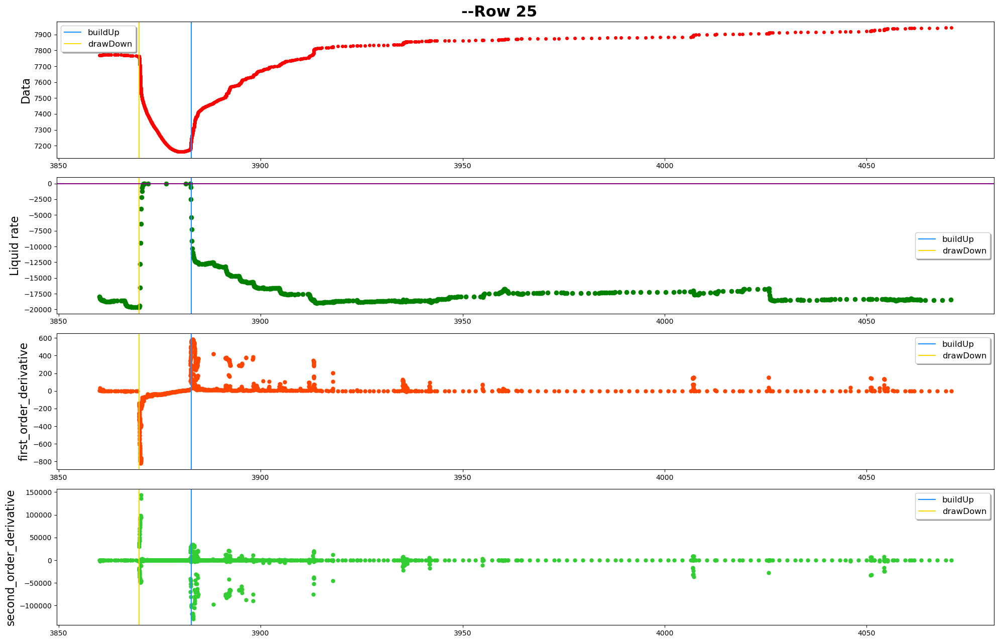

In [11]:
txt=""
point_halfWindow=10
parameters={"Order":polynomial_order,
            "deltaTan":deltaTangent_criterion,     
           "minorThre":minor_threshold}
# parameters={}
# buildups=transients.major_buildUp
# drawdowns=transients.major_drawDown
detect_points_dict={"buildUp":buildups,"drawDown":drawdowns}
# txt=f"buildup:{len(buildups)}, drawdown:{len(drawdowns)}"
# pprint(txt)
plot_whole=True
plot_details=True
plot_statistics=False
folder_name=f"deltaTangent_N_MFOD/filtered_transients/std_point_halfWindow_{point_halfWindow}"
# folder_name="removed_transients"
%run plot_N_save.ipynb